In [2]:
%matplotlib inline
# Importing standard Qiskit libraries
from qiskit import QuantumCircuit, QuantumRegister, ClassicalRegister
from qiskit import execute, Aer, IBMQ
from qiskit.compiler import transpile, assemble
from qiskit.tools.jupyter import *
from qiskit.visualization import *
from ibm_quantum_widgets import *

# Loading your IBM Q account(s)
provider = IBMQ.load_account()

/opt/conda/lib/python3.8/site-packages/qiskit/providers/ibmq/ibmqfactory.py:192: UserWarning: Timestamps in IBMQ backend properties, jobs, and job results are all now in local time instead of UTC.
  warnings.warn('Timestamps in IBMQ backend properties, jobs, and job results '


In [23]:
import csv
import numpy as np
import math
from scipy.optimize import minimize
import matplotlib.pyplot as plt
import random
from datetime import datetime as dt

In [4]:
with open('COVID-19_Vaccinations_by_ZIP_Code.csv', newline='') as csvfile:
    spamreader = csv.reader(csvfile, delimiter=' ', quotechar='|')
    for row in spamreader:
        print(', '.join(row))

Zip, Code,Date,Total, Doses, -, Daily,Total, Doses, -, Cumulative,1st, Dose, -, Daily,1st, Dose, -, Cumulative,1st, Dose, -, Percent, Population,Vaccine, Series, Completed, -, Daily,Vaccine, Series, Completed, -, Cumulative,Vaccine, Series, Completed, , -, Percent, Population,Population,ZIP, Code, Location,Row_ID
60601,02/21/2021,12,3275,1,2137,0.142,11,1138,0.075,15083,POINT, (-87.622844, 41.886262),60601-20210221
60601,02/22/2021,39,3314,15,2152,0.143,24,1162,0.077,15083,POINT, (-87.622844, 41.886262),60601-20210222
60601,02/23/2021,93,3407,64,2216,0.147,29,1191,0.079,15083,POINT, (-87.622844, 41.886262),60601-20210223
60602,02/11/2021,19,426,8,320,0.279,11,106,0.093,1145,POINT, (-87.628309, 41.883136),60602-20210211
60602,02/12/2021,38,464,17,337,0.294,21,127,0.111,1145,POINT, (-87.628309, 41.883136),60602-20210212
60602,02/13/2021,18,482,5,342,0.299,13,140,0.122,1145,POINT, (-87.628309, 41.883136),60602-20210213
60602,02/14/2021,2,484,1,343,0.3,1,141,0.123,1145,POINT, (-87.628309, 

60659,01/24/2021,19,2015,14,1652,0.039,5,363,0.008,42735,POINT, (-87.703266, 41.990803),60659-20210124
60659,01/25/2021,91,2106,58,1710,0.04,33,396,0.009,42735,POINT, (-87.703266, 41.990803),60659-20210125
60659,01/26/2021,115,2221,70,1780,0.042,45,441,0.01,42735,POINT, (-87.703266, 41.990803),60659-20210126
60659,01/27/2021,166,2387,105,1885,0.044,61,502,0.012,42735,POINT, (-87.703266, 41.990803),60659-20210127
60659,01/28/2021,117,2504,100,1985,0.046,17,519,0.012,42735,POINT, (-87.703266, 41.990803),60659-20210128
60659,01/29/2021,117,2621,101,2086,0.049,16,535,0.013,42735,POINT, (-87.703266, 41.990803),60659-20210129
60659,01/30/2021,90,2711,82,2168,0.051,8,543,0.013,42735,POINT, (-87.703266, 41.990803),60659-20210130
60659,01/31/2021,42,2753,25,2193,0.051,17,560,0.013,42735,POINT, (-87.703266, 41.990803),60659-20210131
60659,02/01/2021,104,2857,71,2264,0.053,33,593,0.014,42735,POINT, (-87.703266, 41.990803),60659-20210201
60659,02/02/2021,129,2986,93,2357,0.055,36,629,0.015,42735,P

60649,01/20/2021,101,1361,83,1206,0.026,18,155,0.003,46633,POINT, (-87.571522, 41.762202),60649-20210120
60707,01/03/2021,4,126,4,126,0.003,0,0,0,43093,POINT, (-87.808283, 41.921777),60707-20210103
60651,01/20/2021,99,918,63,742,0.012,36,176,0.003,63492,POINT, (-87.741017, 41.901964),60651-20210120
60631,01/06/2021,55,776,37,756,0.026,18,20,0.001,29529,POINT, (-87.813371, 41.995019),60631-20210106
60653,12/29/2020,150,342,150,342,0.01,0,0,0,33154,POINT, (-87.611244, 41.819261),60653-20201229
60649,01/22/2021,161,1669,152,1487,0.032,9,182,0.004,46633,POINT, (-87.571522, 41.762202),60649-20210122
60608,12/20/2020,19,244,19,244,0.003,0,0,0,80059,POINT, (-87.670366, 41.849879),60608-20201220
60657,01/18/2021,292,5831,177,4246,0.06,115,1585,0.022,70958,POINT, (-87.658216, 41.939715),60657-20210118
60602,02/08/2021,10,381,7,300,0.262,3,81,0.071,1145,POINT, (-87.628309, 41.883136),60602-20210208
60660,02/02/2021,182,4480,121,3600,0.081,61,880,0.02,44498,POINT, (-87.666362, 41.991062),60660-20

In [10]:
with open ('COVID-19_Cases__Tests__and_Deaths_by_ZIP_Code.csv','r') as csv_file:
    reader1 =csv.reader(csv_file)
    for row in reader1:
        print(row)

['ZIP Code', 'Week Number', 'Week Start', 'Week End', 'Cases - Weekly', 'Cases - Cumulative', 'Case Rate - Weekly', 'Case Rate - Cumulative', 'Tests - Weekly', 'Tests - Cumulative', 'Test Rate - Weekly', 'Test Rate - Cumulative', 'Percent Tested Positive - Weekly', 'Percent Tested Positive - Cumulative', 'Deaths - Weekly', 'Deaths - Cumulative', 'Death Rate - Weekly', 'Death Rate - Cumulative', 'Population', 'Row ID', 'ZIP Code Location']
['60603', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-10', 'POINT (-87.625473 41.880112)']
['60603', '11', '03/08/2020', '03/14/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-11', 'POINT (-87.625473 41.880112)']
['60603', '12', '03/15/2020', '03/21/2020', '', '', '', '', '1', '1', '85', '85.2', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-12', 'POINT (-87.625473 41.880112)']
['60603', '13', '03/22/2020'

['60657', '18', '04/26/2020', '05/02/2020', '33', '233', '47', '332.6', '279', '1405', '398', '2005.7', '0.1', '0.1', '5', '15', '7.1', '21.4', '70052', '60657-2020-18', 'POINT (-87.658216 41.939715)']
['60639', '13', '03/22/2020', '03/28/2020', '54', '68', '60', '75.1', '146', '210', '161', '232', '0.3', '0.2', '0', '1', '0.0', '1.1', '90517', '60639-2020-13', 'POINT (-87.75531 41.920609)']
['60649', '10', '03/01/2020', '03/07/2020', '', '', '', '', '1', '1', '2', '2.2', '0.0', '0.0', '0', '0', '0.0', '0.0', '46024', '60649-2020-10', 'POINT (-87.571522 41.762202)']
['60649', '4', '01/24/2021', '01/30/2021', '53', '2774', '115', '6027.3', '1212', '41209', '2633', '89538.1', '0.1', '0.1', '1', '148', '2.2', '321.6', '46024', '60649-2021-4', 'POINT (-87.571522 41.762202)']
['60649', '5', '01/31/2021', '02/06/2021', '43', '2817', '93', '6120.7', '1165', '42374', '2531', '92069.4', '0.0', '0.1', '1', '149', '2.2', '323.7', '46024', '60649-2021-5', 'POINT (-87.571522 41.762202)']
['60649', 

In [15]:
with open ('COVID-19_Cases__Tests__and_Deaths_by_ZIP_Code.csv','r') as csv_file1, open('COVID-19_Vaccinations_by_ZIP_Code.csv', newline='') as csvfile2:
    reader1 =csv.reader(csv_file1)
    for row in reader1:
        reader2=csv.reader(csv_file2)
        print(row[4])

Traceback (most recent call last):
  File "<ipython-input-15-721c53c35fe7>", line 4, in <module>
    reader2=csv.reader(csv_file2)
NameError: name 'csv_file2' is not defined

Use %tb to get the full traceback.


In [21]:
f1 = open('COVID-19_Cases__Tests__and_Deaths_by_ZIP_Code.csv', 'r')
f2 = open('COVID-19_Vaccinations_by_ZIP_Code.csv', 'r')

c1 = csv.reader(f1)
c2 = csv.reader(f2)

masterlist = list(c2)

for cases_row in c1:
    for vaccinations_row in masterlist:
        if cases_row[0] == vaccinations_row[0] and cases_row[2]>'01/01/2021':
            print(cases_row, vaccinations_row)

['60603', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-10', 'POINT (-87.625473 41.880112)'] ['60603', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201215']
['60603', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-10', 'POINT (-87.625473 41.880112)'] ['60603', '12/16/2020', '0', '0', '0', '0', '0', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201216']
['60603', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-10', 'POINT (-87.625473 41.880112)'] ['60603', '12/17/2020', '8', '8', '8', '8', '0.008', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201217']
['60603', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '

['60603', '23', '05/31/2020', '06/06/2020', '0', '6', '0', '511.1', '19', '90', '1618', '7666.1', '0.1', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-23', 'POINT (-87.625473 41.880112)'] ['60603', '12/21/2020', '5', '28', '5', '28', '0.027', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201221']
['60603', '23', '05/31/2020', '06/06/2020', '0', '6', '0', '511.1', '19', '90', '1618', '7666.1', '0.1', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-23', 'POINT (-87.625473 41.880112)'] ['60603', '12/22/2020', '7', '35', '7', '35', '0.033', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201222']
['60603', '23', '05/31/2020', '06/06/2020', '0', '6', '0', '511.1', '19', '90', '1618', '7666.1', '0.1', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-23', 'POINT (-87.625473 41.880112)'] ['60603', '12/23/2020', '0', '35', '0', '35', '0.033', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201223']
['60603', '23', '05/31/2020', '06/06/

['60603', '31', '07/26/2020', '08/01/2020', '0', '9', '0', '766.6', '24', '253', '2044', '21550.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-31', 'POINT (-87.625473 41.880112)'] ['60603', '12/19/2020', '4', '18', '4', '18', '0.017', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201219']
['60603', '31', '07/26/2020', '08/01/2020', '0', '9', '0', '766.6', '24', '253', '2044', '21550.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-31', 'POINT (-87.625473 41.880112)'] ['60603', '12/20/2020', '5', '23', '5', '23', '0.022', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201220']
['60603', '31', '07/26/2020', '08/01/2020', '0', '9', '0', '766.6', '24', '253', '2044', '21550.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '1174', '60603-2020-31', 'POINT (-87.625473 41.880112)'] ['60603', '12/21/2020', '5', '28', '5', '28', '0.027', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201221']
['60603', '31', '07/26/2020', '

['60601', '6', '02/07/2021', '02/13/2021', '5', '878', '34', '5983', '618', '18839', '4211', '128374.8', '0.0', '0.0', '0', '11', '0.0', '75.0', '14675', '60601-2021-6', 'POINT (-87.622844 41.886262)'] ['60601', '01/21/2021', '98', '1245', '86', '864', '0.057', '12', '381', '0.025', '15083', 'POINT (-87.622844 41.886262)', '60601-20210121']
['60601', '6', '02/07/2021', '02/13/2021', '5', '878', '34', '5983', '618', '18839', '4211', '128374.8', '0.0', '0.0', '0', '11', '0.0', '75.0', '14675', '60601-2021-6', 'POINT (-87.622844 41.886262)'] ['60601', '02/05/2021', '120', '2244', '103', '1648', '0.109', '17', '596', '0.04', '15083', 'POINT (-87.622844 41.886262)', '60601-20210205']
['60601', '6', '02/07/2021', '02/13/2021', '5', '878', '34', '5983', '618', '18839', '4211', '128374.8', '0.0', '0.0', '0', '11', '0.0', '75.0', '14675', '60601-2021-6', 'POINT (-87.622844 41.886262)'] ['60601', '12/29/2020', '27', '367', '27', '367', '0.024', '0', '0', '0', '15083', 'POINT (-87.622844 41.88626

['60607', '4', '01/24/2021', '01/30/2021', '30', '2187', '101', '7390.8', '1458', '41849', '4927', '141424.8', '0.0', '0.0', '0', '8', '0.0', '27.0', '29591', '60607-2021-4', 'POINT (-87.652727 41.876104)'] ['60607', '02/11/2021', '243', '7165', '96', '4708', '0.161', '147', '2457', '0.084', '29293', 'POINT (-87.652727 41.876104)', '60607-20210211']
['60607', '4', '01/24/2021', '01/30/2021', '30', '2187', '101', '7390.8', '1458', '41849', '4927', '141424.8', '0.0', '0.0', '0', '8', '0.0', '27.0', '29591', '60607-2021-4', 'POINT (-87.652727 41.876104)'] ['60607', '12/18/2020', '244', '349', '244', '349', '0.012', '0', '0', '0', '29293', 'POINT (-87.652727 41.876104)', '60607-20201218']
['60607', '4', '01/24/2021', '01/30/2021', '30', '2187', '101', '7390.8', '1458', '41849', '4927', '141424.8', '0.0', '0.0', '0', '8', '0.0', '27.0', '29591', '60607-2021-4', 'POINT (-87.652727 41.876104)'] ['60607', '01/06/2021', '77', '1771', '52', '1724', '0.059', '25', '47', '0.002', '29293', 'POINT (

['60604', '13', '03/22/2020', '03/28/2020', '', '', '', '', '7', '8', '895', '1023', '0.0', '0.0', '0', '0', '0.0', '0.0', '782', '60604-2020-13', 'POINT (-87.629029 41.878153)'] ['60604', '12/27/2020', '0', '7', '0', '7', '0.009', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20201227']
['60604', '13', '03/22/2020', '03/28/2020', '', '', '', '', '7', '8', '895', '1023', '0.0', '0.0', '0', '0', '0.0', '0.0', '782', '60604-2020-13', 'POINT (-87.629029 41.878153)'] ['60604', '12/28/2020', '1', '8', '1', '8', '0.01', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20201228']
['60604', '13', '03/22/2020', '03/28/2020', '', '', '', '', '7', '8', '895', '1023', '0.0', '0.0', '0', '0', '0.0', '0.0', '782', '60604-2020-13', 'POINT (-87.629029 41.878153)'] ['60604', '12/29/2020', '1', '9', '1', '9', '0.011', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20201229']
['60604', '13', '03/22/2020', '03/28/2020', '', '', '', '', '7', '8', '895', '1023', '0.0

['60604', '23', '05/31/2020', '06/06/2020', '1', '22', '128', '2813.3', '13', '125', '1662', '15984.7', '0.1', '0.2', '0', '0', '0.0', '0.0', '782', '60604-2020-23', 'POINT (-87.629029 41.878153)'] ['60604', '02/14/2021', '2', '307', '0', '245', '0.298', '2', '62', '0.075', '823', 'POINT (-87.629029 41.878153)', '60604-20210214']
['60604', '23', '05/31/2020', '06/06/2020', '1', '22', '128', '2813.3', '13', '125', '1662', '15984.7', '0.1', '0.2', '0', '0', '0.0', '0.0', '782', '60604-2020-23', 'POINT (-87.629029 41.878153)'] ['60604', '02/15/2021', '0', '307', '0', '245', '0.298', '0', '62', '0.075', '823', 'POINT (-87.629029 41.878153)', '60604-20210215']
['60604', '23', '05/31/2020', '06/06/2020', '1', '22', '128', '2813.3', '13', '125', '1662', '15984.7', '0.1', '0.2', '0', '0', '0.0', '0.0', '782', '60604-2020-23', 'POINT (-87.629029 41.878153)'] ['60604', '02/16/2021', '5', '312', '4', '249', '0.303', '1', '63', '0.077', '823', 'POINT (-87.629029 41.878153)', '60604-20210216']
['60

['60604', '34', '08/16/2020', '08/22/2020', '4', '28', '512', '3580.6', '32', '371', '4092', '47442.5', '0.1', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-34', 'POINT (-87.629029 41.878153)'] ['60604', '01/02/2021', '0', '11', '0', '11', '0.013', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210102']
['60604', '34', '08/16/2020', '08/22/2020', '4', '28', '512', '3580.6', '32', '371', '4092', '47442.5', '0.1', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-34', 'POINT (-87.629029 41.878153)'] ['60604', '01/03/2021', '0', '11', '0', '11', '0.013', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210103']
['60604', '34', '08/16/2020', '08/22/2020', '4', '28', '512', '3580.6', '32', '371', '4092', '47442.5', '0.1', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-34', 'POINT (-87.629029 41.878153)'] ['60604', '01/04/2021', '1', '12', '1', '12', '0.015', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210104']
['60604', '34', '08/16/20

['60617', '7', '02/14/2021', '02/20/2021', '22', '6950', '27', '8420.8', '1087', '69386', '1317', '84069.6', '0.0', '0.1', '2', '137', '2.4', '166.0', '82534', '60617-2021-7', 'POINT (-87.556897 41.721257)'] ['60617', '01/10/2021', '6', '692', '1', '611', '0.007', '5', '81', '0.001', '83553', 'POINT (-87.556897 41.721257)', '60617-20210110']
['60617', '7', '02/14/2021', '02/20/2021', '22', '6950', '27', '8420.8', '1087', '69386', '1317', '84069.6', '0.0', '0.1', '2', '137', '2.4', '166.0', '82534', '60617-2021-7', 'POINT (-87.556897 41.721257)'] ['60617', '01/06/2021', '56', '526', '50', '515', '0.006', '6', '11', '0', '83553', 'POINT (-87.556897 41.721257)', '60617-20210106']
['60617', '7', '02/14/2021', '02/20/2021', '22', '6950', '27', '8420.8', '1087', '69386', '1317', '84069.6', '0.0', '0.1', '2', '137', '2.4', '166.0', '82534', '60617-2021-7', 'POINT (-87.556897 41.721257)'] ['60617', '12/19/2020', '15', '72', '15', '72', '0.001', '0', '0', '0', '83553', 'POINT (-87.556897 41.721

['60634', '5', '01/31/2021', '02/06/2021', '134', '8916', '176', '11732.4', '1899', '77565', '2499', '102065.9', '0.1', '0.1', '2', '130', '2.6', '171.1', '75995', '60634-2021-5', 'POINT (-87.797373 41.944967)'] ['60634', '02/23/2021', '331', '11832', '184', '8592', '0.114', '147', '3240', '0.043', '75082', 'POINT (-87.797373 41.944967)', '60634-20210223']
['60634', '5', '01/31/2021', '02/06/2021', '134', '8916', '176', '11732.4', '1899', '77565', '2499', '102065.9', '0.1', '0.1', '2', '130', '2.6', '171.1', '75995', '60634-2021-5', 'POINT (-87.797373 41.944967)'] ['60634', '02/24/2021', '239', '12071', '138', '8730', '0.116', '101', '3341', '0.044', '75082', 'POINT (-87.797373 41.944967)', '60634-20210224']
['60634', '5', '01/31/2021', '02/06/2021', '134', '8916', '176', '11732.4', '1899', '77565', '2499', '102065.9', '0.1', '0.1', '2', '130', '2.6', '171.1', '75995', '60634-2021-5', 'POINT (-87.797373 41.944967)'] ['60634', '01/26/2021', '180', '3778', '114', '3038', '0.04', '66', '7

['60638', '7', '02/14/2021', '02/20/2021', '42', '7076', '71', '12034.6', '883', '50395', '1502', '85710.2', '0.0', '0.2', '0', '108', '0.0', '183.7', '58797', '60638-2021-7', 'POINT (-87.771902 41.787032)'] ['60638', '02/03/2021', '281', '3958', '235', '3184', '0.054', '46', '774', '0.013', '58669', 'POINT (-87.771902 41.787032)', '60638-20210203']
['60638', '7', '02/14/2021', '02/20/2021', '42', '7076', '71', '12034.6', '883', '50395', '1502', '85710.2', '0.0', '0.2', '0', '108', '0.0', '183.7', '58797', '60638-2021-7', 'POINT (-87.771902 41.787032)'] ['60638', '02/04/2021', '309', '4267', '278', '3462', '0.059', '31', '805', '0.014', '58669', 'POINT (-87.771902 41.787032)', '60638-20210204']
['60638', '7', '02/14/2021', '02/20/2021', '42', '7076', '71', '12034.6', '883', '50395', '1502', '85710.2', '0.0', '0.2', '0', '108', '0.0', '183.7', '58797', '60638-2021-7', 'POINT (-87.771902 41.787032)'] ['60638', '02/05/2021', '319', '4586', '276', '3738', '0.064', '43', '848', '0.014', '58

['60646', '2', '01/10/2021', '01/16/2021', '75', '2092', '268', '7474.9', '1086', '26500', '3880', '94686.8', '0.1', '0.1', '1', '58', '3.6', '207.2', '27987', '60646-2021-2', 'POINT (-87.761826 41.993931)'] ['60646', '01/14/2021', '43', '1197', '33', '899', '0.031', '10', '298', '0.01', '28569', 'POINT (-87.761826 41.993931)', '60646-20210114']
['60646', '2', '01/10/2021', '01/16/2021', '75', '2092', '268', '7474.9', '1086', '26500', '3880', '94686.8', '0.1', '0.1', '1', '58', '3.6', '207.2', '27987', '60646-2021-2', 'POINT (-87.761826 41.993931)'] ['60646', '01/05/2021', '62', '591', '62', '591', '0.021', '0', '0', '0', '28569', 'POINT (-87.761826 41.993931)', '60646-20210105']
['60646', '2', '01/10/2021', '01/16/2021', '75', '2092', '268', '7474.9', '1086', '26500', '3880', '94686.8', '0.1', '0.1', '1', '58', '3.6', '207.2', '27987', '60646-2021-2', 'POINT (-87.761826 41.993931)'] ['60646', '12/19/2020', '53', '156', '53', '156', '0.005', '0', '0', '0', '28569', 'POINT (-87.761826 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 ['60608', '12/20/2020', '19', '244', '19', '244', '0.003', '0', '0', '0', '80059', 'POINT (-87.670366 41.849879)', '60608-20201220']
['60608', '3', '01/17/2021', '01/23/2021', '164', '7026', '207', '8870.7', '2162', '75021', '2730', '94717.5', '0.1', '0.1', '0', '125', '0.0', '157.8', '79205', '60608-2021-3', 'POINT (-87.670366 41.849879)'] ['60608', '12/21/2020', '98', '342', '98', '342', '0.004', '0', '0', '0', '80059', 'POINT (-87.670366 41.849879)', '60608-20201221']
['60608', '3', '01/17/2021', '01/23/2021', '164', '7026', '207', '8870.7', '2162', '75021', '2730', '94717.5', '0.1', '0.1', '0', '125', '0.0', '157.8', '79205', '60608-2021-3', 'POINT (-87.670366 41.849879)'] ['60608', '01/16/2021', '57', '2463', '52', '1935', '0.024', '5', '528', '0.007', '80059', 'POINT (-87.670366 41.849879)', '60608-20210116']
['60608', '3', '01/17/2021', '01/23/2021', '164', '7026', '207', '8870.7', '2162', '75021', '2730', '94717.5', '0.1', '0.1', '0', '125', '0.0', '157.8', '79205', '60608-202

['60601', '39', '09/20/2020', '09/26/2020', '9', '210', '61', '1431', '390', '6043', '2658', '41178.9', '0.0', '0.0', '1', '6', '6.8', '40.9', '14675', '60601-2020-39', 'POINT (-87.622844 41.886262)'] ['60601', '12/26/2020', '10', '318', '10', '318', '0.021', '0', '0', '0', '15083', 'POINT (-87.622844 41.886262)', '60601-20201226']
['60601', '39', '09/20/2020', '09/26/2020', '9', '210', '61', '1431', '390', '6043', '2658', '41178.9', '0.0', '0.0', '1', '6', '6.8', '40.9', '14675', '60601-2020-39', 'POINT (-87.622844 41.886262)'] ['60601', '01/27/2021', '65', '1594', '51', '1135', '0.075', '14', '459', '0.03', '15083', 'POINT (-87.622844 41.886262)', '60601-20210127']
['60601', '39', '09/20/2020', '09/26/2020', '9', '210', '61', '1431', '390', '6043', '2658', '41178.9', '0.0', '0.0', '1', '6', '6.8', '40.9', '14675', '60601-2020-39', 'POINT (-87.622844 41.886262)'] ['60601', '01/10/2021', '12', '717', '3', '562', '0.037', '9', '155', '0.01', '15083', 'POINT (-87.622844 41.886262)', '606

['60601', '43', '10/18/2020', '10/24/2020', '29', '287', '198', '1955.7', '580', '8222', '3952', '56027.3', '0.0', '0.0', '0', '7', '0.0', '47.7', '14675', '60601-2020-43', 'POINT (-87.622844 41.886262)'] ['60601', '02/24/2021', '55', '3462', '26', '2242', '0.149', '29', '1220', '0.081', '15083', 'POINT (-87.622844 41.886262)', '60601-20210224']
['60601', '43', '10/18/2020', '10/24/2020', '29', '287', '198', '1955.7', '580', '8222', '3952', '56027.3', '0.0', '0.0', '0', '7', '0.0', '47.7', '14675', '60601-2020-43', 'POINT (-87.622844 41.886262)'] ['60601', '02/20/2021', '36', '3263', '11', '2136', '0.142', '25', '1127', '0.075', '15083', 'POINT (-87.622844 41.886262)', '60601-20210220']
['60601', '43', '10/18/2020', '10/24/2020', '29', '287', '198', '1955.7', '580', '8222', '3952', '56027.3', '0.0', '0.0', '0', '7', '0.0', '47.7', '14675', '60601-2020-43', 'POINT (-87.622844 41.886262)'] ['60601', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '15083', 'POINT (-87.622844 41.8862

['60609', '42', '10/11/2020', '10/17/2020', '122', '2837', '198', '4613.4', '1494', '27271', '2430', '44346.7', '0.1', '0.1', '1', '84', '1.6', '136.6', '61495', '60609-2020-42', 'POINT (-87.653382 41.812017)'] ['60609', '12/26/2020', '2', '182', '2', '182', '0.003', '0', '0', '0', '60939', 'POINT (-87.653382 41.812017)', '60609-20201226']
['60609', '42', '10/11/2020', '10/17/2020', '122', '2837', '198', '4613.4', '1494', '27271', '2430', '44346.7', '0.1', '0.1', '1', '84', '1.6', '136.6', '61495', '60609-2020-42', 'POINT (-87.653382 41.812017)'] ['60609', '01/21/2021', '128', '1400', '106', '1120', '0.018', '22', '280', '0.005', '60939', 'POINT (-87.653382 41.812017)', '60609-20210121']
['60609', '42', '10/11/2020', '10/17/2020', '122', '2837', '198', '4613.4', '1494', '27271', '2430', '44346.7', '0.1', '0.1', '1', '84', '1.6', '136.6', '61495', '60609-2020-42', 'POINT (-87.653382 41.812017)'] ['60609', '12/16/2020', '0', '0', '0', '0', '0', '0', '0', '0', '60939', 'POINT (-87.653382 

['60601', '52', '12/20/2020', '12/26/2020', '34', '733', '232', '4994.9', '645', '14608', '4395', '99543.4', '0.1', '0.1', '0', '10', '0.0', '68.1', '14675', '60601-2020-52', 'POINT (-87.622844 41.886262)'] ['60601', '12/24/2020', '9', '308', '9', '308', '0.02', '0', '0', '0', '15083', 'POINT (-87.622844 41.886262)', '60601-20201224']
['60601', '52', '12/20/2020', '12/26/2020', '34', '733', '232', '4994.9', '645', '14608', '4395', '99543.4', '0.1', '0.1', '0', '10', '0.0', '68.1', '14675', '60601-2020-52', 'POINT (-87.622844 41.886262)'] ['60601', '02/06/2021', '35', '2279', '19', '1667', '0.111', '16', '612', '0.041', '15083', 'POINT (-87.622844 41.886262)', '60601-20210206']
['60601', '52', '12/20/2020', '12/26/2020', '34', '733', '232', '4994.9', '645', '14608', '4395', '99543.4', '0.1', '0.1', '0', '10', '0.0', '68.1', '14675', '60601-2020-52', 'POINT (-87.622844 41.886262)'] ['60601', '12/28/2020', '22', '340', '22', '340', '0.023', '0', '0', '0', '15083', 'POINT (-87.622844 41.88

['60602', '48', '11/22/2020', '11/28/2020', '6', '58', '482', '4662.4', '49', '1255', '3939', '100884.2', '0.1', '0.1', '0', '0', '0.0', '0.0', '1244', '60602-2020-48', 'POINT (-87.628309 41.883136)'] ['60602', '12/20/2020', '2', '15', '2', '15', '0.013', '0', '0', '0', '1145', 'POINT (-87.628309 41.883136)', '60602-20201220']
['60602', '48', '11/22/2020', '11/28/2020', '6', '58', '482', '4662.4', '49', '1255', '3939', '100884.2', '0.1', '0.1', '0', '0', '0.0', '0.0', '1244', '60602-2020-48', 'POINT (-87.628309 41.883136)'] ['60602', '02/01/2021', '13', '295', '12', '235', '0.205', '1', '60', '0.052', '1145', 'POINT (-87.628309 41.883136)', '60602-20210201']
['60602', '48', '11/22/2020', '11/28/2020', '6', '58', '482', '4662.4', '49', '1255', '3939', '100884.2', '0.1', '0.1', '0', '0', '0.0', '0.0', '1244', '60602-2020-48', 'POINT (-87.628309 41.883136)'] ['60602', '12/31/2020', '0', '44', '0', '44', '0.038', '0', '0', '0', '1145', 'POINT (-87.628309 41.883136)', '60602-20201231']
['60

['60601', '3', '01/17/2021', '01/23/2021', '16', '851', '109', '5799', '524', '17115', '3571', '116626.9', '0.0', '0.1', '0', '11', '0.0', '75.0', '14675', '60601-2021-3', 'POINT (-87.622844 41.886262)'] ['60601', '12/22/2020', '48', '269', '48', '269', '0.018', '0', '0', '0', '15083', 'POINT (-87.622844 41.886262)', '60601-20201222']
['60601', '3', '01/17/2021', '01/23/2021', '16', '851', '109', '5799', '524', '17115', '3571', '116626.9', '0.0', '0.1', '0', '11', '0.0', '75.0', '14675', '60601-2021-3', 'POINT (-87.622844 41.886262)'] ['60601', '01/23/2021', '30', '1395', '29', '1002', '0.066', '1', '393', '0.026', '15083', 'POINT (-87.622844 41.886262)', '60601-20210123']
['60601', '3', '01/17/2021', '01/23/2021', '16', '851', '109', '5799', '524', '17115', '3571', '116626.9', '0.0', '0.1', '0', '11', '0.0', '75.0', '14675', '60601-2021-3', 'POINT (-87.622844 41.886262)'] ['60601', '02/19/2021', '111', '3227', '18', '2125', '0.141', '93', '1102', '0.073', '15083', 'POINT (-87.622844 4

['60603', '43', '10/18/2020', '10/24/2020', '0', '16', '0', '1362.9', '34', '568', '2896', '48381.6', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-43', 'POINT (-87.625473 41.880112)'] ['60603', '12/24/2020', '1', '36', '1', '36', '0.034', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201224']
['60603', '43', '10/18/2020', '10/24/2020', '0', '16', '0', '1362.9', '34', '568', '2896', '48381.6', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-43', 'POINT (-87.625473 41.880112)'] ['60603', '12/25/2020', '0', '36', '0', '36', '0.034', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201225']
['60603', '43', '10/18/2020', '10/24/2020', '0', '16', '0', '1362.9', '34', '568', '2896', '48381.6', '0.0', '0.0', '0', '0', '0.0', '0.0', '1174', '60603-2020-43', 'POINT (-87.625473 41.880112)'] ['60603', '12/26/2020', '0', '36', '0', '36', '0.034', '0', '0', '0', '1052', 'POINT (-87.625473 41.880112)', '60603-20201226']
['60603', '43', '10/18/20

['60604', '39', '09/20/2020', '09/26/2020', '0', '30', '0', '3836.3', '22', '496', '2813', '63427.1', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-39', 'POINT (-87.629029 41.878153)'] ['60604', '01/16/2021', '2', '44', '2', '37', '0.045', '0', '7', '0.009', '823', 'POINT (-87.629029 41.878153)', '60604-20210116']
['60604', '39', '09/20/2020', '09/26/2020', '0', '30', '0', '3836.3', '22', '496', '2813', '63427.1', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-39', 'POINT (-87.629029 41.878153)'] ['60604', '01/17/2021', '3', '47', '3', '40', '0.049', '0', '7', '0.009', '823', 'POINT (-87.629029 41.878153)', '60604-20210117']
['60604', '39', '09/20/2020', '09/26/2020', '0', '30', '0', '3836.3', '22', '496', '2813', '63427.1', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-39', 'POINT (-87.629029 41.878153)'] ['60604', '01/18/2021', '0', '47', '0', '40', '0.049', '0', '7', '0.009', '823', 'POINT (-87.629029 41.878153)', '60604-20210118']
['60604', '39', '09

['60604', '53', '12/27/2020', '01/02/2021', '1', '78', '128', '9974.4', '54', '1176', '6905', '150383.6', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-53', 'POINT (-87.629029 41.878153)'] ['60604', '01/04/2021', '1', '12', '1', '12', '0.015', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210104']
['60604', '53', '12/27/2020', '01/02/2021', '1', '78', '128', '9974.4', '54', '1176', '6905', '150383.6', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-53', 'POINT (-87.629029 41.878153)'] ['60604', '01/05/2021', '2', '14', '2', '14', '0.017', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210105']
['60604', '53', '12/27/2020', '01/02/2021', '1', '78', '128', '9974.4', '54', '1176', '6905', '150383.6', '0.0', '0.1', '0', '0', '0.0', '0.0', '782', '60604-2020-53', 'POINT (-87.629029 41.878153)'] ['60604', '01/06/2021', '1', '15', '1', '15', '0.018', '0', '0', '0', '823', 'POINT (-87.629029 41.878153)', '60604-20210106']
['60604', '53', '12

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 ['60608', '02/08/2021', '263', '8046', '211', '6371', '0.08', '52', '1675', '0.021', '80059', 'POINT (-87.670366 41.849879)', '60608-20210208']
['60608', '48', '11/22/2020', '11/28/2020', '306', '5231', '386', '6604.4', '2475', '54987', '3125', '69423.6', '0.2', '0.1', '2', '94', '2.5', '118.7', '79205', '60608-2020-48', 'POINT (-87.670366 41.849879)'] ['60608', '02/09/2021', '328', '8374', '262', '6633', '0.083', '66', '1741', '0.022', '80059', 'POINT (-87.670366 41.849879)', '60608-20210209']
['60608', '48', '11/22/2020', '11/28/2020', '306', '5231', '386', '6604.4', '2475', '54987', '3125', '69423.6', '0.2', '0.1', '2', '94', '2.5', '118.7', '79205', '60608-2020-48', 'POINT (-87.670366 41.849879)'] ['60608', '02/10/2021', '471', '8845', '356', '6989', '0.087', '115', '1856', '0.023', '80059', 'POINT (-87.670366 41.849879)', '60608-20210210']
['60608', '48', '11/22/2020', '11/28/2020', '306', '5231', '386', '6604.4', '2475', '54987', '3125', '69423.6', '0.2', '0.1', '2', '94', '2.5'

['60609', '40', '09/27/2020', '10/03/2020', '70', '2644', '114', '4299.5', '1222', '24399', '1987', '39676.4', '0.1', '0.1', '0', '82', '0.0', '133.3', '61495', '60609-2020-40', 'POINT (-87.653382 41.812017)'] ['60609', '12/23/2020', '36', '173', '36', '173', '0.003', '0', '0', '0', '60939', 'POINT (-87.653382 41.812017)', '60609-20201223']
['60609', '40', '09/27/2020', '10/03/2020', '70', '2644', '114', '4299.5', '1222', '24399', '1987', '39676.4', '0.1', '0.1', '0', '82', '0.0', '133.3', '61495', '60609-2020-40', 'POINT (-87.653382 41.812017)'] ['60609', '01/24/2021', '23', '1622', '21', '1332', '0.022', '2', '290', '0.005', '60939', 'POINT (-87.653382 41.812017)', '60609-20210124']
['60609', '41', '10/04/2020', '10/10/2020', '71', '2715', '116', '4415', '1378', '25777', '2241', '41917.2', '0.1', '0.1', '1', '83', '1.6', '135.0', '61495', '60609-2020-41', 'POINT (-87.653382 41.812017)'] ['60609', '01/25/2021', '104', '1726', '85', '1417', '0.023', '19', '309', '0.005', '60939', 'POIN

['60610', '35', '08/23/2020', '08/29/2020', '22', '522', '56', '1337.8', '825', '11919', '2114', '30546.7', '0.0', '0.0', '0', '10', '0.0', '25.6', '39019', '60610-2020-35', 'POINT (-87.63581 41.90455)'] ['60610', '01/02/2021', '34', '936', '34', '936', '0.023', '0', '0', '0', '40548', 'POINT (-87.63581 41.90455)', '60610-20210102']
['60610', '44', '10/25/2020', '10/31/2020', '191', '1111', '490', '2847.3', '2278', '23784', '5838', '60954.9', '0.1', '0.0', '1', '11', '2.6', '28.2', '39019', '60610-2020-44', 'POINT (-87.63581 41.90455)'] ['60610', '01/22/2021', '346', '3384', '326', '2526', '0.062', '20', '858', '0.021', '40548', 'POINT (-87.63581 41.90455)', '60610-20210122']
['60610', '44', '10/25/2020', '10/31/2020', '191', '1111', '490', '2847.3', '2278', '23784', '5838', '60954.9', '0.1', '0.0', '1', '11', '2.6', '28.2', '39019', '60610-2020-44', 'POINT (-87.63581 41.90455)'] ['60610', '01/23/2021', '112', '3496', '101', '2627', '0.065', '11', '869', '0.021', '40548', 'POINT (-87.6

['60611', '20', '05/10/2020', '05/16/2020', '15', '114', '46', '351.6', '390', '1696', '1203', '5230.4', '0.1', '0.1', '0', '2', '0.0', '6.2', '32426', '60611-2020-20', 'POINT (-87.620291 41.894734)'] ['60611', '01/29/2021', '366', '8303', '336', '5698', '0.172', '30', '2605', '0.078', '33224', 'POINT (-87.620291 41.894734)', '60611-20210129']
['60611', '20', '05/10/2020', '05/16/2020', '15', '114', '46', '351.6', '390', '1696', '1203', '5230.4', '0.1', '0.1', '0', '2', '0.0', '6.2', '32426', '60611-2020-20', 'POINT (-87.620291 41.894734)'] ['60611', '01/30/2021', '93', '8396', '71', '5769', '0.174', '22', '2627', '0.079', '33224', 'POINT (-87.620291 41.894734)', '60611-20210130']
['60611', '20', '05/10/2020', '05/16/2020', '15', '114', '46', '351.6', '390', '1696', '1203', '5230.4', '0.1', '0.1', '0', '2', '0.0', '6.2', '32426', '60611-2020-20', 'POINT (-87.620291 41.894734)'] ['60611', '01/31/2021', '40', '8436', '28', '5797', '0.174', '12', '2639', '0.079', '33224', 'POINT (-87.6202

['60611', '30', '07/19/2020', '07/25/2020', '24', '264', '74', '814.2', '768', '7197', '2368', '22195.2', '0.0', '0.0', '0', '3', '0.0', '9.3', '32426', '60611-2020-30', 'POINT (-87.620291 41.894734)'] ['60611', '01/04/2021', '54', '2127', '46', '2119', '0.064', '8', '8', '0', '33224', 'POINT (-87.620291 41.894734)', '60611-20210104']
['60611', '30', '07/19/2020', '07/25/2020', '24', '264', '74', '814.2', '768', '7197', '2368', '22195.2', '0.0', '0.0', '0', '3', '0.0', '9.3', '32426', '60611-2020-30', 'POINT (-87.620291 41.894734)'] ['60611', '12/22/2020', '182', '1522', '182', '1522', '0.046', '0', '0', '0', '33224', 'POINT (-87.620291 41.894734)', '60611-20201222']
['60611', '30', '07/19/2020', '07/25/2020', '24', '264', '74', '814.2', '768', '7197', '2368', '22195.2', '0.0', '0.0', '0', '3', '0.0', '9.3', '32426', '60611-2020-30', 'POINT (-87.620291 41.894734)'] ['60611', '01/19/2021', '162', '5400', '64', '3473', '0.105', '98', '1927', '0.058', '33224', 'POINT (-87.620291 41.894734

['60610', '52', '12/20/2020', '12/26/2020', '77', '2300', '197', '5894.6', '1886', '40273', '4834', '103213.8', '0.0', '0.1', '0', '24', '0.0', '61.5', '39019', '60610-2020-52', 'POINT (-87.63581 41.90455)'] ['60610', '12/19/2020', '98', '323', '98', '323', '0.008', '0', '0', '0', '40548', 'POINT (-87.63581 41.90455)', '60610-20201219']
['60610', '52', '12/20/2020', '12/26/2020', '77', '2300', '197', '5894.6', '1886', '40273', '4834', '103213.8', '0.0', '0.1', '0', '24', '0.0', '61.5', '39019', '60610-2020-52', 'POINT (-87.63581 41.90455)'] ['60610', '01/13/2021', '105', '2077', '54', '1462', '0.036', '51', '615', '0.015', '40548', 'POINT (-87.63581 41.90455)', '60610-20210113']
['60610', '52', '12/20/2020', '12/26/2020', '77', '2300', '197', '5894.6', '1886', '40273', '4834', '103213.8', '0.0', '0.1', '0', '24', '0.0', '61.5', '39019', '60610-2020-52', 'POINT (-87.63581 41.90455)'] ['60610', '12/31/2020', '24', '900', '24', '900', '0.022', '0', '0', '0', '40548', 'POINT (-87.63581 41.

['60611', '51', '12/13/2020', '12/19/2020', '73', '1503', '225', '4635.2', '1424', '31118', '4392', '95966.2', '0.1', '0.1', '2', '9', '6.2', '27.8', '32426', '60611-2020-51', 'POINT (-87.620291 41.894734)'] ['60611', '01/06/2021', '76', '2414', '47', '2358', '0.071', '29', '56', '0.002', '33224', 'POINT (-87.620291 41.894734)', '60611-20210106']
['60611', '51', '12/13/2020', '12/19/2020', '73', '1503', '225', '4635.2', '1424', '31118', '4392', '95966.2', '0.1', '0.1', '2', '9', '6.2', '27.8', '32426', '60611-2020-51', 'POINT (-87.620291 41.894734)'] ['60611', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '33224', 'POINT (-87.620291 41.894734)', '60611-20201215']
['60611', '51', '12/13/2020', '12/19/2020', '73', '1503', '225', '4635.2', '1424', '31118', '4392', '95966.2', '0.1', '0.1', '2', '9', '6.2', '27.8', '32426', '60611-2020-51', 'POINT (-87.620291 41.894734)'] ['60611', '12/30/2020', '88', '1989', '88', '1989', '0.06', '0', '0', '0', '33224', 'POINT (-87.620291 41.894734

['60611', '46', '11/08/2020', '11/14/2020', '151', '1070', '466', '3299.8', '1489', '23891', '4592', '73678.5', '0.1', '0.1', '0', '5', '0.0', '15.4', '32426', '60611-2020-46', 'POINT (-87.620291 41.894734)'] ['60611', '01/24/2021', '55', '6700', '51', '4659', '0.14', '4', '2041', '0.061', '33224', 'POINT (-87.620291 41.894734)', '60611-20210124']
['60611', '46', '11/08/2020', '11/14/2020', '151', '1070', '466', '3299.8', '1489', '23891', '4592', '73678.5', '0.1', '0.1', '0', '5', '0.0', '15.4', '32426', '60611-2020-46', 'POINT (-87.620291 41.894734)'] ['60611', '01/09/2021', '213', '3815', '51', '2891', '0.087', '162', '924', '0.028', '33224', 'POINT (-87.620291 41.894734)', '60611-20210109']
['60611', '46', '11/08/2020', '11/14/2020', '151', '1070', '466', '3299.8', '1489', '23891', '4592', '73678.5', '0.1', '0.1', '0', '5', '0.0', '15.4', '32426', '60611-2020-46', 'POINT (-87.620291 41.894734)'] ['60611', '12/23/2020', '67', '1589', '67', '1589', '0.048', '0', '0', '0', '33224', 'PO

['60612', '20', '05/10/2020', '05/16/2020', '77', '583', '224', '1699.2', '474', '2741', '1382', '7988.7', '0.2', '0.3', '2', '19', '5.8', '55.4', '34311', '60612-2020-20', 'POINT (-87.687011 41.88004)'] ['60612', '02/07/2021', '23', '4501', '15', '3190', '0.095', '8', '1311', '0.039', '33735', 'POINT (-87.687011 41.88004)', '60612-20210207']
['60612', '20', '05/10/2020', '05/16/2020', '77', '583', '224', '1699.2', '474', '2741', '1382', '7988.7', '0.2', '0.3', '2', '19', '5.8', '55.4', '34311', '60612-2020-20', 'POINT (-87.687011 41.88004)'] ['60612', '02/08/2021', '100', '4601', '77', '3267', '0.097', '23', '1334', '0.04', '33735', 'POINT (-87.687011 41.88004)', '60612-20210208']
['60612', '20', '05/10/2020', '05/16/2020', '77', '583', '224', '1699.2', '474', '2741', '1382', '7988.7', '0.2', '0.3', '2', '19', '5.8', '55.4', '34311', '60612-2020-20', 'POINT (-87.687011 41.88004)'] ['60612', '02/09/2021', '132', '4733', '95', '3362', '0.1', '37', '1371', '0.041', '33735', 'POINT (-87.6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['60613', '21', '05/17/2020', '05/23/2020', '17', '349', '34', '696.4', '374', '2056', '746', '4102.7', '0.1', '0.1', '1', '24', '2.0', '47.9', '50113', '60613-2020-21', 'POINT (-87.661343 41.953742)'] ['60613', '02/12/2021', '397', '9353', '222', '6636', '0.131', '175', '2717', '0.054', '50761', 'POINT (-87.661343 41.953742)', '60613-20210212']
['60613', '21', '05/17/2020', '05/23/2020', '17', '349', '34', '696.4', '374', '2056', '746', '4102.7', '0.1', '0.1', '1', '24', '2.0', '47.9', '50113', '60613-2020-21', 'POINT (-87.661343 41.953742)'] ['60613', '02/13/2021', '258', '9611', '172', '6808', '0.134', '86', '2803', '0.055', '50761', 'POINT (-87.661343 41.953742)', '60613-20210213']
['60613', '21', '05/17/2020', '05/23/2020', '17', '349', '34', '696.4', '374', '2056', '746', '4102.7', '0.1', '0.1', '1', '24', '2.0', '47.9', '50113', '60613-2020-21', 'POINT (-87.661343 41.953742)'] ['60613', '02/14/2021', '69', '9680', '44', '6852', '0.135', '25', '2828', '0.056', '50761', 'POINT (-8

['60623', '27', '06/28/2020', '07/04/2020', '58', '3582', '68', '4166.1', '1126', '13762', '1310', '16006.2', '0.1', '0.3', '1', '148', '1.2', '172.1', '85979', '60623-2020-27', 'POINT (-87.717446 41.850321)'] ['60623', '12/23/2020', '34', '147', '34', '147', '0.002', '0', '0', '0', '81283', 'POINT (-87.717446 41.850321)', '60623-20201223']
['60623', '27', '06/28/2020', '07/04/2020', '58', '3582', '68', '4166.1', '1126', '13762', '1310', '16006.2', '0.1', '0.3', '1', '148', '1.2', '172.1', '85979', '60623-2020-27', 'POINT (-87.717446 41.850321)'] ['60623', '12/18/2020', '26', '38', '26', '38', '0', '0', '0', '0', '81283', 'POINT (-87.717446 41.850321)', '60623-20201218']
['60623', '27', '06/28/2020', '07/04/2020', '58', '3582', '68', '4166.1', '1126', '13762', '1310', '16006.2', '0.1', '0.3', '1', '148', '1.2', '172.1', '85979', '60623-2020-27', 'POINT (-87.717446 41.850321)'] ['60623', '12/16/2020', '2', '2', '2', '2', '0', '0', '0', '0', '81283', 'POINT (-87.717446 41.850321)', '6062

['60623', '43', '10/18/2020', '10/24/2020', '276', '5152', '321', '5992.2', '1939', '34333', '2255', '39931.8', '0.1', '0.2', '0', '164', '0.0', '190.7', '85979', '60623-2020-43', 'POINT (-87.717446 41.850321)'] ['60623', '12/19/2020', '12', '50', '12', '50', '0.001', '0', '0', '0', '81283', 'POINT (-87.717446 41.850321)', '60623-20201219']
['60623', '43', '10/18/2020', '10/24/2020', '276', '5152', '321', '5992.2', '1939', '34333', '2255', '39931.8', '0.1', '0.2', '0', '164', '0.0', '190.7', '85979', '60623-2020-43', 'POINT (-87.717446 41.850321)'] ['60623', '12/30/2020', '54', '356', '54', '356', '0.004', '0', '0', '0', '81283', 'POINT (-87.717446 41.850321)', '60623-20201230']
['60623', '43', '10/18/2020', '10/24/2020', '276', '5152', '321', '5992.2', '1939', '34333', '2255', '39931.8', '0.1', '0.2', '0', '164', '0.0', '190.7', '85979', '60623-2020-43', 'POINT (-87.717446 41.850321)'] ['60623', '12/26/2020', '4', '159', '4', '159', '0.002', '0', '0', '0', '81283', 'POINT (-87.717446 

['60624', '23', '05/31/2020', '06/06/2020', '25', '861', '69', '2381.2', '336', '3754', '929', '10382.2', '0.1', '0.2', '0', '24', '0.0', '66.4', '36158', '60624-2020-23', 'POINT (-87.722735 41.879417)'] ['60624', '01/06/2021', '18', '186', '17', '185', '0.005', '1', '1', '0', '34892', 'POINT (-87.722735 41.879417)', '60624-20210106']
['60624', '23', '05/31/2020', '06/06/2020', '25', '861', '69', '2381.2', '336', '3754', '929', '10382.2', '0.1', '0.2', '0', '24', '0.0', '66.4', '36158', '60624-2020-23', 'POINT (-87.722735 41.879417)'] ['60624', '01/19/2021', '29', '466', '16', '398', '0.011', '13', '68', '0.002', '34892', 'POINT (-87.722735 41.879417)', '60624-20210119']
['60624', '23', '05/31/2020', '06/06/2020', '25', '861', '69', '2381.2', '336', '3754', '929', '10382.2', '0.1', '0.2', '0', '24', '0.0', '66.4', '36158', '60624-2020-23', 'POINT (-87.722735 41.879417)'] ['60624', '12/28/2020', '6', '65', '6', '65', '0.002', '0', '0', '0', '34892', 'POINT (-87.722735 41.879417)', '6062

['60621', '22', '05/24/2020', '05/30/2020', '23', '517', '79', '1780.2', '457', '2770', '1574', '9537.9', '0.0', '0.2', '2', '43', '6.9', '148.1', '29042', '60621-2020-22', 'POINT (-87.638812 41.776931)'] ['60621', '02/24/2021', '43', '2377', '21', '1811', '0.065', '22', '566', '0.02', '28018', 'POINT (-87.638812 41.776931)', '60621-20210224']
['60621', '22', '05/24/2020', '05/30/2020', '23', '517', '79', '1780.2', '457', '2770', '1574', '9537.9', '0.0', '0.2', '2', '43', '6.9', '148.1', '29042', '60621-2020-22', 'POINT (-87.638812 41.776931)'] ['60621', '01/26/2021', '37', '674', '25', '603', '0.022', '12', '71', '0.003', '28018', 'POINT (-87.638812 41.776931)', '60621-20210126']
['60621', '22', '05/24/2020', '05/30/2020', '23', '517', '79', '1780.2', '457', '2770', '1574', '9537.9', '0.0', '0.2', '2', '43', '6.9', '148.1', '29042', '60621-2020-22', 'POINT (-87.638812 41.776931)'] ['60621', '01/15/2021', '4', '311', '4', '282', '0.01', '0', '29', '0.001', '28018', 'POINT (-87.638812 4

['60624', '30', '07/19/2020', '07/25/2020', '23', '1023', '64', '2829.2', '510', '7120', '1410', '19691.4', '0.1', '0.1', '1', '29', '2.8', '80.2', '36158', '60624-2020-30', 'POINT (-87.722735 41.879417)'] ['60624', '02/03/2021', '114', '1350', '97', '1132', '0.032', '17', '218', '0.006', '34892', 'POINT (-87.722735 41.879417)', '60624-20210203']
['60624', '30', '07/19/2020', '07/25/2020', '23', '1023', '64', '2829.2', '510', '7120', '1410', '19691.4', '0.1', '0.1', '1', '29', '2.8', '80.2', '36158', '60624-2020-30', 'POINT (-87.722735 41.879417)'] ['60624', '02/04/2021', '101', '1451', '85', '1217', '0.035', '16', '234', '0.007', '34892', 'POINT (-87.722735 41.879417)', '60624-20210204']
['60624', '30', '07/19/2020', '07/25/2020', '23', '1023', '64', '2829.2', '510', '7120', '1410', '19691.4', '0.1', '0.1', '1', '29', '2.8', '80.2', '36158', '60624-2020-30', 'POINT (-87.722735 41.879417)'] ['60624', '02/05/2021', '94', '1545', '79', '1296', '0.037', '15', '249', '0.007', '34892', 'POI

['60624', '38', '09/13/2020', '09/19/2020', '28', '1219', '77', '3371.3', '556', '11708', '1538', '32380.1', '0.0', '0.1', '1', '30', '2.8', '83.0', '36158', '60624-2020-38', 'POINT (-87.722735 41.879417)'] ['60624', '02/09/2021', '90', '1775', '69', '1492', '0.043', '21', '283', '0.008', '34892', 'POINT (-87.722735 41.879417)', '60624-20210209']
['60624', '38', '09/13/2020', '09/19/2020', '28', '1219', '77', '3371.3', '556', '11708', '1538', '32380.1', '0.0', '0.1', '1', '30', '2.8', '83.0', '36158', '60624-2020-38', 'POINT (-87.722735 41.879417)'] ['60624', '02/10/2021', '93', '1868', '80', '1572', '0.045', '13', '296', '0.008', '34892', 'POINT (-87.722735 41.879417)', '60624-20210210']
['60624', '38', '09/13/2020', '09/19/2020', '28', '1219', '77', '3371.3', '556', '11708', '1538', '32380.1', '0.0', '0.1', '1', '30', '2.8', '83.0', '36158', '60624-2020-38', 'POINT (-87.722735 41.879417)'] ['60624', '02/11/2021', '189', '2057', '121', '1693', '0.049', '68', '364', '0.01', '34892', 'P

['60622', '21', '05/17/2020', '05/23/2020', '59', '585', '112', '1108.1', '547', '2827', '1036', '5354.9', '0.1', '0.2', '1', '47', '1.9', '89.0', '52793', '60622-2020-21', 'POINT (-87.681818 41.902762)'] ['60622', '01/26/2021', '253', '6407', '137', '4537', '0.085', '116', '1870', '0.035', '53294', 'POINT (-87.681818 41.902762)', '60622-20210126']
['60622', '21', '05/17/2020', '05/23/2020', '59', '585', '112', '1108.1', '547', '2827', '1036', '5354.9', '0.1', '0.2', '1', '47', '1.9', '89.0', '52793', '60622-2020-21', 'POINT (-87.681818 41.902762)'] ['60622', '01/27/2021', '229', '6636', '158', '4695', '0.088', '71', '1941', '0.036', '53294', 'POINT (-87.681818 41.902762)', '60622-20210127']
['60622', '21', '05/17/2020', '05/23/2020', '59', '585', '112', '1108.1', '547', '2827', '1036', '5354.9', '0.1', '0.2', '1', '47', '1.9', '89.0', '52793', '60622-2020-21', 'POINT (-87.681818 41.902762)'] ['60622', '01/28/2021', '294', '6930', '220', '4915', '0.092', '74', '2015', '0.038', '53294',

['60624', '41', '10/04/2020', '10/10/2020', '22', '1284', '61', '3551.1', '576', '13362', '1593', '36954.5', '0.1', '0.1', '0', '31', '0.0', '85.7', '36158', '60624-2020-41', 'POINT (-87.722735 41.879417)'] ['60624', '01/29/2021', '111', '1004', '105', '843', '0.024', '6', '161', '0.005', '34892', 'POINT (-87.722735 41.879417)', '60624-20210129']
['60624', '41', '10/04/2020', '10/10/2020', '22', '1284', '61', '3551.1', '576', '13362', '1593', '36954.5', '0.1', '0.1', '0', '31', '0.0', '85.7', '36158', '60624-2020-41', 'POINT (-87.722735 41.879417)'] ['60624', '01/30/2021', '28', '1032', '22', '865', '0.025', '6', '167', '0.005', '34892', 'POINT (-87.722735 41.879417)', '60624-20210130']
['60624', '41', '10/04/2020', '10/10/2020', '22', '1284', '61', '3551.1', '576', '13362', '1593', '36954.5', '0.1', '0.1', '0', '31', '0.0', '85.7', '36158', '60624-2020-41', 'POINT (-87.722735 41.879417)'] ['60624', '01/31/2021', '6', '1038', '6', '871', '0.025', '0', '167', '0.005', '34892', 'POINT (-

['60625', '13', '03/22/2020', '03/28/2020', '27', '53', '34', '66.9', '149', '244', '188', '307.9', '0.1', '0.1', '0', '1', '0.0', '1.3', '79243', '60625-2020-13', 'POINT (-87.701816 41.971155)'] ['60625', '12/24/2020', '20', '627', '20', '627', '0.008', '0', '0', '0', '79444', 'POINT (-87.701816 41.971155)', '60625-20201224']
['60625', '13', '03/22/2020', '03/28/2020', '27', '53', '34', '66.9', '149', '244', '188', '307.9', '0.1', '0.1', '0', '1', '0.0', '1.3', '79243', '60625-2020-13', 'POINT (-87.701816 41.971155)'] ['60625', '01/14/2021', '104', '2761', '87', '2163', '0.027', '17', '598', '0.008', '79444', 'POINT (-87.701816 41.971155)', '60625-20210114']
['60625', '13', '03/22/2020', '03/28/2020', '27', '53', '34', '66.9', '149', '244', '188', '307.9', '0.1', '0.1', '0', '1', '0.0', '1.3', '79243', '60625-2020-13', 'POINT (-87.701816 41.971155)'] ['60625', '01/20/2021', '284', '3538', '201', '2739', '0.034', '83', '799', '0.01', '79444', 'POINT (-87.701816 41.971155)', '60625-2021

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['60613', '01/20/2021', '188', '3815', '117', '2786', '0.055', '71', '1029', '0.02', '50761', 'POINT (-87.661343 41.953742)', '60613-20210120']
['60613', '49', '11/29/2020', '12/05/2020', '136', '2255', '271', '4499.8', '2577', '42656', '5142', '85119.6', '0.1', '0.1', '2', '36', '4.0', '71.8', '50113', '60613-2020-49', 'POINT (-87.661343 41.953742)'] ['60613', '01/21/2021', '250', '4065', '208', '2994', '0.059', '42', '1071', '0.021', '50761', 'POINT (-87.661343 41.953742)', '60613-20210121']
['60613', '49', '11/29/2020', '12/05/2020', '136', '2255', '271', '4499.8', '2577', '42656', '5142', '85119.6', '0.1', '0.1', '2', '36', '4.0', '71.8', '50113', '60613-2020-49', 'POINT (-87.661343 41.953742)'] ['60613', '01/22/2021', '251', '4316', '225', '3219', '0.063', '26', '1097', '0.022', '50761', 'POINT (-87.661343 41.953742)', '60613-20210122']
['60613', '49', '11/29/2020', '12/05/2020', '136', '2255', '271', '4499.8', '2577', '42656', '5142', '85119.6', '0.1', '0.1', '2', '36', '4.0', '7

['60626', '24', '06/07/2020', '06/13/2020', '29', '1101', '58', '2214', '1281', '6234', '2576', '12535.7', '0.1', '0.2', '6', '107', '12.1', '215.2', '49730', '60626-2020-24', 'POINT (-87.669834 42.009469)'] ['60626', '02/22/2021', '116', '9101', '43', '6129', '0.121', '73', '2972', '0.059', '50544', 'POINT (-87.669834 42.009469)', '60626-20210222']
['60626', '24', '06/07/2020', '06/13/2020', '29', '1101', '58', '2214', '1281', '6234', '2576', '12535.7', '0.1', '0.2', '6', '107', '12.1', '215.2', '49730', '60626-2020-24', 'POINT (-87.669834 42.009469)'] ['60626', '02/23/2021', '222', '9323', '108', '6237', '0.123', '114', '3086', '0.061', '50544', 'POINT (-87.669834 42.009469)', '60626-20210223']
['60626', '24', '06/07/2020', '06/13/2020', '29', '1101', '58', '2214', '1281', '6234', '2576', '12535.7', '0.1', '0.2', '6', '107', '12.1', '215.2', '49730', '60626-2020-24', 'POINT (-87.669834 42.009469)'] ['60626', '02/24/2021', '130', '9453', '69', '6306', '0.125', '61', '3147', '0.062', '

['60628', '28', '07/05/2020', '07/11/2020', '58', '1263', '87', '1892.9', '1151', '10935', '1725', '16388.4', '0.1', '0.1', '1', '106', '1.5', '158.9', '66724', '60628-2020-28', 'POINT (-87.621537 41.694192)'] ['60628', '02/20/2021', '128', '5915', '60', '4399', '0.068', '68', '1516', '0.024', '64254', 'POINT (-87.621537 41.694192)', '60628-20210220']
['60628', '28', '07/05/2020', '07/11/2020', '58', '1263', '87', '1892.9', '1151', '10935', '1725', '16388.4', '0.1', '0.1', '1', '106', '1.5', '158.9', '66724', '60628-2020-28', 'POINT (-87.621537 41.694192)'] ['60628', '02/21/2021', '56', '5971', '40', '4439', '0.069', '16', '1532', '0.024', '64254', 'POINT (-87.621537 41.694192)', '60628-20210221']
['60628', '28', '07/05/2020', '07/11/2020', '58', '1263', '87', '1892.9', '1151', '10935', '1725', '16388.4', '0.1', '0.1', '1', '106', '1.5', '158.9', '66724', '60628-2020-28', 'POINT (-87.621537 41.694192)'] ['60628', '02/22/2021', '194', '6165', '120', '4559', '0.071', '74', '1606', '0.025

['60614', '34', '08/16/2020', '08/22/2020', '43', '907', '60', '1271.9', '1963', '21119', '2753', '29616.6', '0.0', '0.0', '1', '71', '1.4', '99.6', '71308', '60614-2020-34', 'POINT (-87.652064 41.922605)'] ['60614', '02/16/2021', '367', '14096', '223', '9851', '0.137', '144', '4245', '0.059', '71954', 'POINT (-87.652064 41.922605)', '60614-20210216']
['60614', '34', '08/16/2020', '08/22/2020', '43', '907', '60', '1271.9', '1963', '21119', '2753', '29616.6', '0.0', '0.0', '1', '71', '1.4', '99.6', '71308', '60614-2020-34', 'POINT (-87.652064 41.922605)'] ['60614', '02/17/2021', '384', '14480', '151', '10002', '0.139', '233', '4478', '0.062', '71954', 'POINT (-87.652064 41.922605)', '60614-20210217']
['60614', '34', '08/16/2020', '08/22/2020', '43', '907', '60', '1271.9', '1963', '21119', '2753', '29616.6', '0.0', '0.0', '1', '71', '1.4', '99.6', '71308', '60614-2020-34', 'POINT (-87.652064 41.922605)'] ['60614', '02/18/2021', '465', '14945', '191', '10193', '0.142', '274', '4752', '0.0

['60614', '41', '10/04/2020', '10/10/2020', '121', '1404', '170', '1968.9', '3011', '36123', '4222', '50657.7', '0.0', '0.0', '0', '72', '0.0', '101.0', '71308', '60614-2020-41', 'POINT (-87.652064 41.922605)'] ['60614', '02/14/2021', '102', '13414', '73', '9513', '0.132', '29', '3901', '0.054', '71954', 'POINT (-87.652064 41.922605)', '60614-20210214']
['60614', '41', '10/04/2020', '10/10/2020', '121', '1404', '170', '1968.9', '3011', '36123', '4222', '50657.7', '0.0', '0.0', '0', '72', '0.0', '101.0', '71308', '60614-2020-41', 'POINT (-87.652064 41.922605)'] ['60614', '02/15/2021', '315', '13729', '115', '9628', '0.134', '200', '4101', '0.057', '71954', 'POINT (-87.652064 41.922605)', '60614-20210215']
['60614', '41', '10/04/2020', '10/10/2020', '121', '1404', '170', '1968.9', '3011', '36123', '4222', '50657.7', '0.0', '0.0', '0', '72', '0.0', '101.0', '71308', '60614-2020-41', 'POINT (-87.652064 41.922605)'] ['60614', '02/16/2021', '367', '14096', '223', '9851', '0.137', '144', '424

['60634', '35', '08/23/2020', '08/29/2020', '96', '2264', '126', '2979.1', '1386', '23376', '1824', '30759.9', '0.1', '0.1', '1', '62', '1.3', '81.6', '75995', '60634-2020-35', 'POINT (-87.797373 41.944967)'] ['60634', '01/30/2021', '226', '4715', '135', '3745', '0.05', '91', '970', '0.013', '75082', 'POINT (-87.797373 41.944967)', '60634-20210130']
['60634', '35', '08/23/2020', '08/29/2020', '96', '2264', '126', '2979.1', '1386', '23376', '1824', '30759.9', '0.1', '0.1', '1', '62', '1.3', '81.6', '75995', '60634-2020-35', 'POINT (-87.797373 41.944967)'] ['60634', '01/31/2021', '52', '4767', '45', '3790', '0.05', '7', '977', '0.013', '75082', 'POINT (-87.797373 41.944967)', '60634-20210131']
['60634', '35', '08/23/2020', '08/29/2020', '96', '2264', '126', '2979.1', '1386', '23376', '1824', '30759.9', '0.1', '0.1', '1', '62', '1.3', '81.6', '75995', '60634-2020-35', 'POINT (-87.797373 41.944967)'] ['60634', '02/01/2021', '183', '4950', '136', '3926', '0.052', '47', '1024', '0.014', '750

['60626', '49', '11/29/2020', '12/05/2020', '140', '2746', '282', '5521.8', '2682', '52966', '5393', '106507.1', '0.1', '0.1', '1', '131', '2.0', '263.4', '49730', '60626-2020-49', 'POINT (-87.669834 42.009469)'] ['60626', '01/15/2021', '268', '2345', '257', '2030', '0.04', '11', '315', '0.006', '50544', 'POINT (-87.669834 42.009469)', '60626-20210115']
['60626', '49', '11/29/2020', '12/05/2020', '140', '2746', '282', '5521.8', '2682', '52966', '5393', '106507.1', '0.1', '0.1', '1', '131', '2.0', '263.4', '49730', '60626-2020-49', 'POINT (-87.669834 42.009469)'] ['60626', '12/25/2020', '0', '337', '0', '337', '0.007', '0', '0', '0', '50544', 'POINT (-87.669834 42.009469)', '60626-20201225']
['60626', '49', '11/29/2020', '12/05/2020', '140', '2746', '282', '5521.8', '2682', '52966', '5393', '106507.1', '0.1', '0.1', '1', '131', '2.0', '263.4', '49730', '60626-2020-49', 'POINT (-87.669834 42.009469)'] ['60626', '01/20/2021', '144', '2898', '112', '2486', '0.049', '32', '412', '0.008', '5

['60615', '27', '06/28/2020', '07/04/2020', '16', '418', '38', '1005.7', '569', '5730', '1369', '13786.3', '0.0', '0.1', '0', '16', '0.0', '38.5', '41563', '60615-2020-27', 'POINT (-87.602725 41.801993)'] ['60615', '12/17/2020', '26', '28', '26', '28', '0.001', '0', '0', '0', '40590', 'POINT (-87.602725 41.801993)', '60615-20201217']
['60615', '27', '06/28/2020', '07/04/2020', '16', '418', '38', '1005.7', '569', '5730', '1369', '13786.3', '0.0', '0.1', '0', '16', '0.0', '38.5', '41563', '60615-2020-27', 'POINT (-87.602725 41.801993)'] ['60615', '12/18/2020', '95', '123', '95', '123', '0.003', '0', '0', '0', '40590', 'POINT (-87.602725 41.801993)', '60615-20201218']
['60615', '27', '06/28/2020', '07/04/2020', '16', '418', '38', '1005.7', '569', '5730', '1369', '13786.3', '0.0', '0.1', '0', '16', '0.0', '38.5', '41563', '60615-2020-27', 'POINT (-87.602725 41.801993)'] ['60615', '12/19/2020', '52', '175', '52', '175', '0.004', '0', '0', '0', '40590', 'POINT (-87.602725 41.801993)', '60615

['60614', '5', '01/31/2021', '02/06/2021', '75', '4570', '105', '6408.8', '3187', '100808', '4469', '141369.8', '0.0', '0.0', '0', '86', '0.0', '120.6', '71308', '60614-2021-5', 'POINT (-87.652064 41.922605)'] ['60614', '01/09/2021', '192', '3100', '52', '2418', '0.034', '140', '682', '0.009', '71954', 'POINT (-87.652064 41.922605)', '60614-20210109']
['60614', '5', '01/31/2021', '02/06/2021', '75', '4570', '105', '6408.8', '3187', '100808', '4469', '141369.8', '0.0', '0.0', '0', '86', '0.0', '120.6', '71308', '60614-2021-5', 'POINT (-87.652064 41.922605)'] ['60614', '01/14/2021', '130', '4223', '94', '2973', '0.041', '36', '1250', '0.017', '71954', 'POINT (-87.652064 41.922605)', '60614-20210114']
['60614', '5', '01/31/2021', '02/06/2021', '75', '4570', '105', '6408.8', '3187', '100808', '4469', '141369.8', '0.0', '0.0', '0', '86', '0.0', '120.6', '71308', '60614-2021-5', 'POINT (-87.652064 41.922605)'] ['60614', '12/25/2020', '1', '1284', '1', '1284', '0.018', '0', '0', '0', '71954',

['60628', '50', '12/06/2020', '12/12/2020', '166', '3506', '249', '5254.5', '1893', '38773', '2837', '58109.5', '0.1', '0.1', '9', '161', '13.5', '241.3', '66724', '60628-2020-50', 'POINT (-87.621537 41.694192)'] ['60628', '01/14/2021', '31', '712', '26', '611', '0.01', '5', '101', '0.002', '64254', 'POINT (-87.621537 41.694192)', '60628-20210114']
['60628', '50', '12/06/2020', '12/12/2020', '166', '3506', '249', '5254.5', '1893', '38773', '2837', '58109.5', '0.1', '0.1', '9', '161', '13.5', '241.3', '66724', '60628-2020-50', 'POINT (-87.621537 41.694192)'] ['60628', '01/09/2021', '20', '555', '16', '509', '0.008', '4', '46', '0.001', '64254', 'POINT (-87.621537 41.694192)', '60628-20210109']
['60628', '50', '12/06/2020', '12/12/2020', '166', '3506', '249', '5254.5', '1893', '38773', '2837', '58109.5', '0.1', '0.1', '9', '161', '13.5', '241.3', '66724', '60628-2020-50', 'POINT (-87.621537 41.694192)'] ['60628', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '64254', 'POINT (-87.

['60629', '25', '06/14/2020', '06/20/2020', '81', '3428', '72', '3064.8', '994', '13046', '889', '11663.8', '0.1', '0.3', '4', '88', '3.6', '78.7', '111850', '60629-2020-25', 'POINT (-87.711565 41.777061)'] ['60629', '02/09/2021', '365', '6502', '322', '5482', '0.05', '43', '1020', '0.009', '110029', 'POINT (-87.711565 41.777061)', '60629-20210209']
['60629', '25', '06/14/2020', '06/20/2020', '81', '3428', '72', '3064.8', '994', '13046', '889', '11663.8', '0.1', '0.3', '4', '88', '3.6', '78.7', '111850', '60629-2020-25', 'POINT (-87.711565 41.777061)'] ['60629', '02/10/2021', '454', '6956', '390', '5872', '0.053', '64', '1084', '0.01', '110029', 'POINT (-87.711565 41.777061)', '60629-20210210']
['60629', '25', '06/14/2020', '06/20/2020', '81', '3428', '72', '3064.8', '994', '13046', '889', '11663.8', '0.1', '0.3', '4', '88', '3.6', '78.7', '111850', '60629-2020-25', 'POINT (-87.711565 41.777061)'] ['60629', '02/11/2021', '557', '7513', '423', '6295', '0.057', '134', '1218', '0.011', '1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 ['60630', '01/21/2021', '164', '2387', '130', '1824', '0.032', '34', '563', '0.01', '56433', 'POINT (-87.759611 41.971261)', '60630-20210121']
['60630', '46', '11/08/2020', '11/14/2020', '373', '2630', '650', '4586.4', '2051', '29053', '3577', '50664.4', '0.2', '0.1', '1', '73', '1.7', '127.3', '57344', '60630-2020-46', 'POINT (-87.759611 41.971261)'] ['60630', '01/04/2021', '72', '752', '70', '750', '0.013', '2', '2', '0', '56433', 'POINT (-87.759611 41.971261)', '60630-20210104']
['60630', '46', '11/08/2020', '11/14/2020', '373', '2630', '650', '4586.4', '2051', '29053', '3577', '50664.4', '0.2', '0.1', '1', '73', '1.7', '127.3', '57344', '60630-2020-46', 'POINT (-87.759611 41.971261)'] ['60630', '12/31/2020', '44', '650', '44', '650', '0.012', '0', '0', '0', '56433', 'POINT (-87.759611 41.971261)', '60630-20201231']
['60630', '46', '11/08/2020', '11/14/2020', '373', '2630', '650', '4586.4', '2051', '29053', '3577', '50664.4', '0.2', '0.1', '1', '73', '1.7', '127.3', '57344', '60630

['60630', '53', '12/27/2020', '01/02/2021', '167', '4085', '291', '7123.7', '1364', '41222', '2379', '71885.5', '0.1', '0.1', '7', '100', '12.2', '174.4', '57344', '60630-2020-53', 'POINT (-87.759611 41.971261)'] ['60630', '01/15/2021', '72', '1844', '66', '1435', '0.025', '6', '409', '0.007', '56433', 'POINT (-87.759611 41.971261)', '60630-20210115']
['60630', '53', '12/27/2020', '01/02/2021', '167', '4085', '291', '7123.7', '1364', '41222', '2379', '71885.5', '0.1', '0.1', '7', '100', '12.2', '174.4', '57344', '60630-2020-53', 'POINT (-87.759611 41.971261)'] ['60630', '12/29/2020', '64', '532', '64', '532', '0.009', '0', '0', '0', '56433', 'POINT (-87.759611 41.971261)', '60630-20201229']
['60630', '53', '12/27/2020', '01/02/2021', '167', '4085', '291', '7123.7', '1364', '41222', '2379', '71885.5', '0.1', '0.1', '7', '100', '12.2', '174.4', '57344', '60630-2020-53', 'POINT (-87.759611 41.971261)'] ['60630', '01/12/2021', '107', '1565', '75', '1221', '0.022', '32', '344', '0.006', '56

['60631', '49', '11/29/2020', '12/05/2020', '129', '1831', '437', '6200.7', '1359', '24885', '4602', '84273.1', '0.1', '0.1', '5', '59', '16.9', '199.8', '29529', '60631-2020-49', 'POINT (-87.813371 41.995019)'] ['60631', '12/21/2020', '74', '281', '74', '281', '0.01', '0', '0', '0', '29529', 'POINT (-87.813371 41.995019)', '60631-20201221']
['60631', '49', '11/29/2020', '12/05/2020', '129', '1831', '437', '6200.7', '1359', '24885', '4602', '84273.1', '0.1', '0.1', '5', '59', '16.9', '199.8', '29529', '60631-2020-49', 'POINT (-87.813371 41.995019)'] ['60631', '01/10/2021', '18', '1140', '1', '915', '0.031', '17', '225', '0.008', '29529', 'POINT (-87.813371 41.995019)', '60631-20210110']
['60631', '49', '11/29/2020', '12/05/2020', '129', '1831', '437', '6200.7', '1359', '24885', '4602', '84273.1', '0.1', '0.1', '5', '59', '16.9', '199.8', '29529', '60631-2020-49', 'POINT (-87.813371 41.995019)'] ['60631', '12/31/2020', '16', '471', '16', '471', '0.016', '0', '0', '0', '29529', 'POINT (-

['60632', '20', '05/10/2020', '05/16/2020', '447', '2429', '491', '2668.1', '1331', '5627', '1462', '6180.9', '0.3', '0.4', '10', '51', '11.0', '56.0', '91039', '60632-2020-20', 'POINT (-87.711251 41.810038)'] ['60632', '02/01/2021', '200', '3217', '176', '2709', '0.03', '24', '508', '0.006', '89857', 'POINT (-87.711251 41.810038)', '60632-20210201']
['60632', '20', '05/10/2020', '05/16/2020', '447', '2429', '491', '2668.1', '1331', '5627', '1462', '6180.9', '0.3', '0.4', '10', '51', '11.0', '56.0', '91039', '60632-2020-20', 'POINT (-87.711251 41.810038)'] ['60632', '02/02/2021', '287', '3504', '243', '2952', '0.033', '44', '552', '0.006', '89857', 'POINT (-87.711251 41.810038)', '60632-20210202']
['60632', '20', '05/10/2020', '05/16/2020', '447', '2429', '491', '2668.1', '1331', '5627', '1462', '6180.9', '0.3', '0.4', '10', '51', '11.0', '56.0', '91039', '60632-2020-20', 'POINT (-87.711251 41.810038)'] ['60632', '02/03/2021', '373', '3877', '337', '3289', '0.037', '36', '588', '0.007'

['60632', '37', '09/06/2020', '09/12/2020', '90', '4375', '99', '4805.6', '1160', '26332', '1274', '28923.9', '0.1', '0.2', '0', '99', '0.0', '108.7', '91039', '60632-2020-37', 'POINT (-87.711251 41.810038)'] ['60632', '02/12/2021', '428', '7000', '357', '5994', '0.067', '71', '1006', '0.011', '89857', 'POINT (-87.711251 41.810038)', '60632-20210212']
['60632', '37', '09/06/2020', '09/12/2020', '90', '4375', '99', '4805.6', '1160', '26332', '1274', '28923.9', '0.1', '0.2', '0', '99', '0.0', '108.7', '91039', '60632-2020-37', 'POINT (-87.711251 41.810038)'] ['60632', '02/13/2021', '280', '7280', '224', '6218', '0.069', '56', '1062', '0.012', '89857', 'POINT (-87.711251 41.810038)', '60632-20210213']
['60632', '37', '09/06/2020', '09/12/2020', '90', '4375', '99', '4805.6', '1160', '26332', '1274', '28923.9', '0.1', '0.2', '0', '99', '0.0', '108.7', '91039', '60632-2020-37', 'POINT (-87.711251 41.810038)'] ['60632', '02/14/2021', '39', '7319', '26', '6244', '0.069', '13', '1075', '0.012',

['60640', '36', '08/30/2020', '09/05/2020', '34', '1211', '49', '1737.1', '1845', '28844', '2646', '41374.2', '0.0', '0.0', '0', '90', '0.0', '129.1', '69715', '60640-2020-36', 'POINT (-87.662232 41.971888)'] ['60640', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '69363', 'POINT (-87.662232 41.971888)', '60640-20201215']
['60640', '36', '08/30/2020', '09/05/2020', '34', '1211', '49', '1737.1', '1845', '28844', '2646', '41374.2', '0.0', '0.0', '0', '90', '0.0', '129.1', '69715', '60640-2020-36', 'POINT (-87.662232 41.971888)'] ['60640', '01/09/2021', '129', '2750', '54', '2426', '0.035', '75', '324', '0.005', '69363', 'POINT (-87.662232 41.971888)', '60640-20210109']
['60640', '36', '08/30/2020', '09/05/2020', '34', '1211', '49', '1737.1', '1845', '28844', '2646', '41374.2', '0.0', '0.0', '0', '90', '0.0', '129.1', '69715', '60640-2020-36', 'POINT (-87.662232 41.971888)'] ['60640', '01/23/2021', '130', '5554', '118', '4518', '0.065', '12', '1036', '0.015', '69363', 'POINT (-87.

['60632', '3', '01/17/2021', '01/23/2021', '215', '11923', '236', '13096.6', '1920', '69116', '2109', '75919.1', '0.1', '0.2', '2', '174', '2.2', '191.1', '91039', '60632-2021-3', 'POINT (-87.711251 41.810038)'] ['60632', '02/14/2021', '39', '7319', '26', '6244', '0.069', '13', '1075', '0.012', '89857', 'POINT (-87.711251 41.810038)', '60632-20210214']
['60632', '3', '01/17/2021', '01/23/2021', '215', '11923', '236', '13096.6', '1920', '69116', '2109', '75919.1', '0.1', '0.2', '2', '174', '2.2', '191.1', '91039', '60632-2021-3', 'POINT (-87.711251 41.810038)'] ['60632', '02/15/2021', '362', '7681', '328', '6572', '0.073', '34', '1109', '0.012', '89857', 'POINT (-87.711251 41.810038)', '60632-20210215']
['60632', '3', '01/17/2021', '01/23/2021', '215', '11923', '236', '13096.6', '1920', '69116', '2109', '75919.1', '0.1', '0.2', '2', '174', '2.2', '191.1', '91039', '60632-2021-3', 'POINT (-87.711251 41.810038)'] ['60632', '02/16/2021', '306', '7987', '269', '6841', '0.076', '37', '1146',

['60633', '4', '01/24/2021', '01/30/2021', '13', '1194', '101', '9276.7', '253', '9943', '1966', '77251.2', '0.1', '0.1', '0', '12', '0.0', '93.2', '12871', '60633-2021-4', 'POINT (-87.556037 41.653147)'] ['60633', '01/13/2021', '9', '122', '6', '100', '0.008', '3', '22', '0.002', '12689', 'POINT (-87.556037 41.653147)', '60633-20210113']
['60633', '4', '01/24/2021', '01/30/2021', '13', '1194', '101', '9276.7', '253', '9943', '1966', '77251.2', '0.1', '0.1', '0', '12', '0.0', '93.2', '12871', '60633-2021-4', 'POINT (-87.556037 41.653147)'] ['60633', '12/22/2020', '5', '19', '5', '19', '0.001', '0', '0', '0', '12689', 'POINT (-87.556037 41.653147)', '60633-20201222']
['60633', '4', '01/24/2021', '01/30/2021', '13', '1194', '101', '9276.7', '253', '9943', '1966', '77251.2', '0.1', '0.1', '0', '12', '0.0', '93.2', '12871', '60633-2021-4', 'POINT (-87.556037 41.653147)'] ['60633', '01/18/2021', '10', '147', '8', '120', '0.009', '2', '27', '0.002', '12689', 'POINT (-87.556037 41.653147)', '

['60634', '18', '04/26/2020', '05/02/2020', '222', '781', '292', '1027.7', '823', '3446', '1083', '4534.5', '0.3', '0.2', '6', '24', '7.9', '31.6', '75995', '60634-2020-18', 'POINT (-87.797373 41.944967)'] ['60634', '02/09/2021', '346', '7471', '272', '5814', '0.077', '74', '1657', '0.022', '75082', 'POINT (-87.797373 41.944967)', '60634-20210209']
['60634', '18', '04/26/2020', '05/02/2020', '222', '781', '292', '1027.7', '823', '3446', '1083', '4534.5', '0.3', '0.2', '6', '24', '7.9', '31.6', '75995', '60634-2020-18', 'POINT (-87.797373 41.944967)'] ['60634', '02/10/2021', '424', '7895', '283', '6097', '0.081', '141', '1798', '0.024', '75082', 'POINT (-87.797373 41.944967)', '60634-20210210']
['60634', '18', '04/26/2020', '05/02/2020', '222', '781', '292', '1027.7', '823', '3446', '1083', '4534.5', '0.3', '0.2', '6', '24', '7.9', '31.6', '75995', '60634-2020-18', 'POINT (-87.797373 41.944967)'] ['60634', '02/11/2021', '525', '8420', '357', '6454', '0.086', '168', '1966', '0.026', '750

['60634', '30', '07/19/2020', '07/25/2020', '93', '1798', '122', '2365.9', '1325', '16562', '1744', '21793.5', '0.1', '0.1', '2', '57', '2.6', '75.0', '75995', '60634-2020-30', 'POINT (-87.797373 41.944967)'] ['60634', '12/17/2020', '29', '31', '29', '31', '0', '0', '0', '0', '75082', 'POINT (-87.797373 41.944967)', '60634-20201217']
['60634', '30', '07/19/2020', '07/25/2020', '93', '1798', '122', '2365.9', '1325', '16562', '1744', '21793.5', '0.1', '0.1', '2', '57', '2.6', '75.0', '75995', '60634-2020-30', 'POINT (-87.797373 41.944967)'] ['60634', '12/18/2020', '105', '136', '105', '136', '0.002', '0', '0', '0', '75082', 'POINT (-87.797373 41.944967)', '60634-20201218']
['60634', '30', '07/19/2020', '07/25/2020', '93', '1798', '122', '2365.9', '1325', '16562', '1744', '21793.5', '0.1', '0.1', '2', '57', '2.6', '75.0', '75995', '60634-2020-30', 'POINT (-87.797373 41.944967)'] ['60634', '12/19/2020', '74', '210', '74', '210', '0.003', '0', '0', '0', '75082', 'POINT (-87.797373 41.944967

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60618', '1', '01/03/2021', '01/09/2021', '297', '6569', '315', '6959.1', '3302', '83019', '3498', '87948.5', '0.1', '0.1', '3', '96', '3.2', '101.7', '94395', '60618-2021-1', 'POINT (-87.703343 41.946699)'] ['60618', '01/12/2021', '249', '3086', '129', '2345', '0.025', '120', '741', '0.008', '94907', 'POINT (-87.703343 41.946699)', '60618-20210112']
['60618', '1', '01/03/2021', '01/09/2021', '297', '6569', '315', '6959.1', '3302', '83019', '3498', '87948.5', '0.1', '0.1', '3', '96', '3.2', '101.7', '94395', '60618-2021-1', 'POINT (-87.703343 41.946699)'] ['60618', '01/17/2021', '54', '3757', '32', '2831', '0.03', '22', '926', '0.01', '94907', 'POINT (-87.703343 41.946699)', '60618-20210117']
['60618', '1', '01/03/2021', '01/09/2021', '297', '6569', '315', '6959.1', '3302', '83019', '3498', '87948.5', '0.1', '0.1', '3', '96', '3.2', '101.7', '94395', '60618-2021-1', 'POINT (-87.703343 41.946699)'] ['60618', '01/10/2021', '26', '2619', '8', '2139', '0.023', '18', '480', '0.005', '9490

['60618', '50', '12/06/2020', '12/12/2020', '318', '5551', '337', '5880.6', '3150', '70148', '3337', '74313.3', '0.1', '0.1', '4', '82', '4.2', '86.9', '94395', '60618-2020-50', 'POINT (-87.703343 41.946699)'] ['60618', '01/04/2021', '141', '1638', '132', '1626', '0.017', '9', '12', '0', '94907', 'POINT (-87.703343 41.946699)', '60618-20210104']
['60618', '50', '12/06/2020', '12/12/2020', '318', '5551', '337', '5880.6', '3150', '70148', '3337', '74313.3', '0.1', '0.1', '4', '82', '4.2', '86.9', '94395', '60618-2020-50', 'POINT (-87.703343 41.946699)'] ['60618', '01/08/2021', '294', '2395', '96', '2054', '0.022', '198', '341', '0.004', '94907', 'POINT (-87.703343 41.946699)', '60618-20210108']
['60618', '50', '12/06/2020', '12/12/2020', '318', '5551', '337', '5880.6', '3150', '70148', '3337', '74313.3', '0.1', '0.1', '4', '82', '4.2', '86.9', '94395', '60618-2020-50', 'POINT (-87.703343 41.946699)'] ['60618', '12/26/2020', '25', '942', '25', '942', '0.01', '0', '0', '0', '94907', 'POINT

['60637', '1', '01/03/2021', '01/09/2021', '102', '2521', '215', '5312.5', '1845', '72010', '3888', '151747', '0.1', '0.0', '1', '48', '2.1', '101.2', '47454', '60637-2021-1', 'POINT (-87.604053 41.780991)'] ['60637', '01/21/2021', '253', '2551', '209', '1954', '0.041', '44', '597', '0.013', '47300', 'POINT (-87.604053 41.780991)', '60637-20210121']
['60637', '1', '01/03/2021', '01/09/2021', '102', '2521', '215', '5312.5', '1845', '72010', '3888', '151747', '0.1', '0.0', '1', '48', '2.1', '101.2', '47454', '60637-2021-1', 'POINT (-87.604053 41.780991)'] ['60637', '01/22/2021', '195', '2746', '167', '2121', '0.045', '28', '625', '0.013', '47300', 'POINT (-87.604053 41.780991)', '60637-20210122']
['60637', '1', '01/03/2021', '01/09/2021', '102', '2521', '215', '5312.5', '1845', '72010', '3888', '151747', '0.1', '0.0', '1', '48', '2.1', '101.2', '47454', '60637-2021-1', 'POINT (-87.604053 41.780991)'] ['60637', '01/23/2021', '132', '2878', '90', '2211', '0.047', '42', '667', '0.014', '473

['60625', '39', '09/20/2020', '09/26/2020', '55', '2215', '69', '2795.2', '1415', '28304', '1786', '35718', '0.0', '0.1', '1', '113', '1.3', '142.6', '79243', '60625-2020-39', 'POINT (-87.701816 41.971155)'] ['60625', '02/16/2021', '180', '11135', '131', '8425', '0.106', '49', '2710', '0.034', '79444', 'POINT (-87.701816 41.971155)', '60625-20210216']
['60625', '39', '09/20/2020', '09/26/2020', '55', '2215', '69', '2795.2', '1415', '28304', '1786', '35718', '0.0', '0.1', '1', '113', '1.3', '142.6', '79243', '60625-2020-39', 'POINT (-87.701816 41.971155)'] ['60625', '02/17/2021', '456', '11591', '238', '8663', '0.109', '218', '2928', '0.037', '79444', 'POINT (-87.701816 41.971155)', '60625-20210217']
['60625', '39', '09/20/2020', '09/26/2020', '55', '2215', '69', '2795.2', '1415', '28304', '1786', '35718', '0.0', '0.1', '1', '113', '1.3', '142.6', '79243', '60625-2020-39', 'POINT (-87.701816 41.971155)'] ['60625', '02/18/2021', '438', '12029', '200', '8863', '0.112', '238', '3166', '0.0

['60638', '38', '09/13/2020', '09/19/2020', '78', '1971', '133', '3352.2', '988', '17352', '1680', '29511.7', '0.1', '0.1', '1', '48', '1.7', '81.6', '58797', '60638-2020-38', 'POINT (-87.771902 41.787032)'] ['60638', '12/30/2020', '80', '510', '80', '510', '0.009', '0', '0', '0', '58669', 'POINT (-87.771902 41.787032)', '60638-20201230']
['60638', '38', '09/13/2020', '09/19/2020', '78', '1971', '133', '3352.2', '988', '17352', '1680', '29511.7', '0.1', '0.1', '1', '48', '1.7', '81.6', '58797', '60638-2020-38', 'POINT (-87.771902 41.787032)'] ['60638', '01/05/2021', '47', '667', '44', '660', '0.011', '3', '7', '0', '58669', 'POINT (-87.771902 41.787032)', '60638-20210105']
['60638', '38', '09/13/2020', '09/19/2020', '78', '1971', '133', '3352.2', '988', '17352', '1680', '29511.7', '0.1', '0.1', '1', '48', '1.7', '81.6', '58797', '60638-2020-38', 'POINT (-87.771902 41.787032)'] ['60638', '01/07/2021', '84', '788', '38', '729', '0.012', '46', '59', '0.001', '58669', 'POINT (-87.771902 41

['60638', '53', '12/27/2020', '01/02/2021', '256', '6232', '435', '10599.2', '1357', '41523', '2308', '70621', '0.2', '0.2', '5', '96', '8.5', '163.3', '58797', '60638-2020-53', 'POINT (-87.771902 41.787032)'] ['60638', '01/14/2021', '87', '1291', '72', '985', '0.017', '15', '306', '0.005', '58669', 'POINT (-87.771902 41.787032)', '60638-20210114']
['60638', '53', '12/27/2020', '01/02/2021', '256', '6232', '435', '10599.2', '1357', '41523', '2308', '70621', '0.2', '0.2', '5', '96', '8.5', '163.3', '58797', '60638-2020-53', 'POINT (-87.771902 41.787032)'] ['60638', '01/02/2021', '28', '567', '28', '567', '0.01', '0', '0', '0', '58669', 'POINT (-87.771902 41.787032)', '60638-20210102']
['60638', '53', '12/27/2020', '01/02/2021', '256', '6232', '435', '10599.2', '1357', '41523', '2308', '70621', '0.2', '0.2', '5', '96', '8.5', '163.3', '58797', '60638-2020-53', 'POINT (-87.771902 41.787032)'] ['60638', '01/24/2021', '33', '2147', '31', '1685', '0.029', '2', '462', '0.008', '58669', 'POINT

['60639', '40', '09/27/2020', '10/03/2020', '104', '4851', '115', '5359.2', '1396', '35438', '1542', '39150.7', '0.1', '0.2', '2', '122', '2.2', '134.8', '90517', '60639-2020-40', 'POINT (-87.75531 41.920609)'] ['60639', '02/08/2021', '244', '5041', '170', '4078', '0.046', '74', '963', '0.011', '88204', 'POINT (-87.75531 41.920609)', '60639-20210208']
['60639', '40', '09/27/2020', '10/03/2020', '104', '4851', '115', '5359.2', '1396', '35438', '1542', '39150.7', '0.1', '0.2', '2', '122', '2.2', '134.8', '90517', '60639-2020-40', 'POINT (-87.75531 41.920609)'] ['60639', '02/09/2021', '250', '5291', '200', '4278', '0.049', '50', '1013', '0.011', '88204', 'POINT (-87.75531 41.920609)', '60639-20210209']
['60639', '40', '09/27/2020', '10/03/2020', '104', '4851', '115', '5359.2', '1396', '35438', '1542', '39150.7', '0.1', '0.2', '2', '122', '2.2', '134.8', '90517', '60639-2020-40', 'POINT (-87.75531 41.920609)'] ['60639', '02/10/2021', '283', '5574', '217', '4495', '0.051', '66', '1079', '0.

['60639', '51', '12/13/2020', '12/19/2020', '495', '10953', '547', '12100.5', '2863', '68402', '3163', '75568.1', '0.2', '0.2', '8', '171', '8.8', '188.9', '90517', '60639-2020-51', 'POINT (-87.75531 41.920609)'] ['60639', '01/27/2021', '191', '2506', '142', '2045', '0.023', '49', '461', '0.005', '88204', 'POINT (-87.75531 41.920609)', '60639-20210127']
['60639', '51', '12/13/2020', '12/19/2020', '495', '10953', '547', '12100.5', '2863', '68402', '3163', '75568.1', '0.2', '0.2', '8', '171', '8.8', '188.9', '90517', '60639-2020-51', 'POINT (-87.75531 41.920609)'] ['60639', '01/28/2021', '186', '2692', '151', '2196', '0.025', '35', '496', '0.006', '88204', 'POINT (-87.75531 41.920609)', '60639-20210128']
['60639', '51', '12/13/2020', '12/19/2020', '495', '10953', '547', '12100.5', '2863', '68402', '3163', '75568.1', '0.2', '0.2', '8', '171', '8.8', '188.9', '90517', '60639-2020-51', 'POINT (-87.75531 41.920609)'] ['60639', '01/29/2021', '191', '2883', '159', '2355', '0.027', '32', '528',

['60640', '25', '06/14/2020', '06/20/2020', '20', '863', '29', '1237.9', '1216', '7596', '1744', '10895.8', '0.0', '0.1', '1', '84', '1.4', '120.5', '69715', '60640-2020-25', 'POINT (-87.662232 41.971888)'] ['60640', '12/19/2020', '96', '314', '96', '314', '0.005', '0', '0', '0', '69363', 'POINT (-87.662232 41.971888)', '60640-20201219']
['60640', '25', '06/14/2020', '06/20/2020', '20', '863', '29', '1237.9', '1216', '7596', '1744', '10895.8', '0.0', '0.1', '1', '84', '1.4', '120.5', '69715', '60640-2020-25', 'POINT (-87.662232 41.971888)'] ['60640', '01/04/2021', '198', '1524', '191', '1517', '0.022', '7', '7', '0', '69363', 'POINT (-87.662232 41.971888)', '60640-20210104']
['60640', '25', '06/14/2020', '06/20/2020', '20', '863', '29', '1237.9', '1216', '7596', '1744', '10895.8', '0.0', '0.1', '1', '84', '1.4', '120.5', '69715', '60640-2020-25', 'POINT (-87.662232 41.971888)'] ['60640', '01/24/2021', '69', '5623', '66', '4584', '0.066', '3', '1039', '0.015', '69363', 'POINT (-87.66223

['60619', '30', '07/19/2020', '07/25/2020', '43', '1140', '70', '1861', '935', '13488', '1526', '22018.3', '0.1', '0.1', '0', '64', '0.0', '104.5', '61258', '60619-2020-30', 'POINT (-87.60569 41.744737)'] ['60619', '01/20/2021', '122', '1183', '90', '1004', '0.016', '32', '179', '0.003', '61207', 'POINT (-87.60569 41.744737)', '60619-20210120']
['60619', '30', '07/19/2020', '07/25/2020', '43', '1140', '70', '1861', '935', '13488', '1526', '22018.3', '0.1', '0.1', '0', '64', '0.0', '104.5', '61258', '60619-2020-30', 'POINT (-87.60569 41.744737)'] ['60619', '12/24/2020', '10', '121', '10', '121', '0.002', '0', '0', '0', '61207', 'POINT (-87.60569 41.744737)', '60619-20201224']
['60619', '30', '07/19/2020', '07/25/2020', '43', '1140', '70', '1861', '935', '13488', '1526', '22018.3', '0.1', '0.1', '0', '64', '0.0', '104.5', '61258', '60619-2020-30', 'POINT (-87.60569 41.744737)'] ['60619', '01/15/2021', '42', '872', '38', '764', '0.012', '4', '108', '0.002', '61207', 'POINT (-87.60569 41.7

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['60621', '12/27/2020', '0', '34', '0', '34', '0.001', '0', '0', '0', '28018', 'POINT (-87.638812 41.776931)', '60621-20201227']
['60621', '50', '12/06/2020', '12/12/2020', '110', '1533', '379', '5278.6', '815', '17065', '2806', '58759.7', '0.1', '0.1', '1', '64', '3.4', '220.4', '29042', '60621-2020-50', 'POINT (-87.638812 41.776931)'] ['60621', '01/06/2021', '14', '219', '11', '214', '0.008', '3', '5', '0', '28018', 'POINT (-87.638812 41.776931)', '60621-20210106']
['60621', '50', '12/06/2020', '12/12/2020', '110', '1533', '379', '5278.6', '815', '17065', '2806', '58759.7', '0.1', '0.1', '1', '64', '3.4', '220.4', '29042', '60621-2020-50', 'POINT (-87.638812 41.776931)'] ['60621', '01/01/2021', '0', '179', '0', '179', '0.006', '0', '0', '0', '28018', 'POINT (-87.638812 41.776931)', '60621-20210101']
['60621', '50', '12/06/2020', '12/12/2020', '110', '1533', '379', '5278.6', '815', '17065', '2806', '58759.7', '0.1', '0.1', '1', '64', '3.4', '220.4', '29042', '60621-2020-50', 'POINT (-

['60622', '36', '08/30/2020', '09/05/2020', '29', '1058', '55', '2004.1', '1548', '20861', '2932', '39514.7', '0.0', '0.1', '0', '56', '0.0', '106.1', '52793', '60622-2020-36', 'POINT (-87.681818 41.902762)'] ['60622', '01/06/2021', '193', '2578', '172', '2535', '0.048', '21', '43', '0.001', '53294', 'POINT (-87.681818 41.902762)', '60622-20210106']
['60622', '36', '08/30/2020', '09/05/2020', '29', '1058', '55', '2004.1', '1548', '20861', '2932', '39514.7', '0.0', '0.1', '0', '56', '0.0', '106.1', '52793', '60622-2020-36', 'POINT (-87.681818 41.902762)'] ['60622', '12/26/2020', '16', '1377', '16', '1377', '0.026', '0', '0', '0', '53294', 'POINT (-87.681818 41.902762)', '60622-20201226']
['60622', '36', '08/30/2020', '09/05/2020', '29', '1058', '55', '2004.1', '1548', '20861', '2932', '39514.7', '0.0', '0.1', '0', '56', '0.0', '106.1', '52793', '60622-2020-36', 'POINT (-87.681818 41.902762)'] ['60622', '01/09/2021', '249', '3449', '52', '2740', '0.051', '197', '709', '0.013', '53294', '

['60641', '50', '12/06/2020', '12/12/2020', '416', '6082', '586', '8563.4', '3140', '59358', '4421', '83575.7', '0.2', '0.1', '4', '80', '5.6', '112.6', '71023', '60641-2020-50', 'POINT (-87.746791 41.946682)'] ['60641', '01/13/2021', '152', '1702', '94', '1324', '0.019', '58', '378', '0.005', '69880', 'POINT (-87.746791 41.946682)', '60641-20210113']
['60641', '50', '12/06/2020', '12/12/2020', '416', '6082', '586', '8563.4', '3140', '59358', '4421', '83575.7', '0.2', '0.1', '4', '80', '5.6', '112.6', '71023', '60641-2020-50', 'POINT (-87.746791 41.946682)'] ['60641', '01/02/2021', '22', '693', '22', '693', '0.01', '0', '0', '0', '69880', 'POINT (-87.746791 41.946682)', '60641-20210102']
['60641', '50', '12/06/2020', '12/12/2020', '416', '6082', '586', '8563.4', '3140', '59358', '4421', '83575.7', '0.2', '0.1', '4', '80', '5.6', '112.6', '71023', '60641-2020-50', 'POINT (-87.746791 41.946682)'] ['60641', '01/17/2021', '24', '2000', '12', '1565', '0.022', '12', '435', '0.006', '69880', 

['60654', '40', '09/27/2020', '10/03/2020', '25', '399', '131', '2085.2', '547', '8285', '2859', '43297.6', '0.0', '0.0', '0', '2', '0.0', '10.5', '19135', '60654-2020-40', 'POINT (-87.636354 41.892485)'] ['60654', '12/20/2020', '14', '305', '14', '305', '0.015', '0', '0', '0', '20022', 'POINT (-87.636354 41.892485)', '60654-20201220']
['60654', '40', '09/27/2020', '10/03/2020', '25', '399', '131', '2085.2', '547', '8285', '2859', '43297.6', '0.0', '0.0', '0', '2', '0.0', '10.5', '19135', '60654-2020-40', 'POINT (-87.636354 41.892485)'] ['60654', '12/21/2020', '95', '400', '95', '400', '0.02', '0', '0', '0', '20022', 'POINT (-87.636354 41.892485)', '60654-20201221']
['60654', '40', '09/27/2020', '10/03/2020', '25', '399', '131', '2085.2', '547', '8285', '2859', '43297.6', '0.0', '0.0', '0', '2', '0.0', '10.5', '19135', '60654-2020-40', 'POINT (-87.636354 41.892485)'] ['60654', '12/22/2020', '82', '482', '82', '482', '0.024', '0', '0', '0', '20022', 'POINT (-87.636354 41.892485)', '6065

['60654', '48', '11/22/2020', '11/28/2020', '73', '1150', '382', '6009.9', '1068', '16324', '5581', '85309.6', '0.1', '0.1', '1', '4', '5.2', '20.9', '19135', '60654-2020-48', 'POINT (-87.636354 41.892485)'] ['60654', '12/29/2020', '48', '620', '48', '620', '0.031', '0', '0', '0', '20022', 'POINT (-87.636354 41.892485)', '60654-20201229']
['60654', '48', '11/22/2020', '11/28/2020', '73', '1150', '382', '6009.9', '1068', '16324', '5581', '85309.6', '0.1', '0.1', '1', '4', '5.2', '20.9', '19135', '60654-2020-48', 'POINT (-87.636354 41.892485)'] ['60654', '12/30/2020', '33', '653', '33', '653', '0.033', '0', '0', '0', '20022', 'POINT (-87.636354 41.892485)', '60654-20201230']
['60654', '48', '11/22/2020', '11/28/2020', '73', '1150', '382', '6009.9', '1068', '16324', '5581', '85309.6', '0.1', '0.1', '1', '4', '5.2', '20.9', '19135', '60654-2020-48', 'POINT (-87.636354 41.892485)'] ['60654', '12/31/2020', '12', '665', '12', '665', '0.033', '0', '0', '0', '20022', 'POINT (-87.636354 41.89248

['60707', '37', '09/06/2020', '09/12/2020', '18', '562', '42', '1306.4', '', '4389', '0', '10202.5', '0.0', '0.1', '0', '12', '0.0', '27.9', '43019', '60707-2020-37', 'POINT (-87.808283 41.921777)'] ['60707', '02/02/2021', '67', '937', '46', '764', '0.018', '21', '173', '0.004', '43093', 'POINT (-87.808283 41.921777)', '60707-20210202']
['60707', '37', '09/06/2020', '09/12/2020', '18', '562', '42', '1306.4', '', '4389', '0', '10202.5', '0.0', '0.1', '0', '12', '0.0', '27.9', '43019', '60707-2020-37', 'POINT (-87.808283 41.921777)'] ['60707', '01/07/2021', '14', '168', '7', '159', '0.004', '7', '9', '0', '43093', 'POINT (-87.808283 41.921777)', '60707-20210107']
['60707', '37', '09/06/2020', '09/12/2020', '18', '562', '42', '1306.4', '', '4389', '0', '10202.5', '0.0', '0.1', '0', '12', '0.0', '27.9', '43019', '60707-2020-37', 'POINT (-87.808283 41.921777)'] ['60707', '01/25/2021', '12', '609', '9', '500', '0.012', '3', '109', '0.003', '43093', 'POINT (-87.808283 41.921777)', '60707-2021

['60641', '3', '01/17/2021', '01/23/2021', '177', '7590', '249', '10686.7', '2545', '75602', '3583', '106447.2', '0.1', '0.1', '2', '105', '2.8', '147.8', '71023', '60641-2021-3', 'POINT (-87.746791 41.946682)'] ['60641', '12/20/2020', '15', '215', '15', '215', '0.003', '0', '0', '0', '69880', 'POINT (-87.746791 41.946682)', '60641-20201220']
['60641', '3', '01/17/2021', '01/23/2021', '177', '7590', '249', '10686.7', '2545', '75602', '3583', '106447.2', '0.1', '0.1', '2', '105', '2.8', '147.8', '71023', '60641-2021-3', 'POINT (-87.746791 41.946682)'] ['60641', '01/16/2021', '79', '1976', '66', '1553', '0.022', '13', '423', '0.006', '69880', 'POINT (-87.746791 41.946682)', '60641-20210116']
['60641', '3', '01/17/2021', '01/23/2021', '177', '7590', '249', '10686.7', '2545', '75602', '3583', '106447.2', '0.1', '0.1', '2', '105', '2.8', '147.8', '71023', '60641-2021-3', 'POINT (-87.746791 41.946682)'] ['60641', '12/28/2020', '42', '484', '42', '484', '0.007', '0', '0', '0', '69880', 'POINT

['60626', '2', '01/10/2021', '01/16/2021', '127', '3535', '255', '7108.4', '3158', '69651', '6350', '140058.3', '0.0', '0.1', '3', '149', '6.0', '299.6', '49730', '60626-2021-2', 'POINT (-87.669834 42.009469)'] ['60626', '01/05/2021', '149', '1001', '148', '998', '0.02', '1', '3', '0', '50544', 'POINT (-87.669834 42.009469)', '60626-20210105']
['60626', '2', '01/10/2021', '01/16/2021', '127', '3535', '255', '7108.4', '3158', '69651', '6350', '140058.3', '0.0', '0.1', '3', '149', '6.0', '299.6', '49730', '60626-2021-2', 'POINT (-87.669834 42.009469)'] ['60626', '01/19/2021', '100', '2754', '63', '2374', '0.047', '37', '380', '0.008', '50544', 'POINT (-87.669834 42.009469)', '60626-20210119']
['60626', '2', '01/10/2021', '01/16/2021', '127', '3535', '255', '7108.4', '3158', '69651', '6350', '140058.3', '0.0', '0.1', '3', '149', '6.0', '299.6', '49730', '60626-2021-2', 'POINT (-87.669834 42.009469)'] ['60626', '12/31/2020', '32', '747', '32', '747', '0.015', '0', '0', '0', '50544', 'POINT

['60642', '3', '01/17/2021', '01/23/2021', '31', '1590', '154', '7870.9', '657', '25095', '3252', '124226.5', '0.0', '0.1', '0', '20', '0.0', '99.0', '20201', '60642-2021-3', 'POINT (-87.657821 41.899935)'] ['60642', '12/18/2020', '135', '187', '135', '187', '0.009', '0', '0', '0', '19716', 'POINT (-87.657821 41.899935)', '60642-20201218']
['60642', '3', '01/17/2021', '01/23/2021', '31', '1590', '154', '7870.9', '657', '25095', '3252', '124226.5', '0.0', '0.1', '0', '20', '0.0', '99.0', '20201', '60642-2021-3', 'POINT (-87.657821 41.899935)'] ['60642', '01/02/2021', '10', '709', '10', '709', '0.036', '0', '0', '0', '19716', 'POINT (-87.657821 41.899935)', '60642-20210102']
['60642', '3', '01/17/2021', '01/23/2021', '31', '1590', '154', '7870.9', '657', '25095', '3252', '124226.5', '0.0', '0.1', '0', '20', '0.0', '99.0', '20201', '60642-2021-3', 'POINT (-87.657821 41.899935)'] ['60642', '01/17/2021', '11', '1649', '6', '1133', '0.057', '5', '516', '0.026', '19716', 'POINT (-87.657821 41

['60643', '32', '08/02/2020', '08/08/2020', '28', '1015', '56', '2035.3', '1091', '13210', '2188', '26488.9', '0.0', '0.1', '0', '67', '0.0', '134.3', '49870', '60643-2020-32', 'POINT (-87.662381 41.700445)'] ['60643', '01/24/2021', '31', '2460', '31', '2049', '0.042', '0', '411', '0.008', '48887', 'POINT (-87.662381 41.700445)', '60643-20210124']
['60643', '32', '08/02/2020', '08/08/2020', '28', '1015', '56', '2035.3', '1091', '13210', '2188', '26488.9', '0.0', '0.1', '0', '67', '0.0', '134.3', '49870', '60643-2020-32', 'POINT (-87.662381 41.700445)'] ['60643', '01/19/2021', '127', '1795', '102', '1452', '0.03', '25', '343', '0.007', '48887', 'POINT (-87.662381 41.700445)', '60643-20210119']
['60643', '32', '08/02/2020', '08/08/2020', '28', '1015', '56', '2035.3', '1091', '13210', '2188', '26488.9', '0.0', '0.1', '0', '67', '0.0', '134.3', '49870', '60643-2020-32', 'POINT (-87.662381 41.700445)'] ['60643', '01/07/2021', '74', '775', '27', '701', '0.014', '47', '74', '0.002', '48887', 

['60643', '42', '10/11/2020', '10/17/2020', '107', '1403', '215', '2813.3', '1402', '25912', '2811', '51959.1', '0.1', '0.1', '0', '77', '0.0', '154.4', '49870', '60643-2020-42', 'POINT (-87.662381 41.700445)'] ['60643', '02/05/2021', '294', '4892', '238', '4063', '0.083', '56', '829', '0.017', '48887', 'POINT (-87.662381 41.700445)', '60643-20210205']
['60643', '42', '10/11/2020', '10/17/2020', '107', '1403', '215', '2813.3', '1402', '25912', '2811', '51959.1', '0.1', '0.1', '0', '77', '0.0', '154.4', '49870', '60643-2020-42', 'POINT (-87.662381 41.700445)'] ['60643', '02/06/2021', '174', '5066', '152', '4215', '0.086', '22', '851', '0.017', '48887', 'POINT (-87.662381 41.700445)', '60643-20210206']
['60643', '42', '10/11/2020', '10/17/2020', '107', '1403', '215', '2813.3', '1402', '25912', '2811', '51959.1', '0.1', '0.1', '0', '77', '0.0', '154.4', '49870', '60643-2020-42', 'POINT (-87.662381 41.700445)'] ['60643', '02/07/2021', '62', '5128', '59', '4274', '0.087', '3', '854', '0.017

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60618', '34', '08/16/2020', '08/22/2020', '94', '1920', '100', '2034', '1937', '25847', '2052', '27381.7', '0.1', '0.1', '0', '51', '0.0', '54.0', '94395', '60618-2020-34', 'POINT (-87.703343 41.946699)'] ['60618', '01/14/2021', '169', '3457', '130', '2583', '0.027', '39', '874', '0.009', '94907', 'POINT (-87.703343 41.946699)', '60618-20210114']
['60618', '34', '08/16/2020', '08/22/2020', '94', '1920', '100', '2034', '1937', '25847', '2052', '27381.7', '0.1', '0.1', '0', '51', '0.0', '54.0', '94395', '60618-2020-34', 'POINT (-87.703343 41.946699)'] ['60618', '01/19/2021', '195', '4096', '100', '3014', '0.032', '95', '1082', '0.011', '94907', 'POINT (-87.703343 41.946699)', '60618-20210119']
['60618', '34', '08/16/2020', '08/22/2020', '94', '1920', '100', '2034', '1937', '25847', '2052', '27381.7', '0.1', '0.1', '0', '51', '0.0', '54.0', '94395', '60618-2020-34', 'POINT (-87.703343 41.946699)'] ['60618', '12/23/2020', '113', '879', '113', '879', '0.009', '0', '0', '0', '94907', 'POI

['60621', '28', '07/05/2020', '07/11/2020', '15', '600', '52', '2066', '494', '5235', '1701', '18025.6', '0.0', '0.1', '0', '50', '0.0', '172.2', '29042', '60621-2020-28', 'POINT (-87.638812 41.776931)'] ['60621', '01/28/2021', '46', '846', '39', '727', '0.026', '7', '119', '0.004', '28018', 'POINT (-87.638812 41.776931)', '60621-20210128']
['60621', '28', '07/05/2020', '07/11/2020', '15', '600', '52', '2066', '494', '5235', '1701', '18025.6', '0.0', '0.1', '0', '50', '0.0', '172.2', '29042', '60621-2020-28', 'POINT (-87.638812 41.776931)'] ['60621', '01/29/2021', '149', '995', '95', '822', '0.029', '54', '173', '0.006', '28018', 'POINT (-87.638812 41.776931)', '60621-20210129']
['60621', '28', '07/05/2020', '07/11/2020', '15', '600', '52', '2066', '494', '5235', '1701', '18025.6', '0.0', '0.1', '0', '50', '0.0', '172.2', '29042', '60621-2020-28', 'POINT (-87.638812 41.776931)'] ['60621', '01/30/2021', '17', '1012', '15', '837', '0.03', '2', '175', '0.006', '28018', 'POINT (-87.638812 

['60621', '27', '06/28/2020', '07/04/2020', '12', '585', '41', '2014.3', '547', '4741', '1884', '16324.6', '0.0', '0.1', '1', '50', '3.4', '172.2', '29042', '60621-2020-27', 'POINT (-87.638812 41.776931)'] ['60621', '01/14/2021', '9', '307', '8', '278', '0.01', '1', '29', '0.001', '28018', 'POINT (-87.638812 41.776931)', '60621-20210114']
['60621', '27', '06/28/2020', '07/04/2020', '12', '585', '41', '2014.3', '547', '4741', '1884', '16324.6', '0.0', '0.1', '1', '50', '3.4', '172.2', '29042', '60621-2020-27', 'POINT (-87.638812 41.776931)'] ['60621', '12/19/2020', '6', '15', '6', '15', '0.001', '0', '0', '0', '28018', 'POINT (-87.638812 41.776931)', '60621-20201219']
['60621', '27', '06/28/2020', '07/04/2020', '12', '585', '41', '2014.3', '547', '4741', '1884', '16324.6', '0.0', '0.1', '1', '50', '3.4', '172.2', '29042', '60621-2020-27', 'POINT (-87.638812 41.776931)'] ['60621', '01/03/2021', '0', '180', '0', '180', '0.006', '0', '0', '0', '28018', 'POINT (-87.638812 41.776931)', '6062

['60639', '36', '08/30/2020', '09/05/2020', '91', '4479', '100', '4948.2', '1398', '30027', '1544', '33172.8', '0.1', '0.2', '0', '120', '0.0', '132.6', '90517', '60639-2020-36', 'POINT (-87.75531 41.920609)'] ['60639', '01/04/2021', '66', '477', '63', '474', '0.005', '3', '3', '0', '88204', 'POINT (-87.75531 41.920609)', '60639-20210104']
['60639', '36', '08/30/2020', '09/05/2020', '91', '4479', '100', '4948.2', '1398', '30027', '1544', '33172.8', '0.1', '0.2', '0', '120', '0.0', '132.6', '90517', '60639-2020-36', 'POINT (-87.75531 41.920609)'] ['60639', '01/19/2021', '72', '1502', '51', '1261', '0.014', '21', '241', '0.003', '88204', 'POINT (-87.75531 41.920609)', '60639-20210119']
['60639', '36', '08/30/2020', '09/05/2020', '91', '4479', '100', '4948.2', '1398', '30027', '1544', '33172.8', '0.1', '0.2', '0', '120', '0.0', '132.6', '90517', '60639-2020-36', 'POINT (-87.75531 41.920609)'] ['60639', '12/18/2020', '41', '51', '41', '51', '0.001', '0', '0', '0', '88204', 'POINT (-87.7553

['60646', '15', '04/05/2020', '04/11/2020', '20', '62', '72', '221.5', '151', '446', '540', '1593.6', '0.1', '0.1', '1', '3', '3.6', '10.7', '27987', '60646-2020-15', 'POINT (-87.761826 41.993931)'] ['60646', '02/02/2021', '181', '3112', '127', '2482', '0.087', '54', '630', '0.022', '28569', 'POINT (-87.761826 41.993931)', '60646-20210202']
['60646', '15', '04/05/2020', '04/11/2020', '20', '62', '72', '221.5', '151', '446', '540', '1593.6', '0.1', '0.1', '1', '3', '3.6', '10.7', '27987', '60646-2020-15', 'POINT (-87.761826 41.993931)'] ['60646', '02/03/2021', '186', '3298', '145', '2627', '0.092', '41', '671', '0.023', '28569', 'POINT (-87.761826 41.993931)', '60646-20210203']
['60646', '15', '04/05/2020', '04/11/2020', '20', '62', '72', '221.5', '151', '446', '540', '1593.6', '0.1', '0.1', '1', '3', '3.6', '10.7', '27987', '60646-2020-15', 'POINT (-87.761826 41.993931)'] ['60646', '02/04/2021', '216', '3514', '175', '2802', '0.098', '41', '712', '0.025', '28569', 'POINT (-87.761826 41

['60631', '34', '08/16/2020', '08/22/2020', '18', '532', '61', '1801.6', '600', '9611', '2032', '32547.7', '0.0', '0.1', '0', '42', '0.0', '142.2', '29529', '60631-2020-34', 'POINT (-87.813371 41.995019)'] ['60631', '01/21/2021', '112', '1941', '101', '1544', '0.052', '11', '397', '0.013', '29529', 'POINT (-87.813371 41.995019)', '60631-20210121']
['60631', '34', '08/16/2020', '08/22/2020', '18', '532', '61', '1801.6', '600', '9611', '2032', '32547.7', '0.0', '0.1', '0', '42', '0.0', '142.2', '29529', '60631-2020-34', 'POINT (-87.813371 41.995019)'] ['60631', '01/22/2021', '123', '2064', '110', '1654', '0.056', '13', '410', '0.014', '29529', 'POINT (-87.813371 41.995019)', '60631-20210122']
['60631', '34', '08/16/2020', '08/22/2020', '18', '532', '61', '1801.6', '600', '9611', '2032', '32547.7', '0.0', '0.1', '0', '42', '0.0', '142.2', '29529', '60631-2020-34', 'POINT (-87.813371 41.995019)'] ['60631', '01/23/2021', '83', '2147', '78', '1732', '0.059', '5', '415', '0.014', '29529', 'PO

['60644', '38', '09/13/2020', '09/19/2020', '28', '1606', '59', '3366', '937', '19384', '1964', '40627.1', '0.0', '0.1', '0', '94', '0.0', '197.0', '47712', '60644-2020-38', 'POINT (-87.756863 41.881113)'] ['60644', '02/22/2021', '111', '4510', '46', '3389', '0.073', '65', '1121', '0.024', '46591', 'POINT (-87.756863 41.881113)', '60644-20210222']
['60644', '38', '09/13/2020', '09/19/2020', '28', '1606', '59', '3366', '937', '19384', '1964', '40627.1', '0.0', '0.1', '0', '94', '0.0', '197.0', '47712', '60644-2020-38', 'POINT (-87.756863 41.881113)'] ['60644', '02/23/2021', '85', '4595', '51', '3440', '0.074', '34', '1155', '0.025', '46591', 'POINT (-87.756863 41.881113)', '60644-20210223']
['60644', '38', '09/13/2020', '09/19/2020', '28', '1606', '59', '3366', '937', '19384', '1964', '40627.1', '0.0', '0.1', '0', '94', '0.0', '197.0', '47712', '60644-2020-38', 'POINT (-87.756863 41.881113)'] ['60644', '02/24/2021', '99', '4694', '67', '3507', '0.075', '32', '1187', '0.025', '46591', 'P

['60644', '49', '11/29/2020', '12/05/2020', '144', '2760', '302', '5784.7', '1474', '32107', '3089', '67293.3', '0.1', '0.1', '0', '102', '0.0', '213.8', '47712', '60644-2020-49', 'POINT (-87.756863 41.881113)'] ['60644', '12/30/2020', '32', '205', '32', '205', '0.004', '0', '0', '0', '46591', 'POINT (-87.756863 41.881113)', '60644-20201230']
['60644', '49', '11/29/2020', '12/05/2020', '144', '2760', '302', '5784.7', '1474', '32107', '3089', '67293.3', '0.1', '0.1', '0', '102', '0.0', '213.8', '47712', '60644-2020-49', 'POINT (-87.756863 41.881113)'] ['60644', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '46591', 'POINT (-87.756863 41.881113)', '60644-20201215']
['60644', '49', '11/29/2020', '12/05/2020', '144', '2760', '302', '5784.7', '1474', '32107', '3089', '67293.3', '0.1', '0.1', '0', '102', '0.0', '213.8', '47712', '60644-2020-49', 'POINT (-87.756863 41.881113)'] ['60644', '12/19/2020', '7', '25', '7', '25', '0.001', '0', '0', '0', '46591', 'POINT (-87.756863 41.881113)

['60631', '50', '12/06/2020', '12/12/2020', '93', '1924', '315', '6515.6', '1309', '26194', '4433', '88706', '0.1', '0.1', '2', '61', '6.8', '206.6', '29529', '60631-2020-50', 'POINT (-87.813371 41.995019)'] ['60631', '01/16/2021', '92', '1531', '88', '1200', '0.041', '4', '331', '0.011', '29529', 'POINT (-87.813371 41.995019)', '60631-20210116']
['60631', '50', '12/06/2020', '12/12/2020', '93', '1924', '315', '6515.6', '1309', '26194', '4433', '88706', '0.1', '0.1', '2', '61', '6.8', '206.6', '29529', '60631-2020-50', 'POINT (-87.813371 41.995019)'] ['60631', '01/17/2021', '43', '1574', '39', '1239', '0.042', '4', '335', '0.011', '29529', 'POINT (-87.813371 41.995019)', '60631-20210117']
['60631', '50', '12/06/2020', '12/12/2020', '93', '1924', '315', '6515.6', '1309', '26194', '4433', '88706', '0.1', '0.1', '2', '61', '6.8', '206.6', '29529', '60631-2020-50', 'POINT (-87.813371 41.995019)'] ['60631', '01/18/2021', '36', '1610', '30', '1269', '0.043', '6', '341', '0.012', '29529', 'PO

['60638', '17', '04/19/2020', '04/25/2020', '156', '408', '265', '693.9', '590', '1630', '1004', '2772.3', '0.4', '0.3', '1', '7', '1.7', '11.9', '58797', '60638-2020-17', 'POINT (-87.771902 41.787032)'] ['60638', '02/24/2021', '215', '9106', '96', '6634', '0.113', '119', '2472', '0.042', '58669', 'POINT (-87.771902 41.787032)', '60638-20210224']
['60638', '17', '04/19/2020', '04/25/2020', '156', '408', '265', '693.9', '590', '1630', '1004', '2772.3', '0.4', '0.3', '1', '7', '1.7', '11.9', '58797', '60638-2020-17', 'POINT (-87.771902 41.787032)'] ['60638', '01/25/2021', '120', '2267', '85', '1770', '0.03', '35', '497', '0.008', '58669', 'POINT (-87.771902 41.787032)', '60638-20210125']
['60638', '17', '04/19/2020', '04/25/2020', '156', '408', '265', '693.9', '590', '1630', '1004', '2772.3', '0.4', '0.3', '1', '7', '1.7', '11.9', '58797', '60638-2020-17', 'POINT (-87.771902 41.787032)'] ['60638', '01/21/2021', '153', '1835', '128', '1392', '0.024', '25', '443', '0.008', '58669', 'POINT 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['60638', '02/04/2021', '309', '4267', '278', '3462', '0.059', '31', '805', '0.014', '58669', 'POINT (-87.771902 41.787032)', '60638-20210204']
['60638', '30', '07/19/2020', '07/25/2020', '48', '1322', '82', '2248.4', '799', '9722', '1359', '16534.9', '0.1', '0.2', '1', '39', '1.7', '66.3', '58797', '60638-2020-30', 'POINT (-87.771902 41.787032)'] ['60638', '02/05/2021', '319', '4586', '276', '3738', '0.064', '43', '848', '0.014', '58669', 'POINT (-87.771902 41.787032)', '60638-20210205']
['60638', '30', '07/19/2020', '07/25/2020', '48', '1322', '82', '2248.4', '799', '9722', '1359', '16534.9', '0.1', '0.2', '1', '39', '1.7', '66.3', '58797', '60638-2020-30', 'POINT (-87.771902 41.787032)'] ['60638', '02/06/2021', '177', '4763', '153', '3891', '0.066', '24', '872', '0.015', '58669', 'POINT (-87.771902 41.787032)', '60638-20210206']
['60638', '30', '07/19/2020', '07/25/2020', '48', '1322', '82', '2248.4', '799', '9722', '1359', '16534.9', '0.1', '0.2', '1', '39', '1.7', '66.3', '58797',

['60618', '16', '04/12/2020', '04/18/2020', '138', '356', '146', '377.1', '549', '1326', '582', '1404.7', '0.2', '0.2', '4', '6', '4.2', '6.4', '94395', '60618-2020-16', 'POINT (-87.703343 41.946699)'] ['60618', '12/24/2020', '38', '917', '38', '917', '0.01', '0', '0', '0', '94907', 'POINT (-87.703343 41.946699)', '60618-20201224']
['60618', '16', '04/12/2020', '04/18/2020', '138', '356', '146', '377.1', '549', '1326', '582', '1404.7', '0.2', '0.2', '4', '6', '4.2', '6.4', '94395', '60618-2020-16', 'POINT (-87.703343 41.946699)'] ['60618', '01/18/2021', '144', '3901', '83', '2914', '0.031', '61', '987', '0.01', '94907', 'POINT (-87.703343 41.946699)', '60618-20210118']
['60618', '16', '04/12/2020', '04/18/2020', '138', '356', '146', '377.1', '549', '1326', '582', '1404.7', '0.2', '0.2', '4', '6', '4.2', '6.4', '94395', '60618-2020-16', 'POINT (-87.703343 41.946699)'] ['60618', '01/03/2021', '39', '1497', '36', '1494', '0.016', '3', '3', '0', '94907', 'POINT (-87.703343 41.946699)', '60

['60618', '27', '06/28/2020', '07/04/2020', '37', '1462', '39', '1548.8', '1516', '12758', '1606', '13515.5', '0.0', '0.1', '0', '49', '0.0', '51.9', '94395', '60618-2020-27', 'POINT (-87.703343 41.946699)'] ['60618', '12/30/2020', '161', '1331', '161', '1331', '0.014', '0', '0', '0', '94907', 'POINT (-87.703343 41.946699)', '60618-20201230']
['60618', '27', '06/28/2020', '07/04/2020', '37', '1462', '39', '1548.8', '1516', '12758', '1606', '13515.5', '0.0', '0.1', '0', '49', '0.0', '51.9', '94395', '60618-2020-27', 'POINT (-87.703343 41.946699)'] ['60618', '12/28/2020', '71', '1013', '71', '1013', '0.011', '0', '0', '0', '94907', 'POINT (-87.703343 41.946699)', '60618-20201228']
['60618', '27', '06/28/2020', '07/04/2020', '37', '1462', '39', '1548.8', '1516', '12758', '1606', '13515.5', '0.0', '0.1', '0', '49', '0.0', '51.9', '94395', '60618-2020-27', 'POINT (-87.703343 41.946699)'] ['60618', '12/22/2020', '137', '766', '137', '766', '0.008', '0', '0', '0', '94907', 'POINT (-87.703343 

['60639', '22', '05/24/2020', '05/30/2020', '217', '3141', '240', '3470.1', '1632', '10461', '1803', '11556.9', '0.2', '0.3', '3', '83', '3.3', '91.7', '90517', '60639-2020-22', 'POINT (-87.75531 41.920609)'] ['60639', '01/24/2021', '15', '2060', '13', '1731', '0.02', '2', '329', '0.004', '88204', 'POINT (-87.75531 41.920609)', '60639-20210124']
['60639', '22', '05/24/2020', '05/30/2020', '217', '3141', '240', '3470.1', '1632', '10461', '1803', '11556.9', '0.2', '0.3', '3', '83', '3.3', '91.7', '90517', '60639-2020-22', 'POINT (-87.75531 41.920609)'] ['60639', '12/20/2020', '5', '90', '5', '90', '0.001', '0', '0', '0', '88204', 'POINT (-87.75531 41.920609)', '60639-20201220']
['60639', '22', '05/24/2020', '05/30/2020', '217', '3141', '240', '3470.1', '1632', '10461', '1803', '11556.9', '0.2', '0.3', '3', '83', '3.3', '91.7', '90517', '60639-2020-22', 'POINT (-87.75531 41.920609)'] ['60639', '01/14/2021', '82', '1239', '69', '1039', '0.012', '13', '200', '0.002', '88204', 'POINT (-87.75

['60666', '3', '01/17/2021', '01/23/2021', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '0', '60666-2021-3', 'POINT (-87.896371 41.979511)'] ['60666', '01/10/2021', '0', '0', '0', '0', '0', '0', '0', '0', '0', 'POINT (-87.896371 41.979511)', '60666-20210110']
['60666', '3', '01/17/2021', '01/23/2021', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '0', '60666-2021-3', 'POINT (-87.896371 41.979511)'] ['60666', '01/08/2021', '0', '0', '0', '0', '0', '0', '0', '0', '0', 'POINT (-87.896371 41.979511)', '60666-20210108']
['60666', '3', '01/17/2021', '01/23/2021', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '0', '60666-2021-3', 'POINT (-87.896371 41.979511)'] ['60666', '02/14/2021', '0', '23', '0', '21', '0', '0', '2', '0', '0', 'POINT (-87.896371 41.979511)', '60666-20210214']
['60666', '3', '01/17/2021', '01/23/2021', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '0', '60666-20

['60640', '14', '03/29/2020', '04/04/2020', '44', '100', '63', '143.4', '167', '403', '240', '578.1', '0.2', '0.2', '2', '3', '2.9', '4.3', '69715', '60640-2020-14', 'POINT (-87.662232 41.971888)'] ['60640', '01/03/2021', '98', '1326', '98', '1326', '0.019', '0', '0', '0', '69363', 'POINT (-87.662232 41.971888)', '60640-20210103']
['60640', '14', '03/29/2020', '04/04/2020', '44', '100', '63', '143.4', '167', '403', '240', '578.1', '0.2', '0.2', '2', '3', '2.9', '4.3', '69715', '60640-2020-14', 'POINT (-87.662232 41.971888)'] ['60640', '01/14/2021', '194', '3839', '169', '3144', '0.045', '25', '695', '0.01', '69363', 'POINT (-87.662232 41.971888)', '60640-20210114']
['60640', '14', '03/29/2020', '04/04/2020', '44', '100', '63', '143.4', '167', '403', '240', '578.1', '0.2', '0.2', '2', '3', '2.9', '4.3', '69715', '60640-2020-14', 'POINT (-87.662232 41.971888)'] ['60640', '12/25/2020', '0', '725', '0', '725', '0.01', '0', '0', '0', '69363', 'POINT (-87.662232 41.971888)', '60640-20201225'

['60651', '32', '08/02/2020', '08/08/2020', '75', '2166', '119', '3426.2', '960', '14771', '1519', '23365.2', '0.1', '0.2', '1', '78', '1.6', '123.4', '63218', '60651-2020-32', 'POINT (-87.741017 41.901964)'] ['60651', '02/20/2021', '114', '5302', '66', '4149', '0.065', '48', '1153', '0.018', '63492', 'POINT (-87.741017 41.901964)', '60651-20210220']
['60651', '32', '08/02/2020', '08/08/2020', '75', '2166', '119', '3426.2', '960', '14771', '1519', '23365.2', '0.1', '0.2', '1', '78', '1.6', '123.4', '63218', '60651-2020-32', 'POINT (-87.741017 41.901964)'] ['60651', '02/21/2021', '18', '5320', '13', '4162', '0.066', '5', '1158', '0.018', '63492', 'POINT (-87.741017 41.901964)', '60651-20210221']
['60651', '32', '08/02/2020', '08/08/2020', '75', '2166', '119', '3426.2', '960', '14771', '1519', '23365.2', '0.1', '0.2', '1', '78', '1.6', '123.4', '63218', '60651-2020-32', 'POINT (-87.741017 41.901964)'] ['60651', '02/22/2021', '154', '5474', '91', '4253', '0.067', '63', '1221', '0.019', '6

['60827', '39', '09/20/2020', '09/26/2020', '4', '110', '14', '384.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-39', 'POINT (-87.633087 41.650765)'] ['60827', '01/18/2021', '1', '36', '1', '31', '0.001', '0', '5', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20210118']
['60827', '39', '09/20/2020', '09/26/2020', '4', '110', '14', '384.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-39', 'POINT (-87.633087 41.650765)'] ['60827', '12/17/2020', '0', '0', '0', '0', '0', '0', '0', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20201217']
['60827', '39', '09/20/2020', '09/26/2020', '4', '110', '14', '384.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-39', 'POINT (-87.633087 41.650765)'] ['60827', '12/30/2020', '1', '9', '1', '9', '0', '0', '0', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20201230']
['60827', '39', '09/20/2020', '09/26/2020',

['60629', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '7', '4', '6.3', '0.0', '0.0', '0', '0', '0.0', '0.0', '111850', '60629-2020-11', 'POINT (-87.711565 41.777061)'] ['60629', '12/24/2020', '16', '277', '16', '277', '0.003', '0', '0', '0', '110029', 'POINT (-87.711565 41.777061)', '60629-20201224']
['60629', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '7', '4', '6.3', '0.0', '0.0', '0', '0', '0.0', '0.0', '111850', '60629-2020-11', 'POINT (-87.711565 41.777061)'] ['60629', '01/08/2021', '91', '869', '56', '796', '0.007', '35', '73', '0.001', '110029', 'POINT (-87.711565 41.777061)', '60629-20210108']
['60629', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '7', '4', '6.3', '0.0', '0.0', '0', '0', '0.0', '0.0', '111850', '60629-2020-11', 'POINT (-87.711565 41.777061)'] ['60629', '12/23/2020', '46', '261', '46', '261', '0.002', '0', '0', '0', '110029', 'POINT (-87.711565 41.777061)', '60629-20201223']
['60629', '11', '03/08/2020', '03/14/2020', '', '', '',

['60601', '22', '05/24/2020', '05/30/2020', '1', '69', '7', '470.2', '86', '601', '586', '4095.4', '0.0', '0.1', '0', '4', '0.0', '27.3', '14675', '60601-2020-22', 'POINT (-87.622844 41.886262)'] ['60601', '02/23/2021', '93', '3407', '64', '2216', '0.147', '29', '1191', '0.079', '15083', 'POINT (-87.622844 41.886262)', '60601-20210223']
['60601', '22', '05/24/2020', '05/30/2020', '1', '69', '7', '470.2', '86', '601', '586', '4095.4', '0.0', '0.1', '0', '4', '0.0', '27.3', '14675', '60601-2020-22', 'POINT (-87.622844 41.886262)'] ['60601', '02/24/2021', '55', '3462', '26', '2242', '0.149', '29', '1220', '0.081', '15083', 'POINT (-87.622844 41.886262)', '60601-20210224']
['60601', '22', '05/24/2020', '05/30/2020', '1', '69', '7', '470.2', '86', '601', '586', '4095.4', '0.0', '0.1', '0', '4', '0.0', '27.3', '14675', '60601-2020-22', 'POINT (-87.622844 41.886262)'] ['60601', '02/20/2021', '36', '3263', '11', '2136', '0.142', '25', '1127', '0.075', '15083', 'POINT (-87.622844 41.886262)', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60645', '49', '11/29/2020', '12/05/2020', '211', '2881', '442', '6035.8', '1819', '34845', '3811', '73001.3', '0.1', '0.1', '3', '80', '6.3', '167.6', '47732', '60645-2020-49', 'POINT (-87.695049 42.008927)'] ['60645', '01/28/2021', '172', '3653', '145', '2919', '0.062', '27', '734', '0.016', '47270', 'POINT (-87.695049 42.008927)', '60645-20210128']
['60645', '49', '11/29/2020', '12/05/2020', '211', '2881', '442', '6035.8', '1819', '34845', '3811', '73001.3', '0.1', '0.1', '3', '80', '6.3', '167.6', '47732', '60645-2020-49', 'POINT (-87.695049 42.008927)'] ['60645', '01/29/2021', '169', '3822', '141', '3060', '0.065', '28', '762', '0.016', '47270', 'POINT (-87.695049 42.008927)', '60645-20210129']
['60645', '49', '11/29/2020', '12/05/2020', '211', '2881', '442', '6035.8', '1819', '34845', '3811', '73001.3', '0.1', '0.1', '3', '80', '6.3', '167.6', '47732', '60645-2020-49', 'POINT (-87.695049 42.008927)'] ['60645', '01/30/2021', '88', '3910', '73', '3133', '0.066', '15', '777', '0.0

['60610', '23', '05/31/2020', '06/06/2020', '11', '258', '28', '661.2', '376', '2696', '964', '6909.5', '0.0', '0.1', '1', '7', '2.6', '17.9', '39019', '60610-2020-23', 'POINT (-87.63581 41.90455)'] ['60610', '01/22/2021', '346', '3384', '326', '2526', '0.062', '20', '858', '0.021', '40548', 'POINT (-87.63581 41.90455)', '60610-20210122']
['60610', '23', '05/31/2020', '06/06/2020', '11', '258', '28', '661.2', '376', '2696', '964', '6909.5', '0.0', '0.1', '1', '7', '2.6', '17.9', '39019', '60610-2020-23', 'POINT (-87.63581 41.90455)'] ['60610', '01/23/2021', '112', '3496', '101', '2627', '0.065', '11', '869', '0.021', '40548', 'POINT (-87.63581 41.90455)', '60610-20210123']
['60610', '23', '05/31/2020', '06/06/2020', '11', '258', '28', '661.2', '376', '2696', '964', '6909.5', '0.0', '0.1', '1', '7', '2.6', '17.9', '39019', '60610-2020-23', 'POINT (-87.63581 41.90455)'] ['60610', '01/24/2021', '41', '3537', '35', '2662', '0.066', '6', '875', '0.022', '40548', 'POINT (-87.63581 41.90455)'

['60621', '14', '03/29/2020', '04/04/2020', '54', '91', '186', '313.3', '138', '273', '475', '940', '0.4', '0.3', '3', '4', '10.3', '13.8', '29042', '60621-2020-14', 'POINT (-87.638812 41.776931)'] ['60621', '01/28/2021', '46', '846', '39', '727', '0.026', '7', '119', '0.004', '28018', 'POINT (-87.638812 41.776931)', '60621-20210128']
['60621', '14', '03/29/2020', '04/04/2020', '54', '91', '186', '313.3', '138', '273', '475', '940', '0.4', '0.3', '3', '4', '10.3', '13.8', '29042', '60621-2020-14', 'POINT (-87.638812 41.776931)'] ['60621', '01/29/2021', '149', '995', '95', '822', '0.029', '54', '173', '0.006', '28018', 'POINT (-87.638812 41.776931)', '60621-20210129']
['60621', '14', '03/29/2020', '04/04/2020', '54', '91', '186', '313.3', '138', '273', '475', '940', '0.4', '0.3', '3', '4', '10.3', '13.8', '29042', '60621-2020-14', 'POINT (-87.638812 41.776931)'] ['60621', '01/30/2021', '17', '1012', '15', '837', '0.03', '2', '175', '0.006', '28018', 'POINT (-87.638812 41.776931)', '6062

['60626', '21', '05/17/2020', '05/23/2020', '82', '910', '165', '1829.9', '585', '3551', '1176', '7140.6', '0.2', '0.2', '9', '86', '18.1', '172.9', '49730', '60626-2020-21', 'POINT (-87.669834 42.009469)'] ['60626', '01/01/2021', '0', '747', '0', '747', '0.015', '0', '0', '0', '50544', 'POINT (-87.669834 42.009469)', '60626-20210101']
['60626', '21', '05/17/2020', '05/23/2020', '82', '910', '165', '1829.9', '585', '3551', '1176', '7140.6', '0.2', '0.2', '9', '86', '18.1', '172.9', '49730', '60626-2020-21', 'POINT (-87.669834 42.009469)'] ['60626', '12/27/2020', '0', '339', '0', '339', '0.007', '0', '0', '0', '50544', 'POINT (-87.669834 42.009469)', '60626-20201227']
['60707', '27', '06/28/2020', '07/04/2020', '7', '403', '16', '936.8', '250', '2897', '581', '6734.2', '0.1', '0.2', '0', '12', '0.0', '27.9', '43019', '60707-2020-27', 'POINT (-87.808283 41.921777)'] ['60707', '02/11/2021', '98', '1541', '63', '1247', '0.029', '35', '294', '0.007', '43093', 'POINT (-87.808283 41.921777)',

['60661', '16', '04/12/2020', '04/18/2020', '3', '20', '30', '201.5', '30', '114', '302', '1148.5', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-16', 'POINT (-87.644283 41.882786)'] ['60661', '12/19/2020', '61', '197', '61', '197', '0.019', '0', '0', '0', '10354', 'POINT (-87.644283 41.882786)', '60661-20201219']
['60661', '16', '04/12/2020', '04/18/2020', '3', '20', '30', '201.5', '30', '114', '302', '1148.5', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-16', 'POINT (-87.644283 41.882786)'] ['60661', '01/08/2021', '91', '721', '22', '592', '0.057', '69', '129', '0.012', '10354', 'POINT (-87.644283 41.882786)', '60661-20210108']
['60661', '16', '04/12/2020', '04/18/2020', '3', '20', '30', '201.5', '30', '114', '302', '1148.5', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-16', 'POINT (-87.644283 41.882786)'] ['60661', '01/13/2021', '56', '973', '25', '652', '0.063', '31', '321', '0.031', '10354', 'POINT (-87.644283 41.882786)', '60661-20210113']
['

['60707', '52', '12/20/2020', '12/26/2020', '54', '1736', '126', '4035.4', '', '4389', '0', '10202.5', '0.0', '0.1', '4', '31', '9.3', '72.1', '43019', '60707-2020-52', 'POINT (-87.808283 41.921777)'] ['60707', '12/31/2020', '6', '120', '6', '120', '0.003', '0', '0', '0', '43093', 'POINT (-87.808283 41.921777)', '60707-20201231']
['60707', '52', '12/20/2020', '12/26/2020', '54', '1736', '126', '4035.4', '', '4389', '0', '10202.5', '0.0', '0.1', '4', '31', '9.3', '72.1', '43019', '60707-2020-52', 'POINT (-87.808283 41.921777)'] ['60707', '12/22/2020', '14', '56', '14', '56', '0.001', '0', '0', '0', '43093', 'POINT (-87.808283 41.921777)', '60707-20201222']
['60707', '52', '12/20/2020', '12/26/2020', '54', '1736', '126', '4035.4', '', '4389', '0', '10202.5', '0.0', '0.1', '4', '31', '9.3', '72.1', '43019', '60707-2020-52', 'POINT (-87.808283 41.921777)'] ['60707', '01/21/2021', '45', '518', '39', '415', '0.01', '6', '103', '0.002', '43093', 'POINT (-87.808283 41.921777)', '60707-20210121

['60618', '30', '07/19/2020', '07/25/2020', '37', '1589', '39', '1683.4', '1807', '18241', '1914', '19324.1', '0.0', '0.1', '0', '50', '0.0', '53.0', '94395', '60618-2020-30', 'POINT (-87.703343 41.946699)'] ['60618', '02/10/2021', '595', '11198', '440', '8503', '0.09', '155', '2695', '0.028', '94907', 'POINT (-87.703343 41.946699)', '60618-20210210']
['60618', '30', '07/19/2020', '07/25/2020', '37', '1589', '39', '1683.4', '1807', '18241', '1914', '19324.1', '0.0', '0.1', '0', '50', '0.0', '53.0', '94395', '60618-2020-30', 'POINT (-87.703343 41.946699)'] ['60618', '02/11/2021', '572', '11770', '338', '8841', '0.093', '234', '2929', '0.031', '94907', 'POINT (-87.703343 41.946699)', '60618-20210211']
['60618', '30', '07/19/2020', '07/25/2020', '37', '1589', '39', '1683.4', '1807', '18241', '1914', '19324.1', '0.0', '0.1', '0', '50', '0.0', '53.0', '94395', '60618-2020-30', 'POINT (-87.703343 41.946699)'] ['60618', '02/12/2021', '542', '12312', '385', '9226', '0.097', '157', '3086', '0.0

['60646', '1', '01/03/2021', '01/09/2021', '115', '2017', '411', '7206.9', '1196', '25414', '4273', '90806.4', '0.1', '0.1', '2', '57', '7.1', '203.7', '27987', '60646-2021-1', 'POINT (-87.761826 41.993931)'] ['60646', '01/17/2021', '22', '1306', '15', '994', '0.035', '7', '312', '0.011', '28569', 'POINT (-87.761826 41.993931)', '60646-20210117']
['60646', '1', '01/03/2021', '01/09/2021', '115', '2017', '411', '7206.9', '1196', '25414', '4273', '90806.4', '0.1', '0.1', '2', '57', '7.1', '203.7', '27987', '60646-2021-1', 'POINT (-87.761826 41.993931)'] ['60646', '12/26/2020', '8', '317', '8', '317', '0.011', '0', '0', '0', '28569', 'POINT (-87.761826 41.993931)', '60646-20201226']
['60646', '1', '01/03/2021', '01/09/2021', '115', '2017', '411', '7206.9', '1196', '25414', '4273', '90806.4', '0.1', '0.1', '2', '57', '7.1', '203.7', '27987', '60646-2021-1', 'POINT (-87.761826 41.993931)'] ['60646', '12/16/2020', '0', '0', '0', '0', '0', '0', '0', '0', '28569', 'POINT (-87.761826 41.993931)

['60638', '21', '05/17/2020', '05/23/2020', '114', '990', '194', '1683.8', '701', '4225', '1192', '7185.7', '0.2', '0.3', '2', '26', '3.4', '44.2', '58797', '60638-2020-21', 'POINT (-87.771902 41.787032)'] ['60638', '01/01/2021', '2', '539', '2', '539', '0.009', '0', '0', '0', '58669', 'POINT (-87.771902 41.787032)', '60638-20210101']
['60638', '21', '05/17/2020', '05/23/2020', '114', '990', '194', '1683.8', '701', '4225', '1192', '7185.7', '0.2', '0.3', '2', '26', '3.4', '44.2', '58797', '60638-2020-21', 'POINT (-87.771902 41.787032)'] ['60638', '01/13/2021', '89', '1204', '60', '913', '0.016', '29', '291', '0.005', '58669', 'POINT (-87.771902 41.787032)', '60638-20210113']
['60638', '21', '05/17/2020', '05/23/2020', '114', '990', '194', '1683.8', '701', '4225', '1192', '7185.7', '0.2', '0.3', '2', '26', '3.4', '44.2', '58797', '60638-2020-21', 'POINT (-87.771902 41.787032)'] ['60638', '12/20/2020', '27', '170', '27', '170', '0.003', '0', '0', '0', '58669', 'POINT (-87.771902 41.78703

['60647', '25', '06/14/2020', '06/20/2020', '49', '1453', '56', '1660.4', '1243', '9434', '1420', '10780.6', '0.1', '0.2', '4', '87', '4.6', '99.4', '87509', '60647-2020-25', 'POINT (-87.701101 41.921058)'] ['60647', '02/14/2021', '82', '12368', '62', '8999', '0.103', '20', '3369', '0.038', '87633', 'POINT (-87.701101 41.921058)', '60647-20210214']
['60647', '25', '06/14/2020', '06/20/2020', '49', '1453', '56', '1660.4', '1243', '9434', '1420', '10780.6', '0.1', '0.2', '4', '87', '4.6', '99.4', '87509', '60647-2020-25', 'POINT (-87.701101 41.921058)'] ['60647', '02/15/2021', '240', '12608', '160', '9159', '0.105', '80', '3449', '0.039', '87633', 'POINT (-87.701101 41.921058)', '60647-20210215']
['60647', '25', '06/14/2020', '06/20/2020', '49', '1453', '56', '1660.4', '1243', '9434', '1420', '10780.6', '0.1', '0.2', '4', '87', '4.6', '99.4', '87509', '60647-2020-25', 'POINT (-87.701101 41.921058)'] ['60647', '02/16/2021', '206', '12814', '137', '9296', '0.106', '69', '3518', '0.04', '87

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 ['60656', '02/06/2021', '104', '2236', '94', '1775', '0.063', '10', '461', '0.016', '28218', 'POINT (-87.817934 41.974566)', '60656-20210206']
['60656', '37', '09/06/2020', '09/12/2020', '11', '568', '40', '2059.5', '369', '7854', '1338', '28478.2', '0.1', '0.1', '0', '11', '0.0', '39.9', '27579', '60656-2020-37', 'POINT (-87.817934 41.974566)'] ['60656', '02/07/2021', '29', '2265', '28', '1803', '0.064', '1', '462', '0.016', '28218', 'POINT (-87.817934 41.974566)', '60656-20210207']
['60656', '37', '09/06/2020', '09/12/2020', '11', '568', '40', '2059.5', '369', '7854', '1338', '28478.2', '0.1', '0.1', '0', '11', '0.0', '39.9', '27579', '60656-2020-37', 'POINT (-87.817934 41.974566)'] ['60656', '02/08/2021', '101', '2366', '74', '1877', '0.067', '27', '489', '0.017', '28218', 'POINT (-87.817934 41.974566)', '60656-20210208']
['60656', '37', '09/06/2020', '09/12/2020', '11', '568', '40', '2059.5', '369', '7854', '1338', '28478.2', '0.1', '0.1', '0', '11', '0.0', '39.9', '27579', '60656

['60649', '30', '07/19/2020', '07/25/2020', '30', '982', '65', '2133.7', '675', '10407', '1467', '22612.1', '0.0', '0.1', '1', '124', '2.2', '269.4', '46024', '60649-2020-30', 'POINT (-87.571522 41.762202)'] ['60649', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '46633', 'POINT (-87.571522 41.762202)', '60649-20201215']
['60649', '30', '07/19/2020', '07/25/2020', '30', '982', '65', '2133.7', '675', '10407', '1467', '22612.1', '0.0', '0.1', '1', '124', '2.2', '269.4', '46024', '60649-2020-30', 'POINT (-87.571522 41.762202)'] ['60649', '01/01/2021', '0', '308', '0', '308', '0.007', '0', '0', '0', '46633', 'POINT (-87.571522 41.762202)', '60649-20210101']
['60649', '30', '07/19/2020', '07/25/2020', '30', '982', '65', '2133.7', '675', '10407', '1467', '22612.1', '0.0', '0.1', '1', '124', '2.2', '269.4', '46024', '60649-2020-30', 'POINT (-87.571522 41.762202)'] ['60649', '12/29/2020', '131', '273', '131', '273', '0.006', '0', '0', '0', '46633', 'POINT (-87.571522 41.762202)', '6064

['60649', '42', '10/11/2020', '10/17/2020', '51', '1263', '111', '2744.2', '922', '20014', '2003', '43486', '0.1', '0.1', '1', '126', '2.2', '273.8', '46024', '60649-2020-42', 'POINT (-87.571522 41.762202)'] ['60649', '02/01/2021', '92', '2655', '78', '2299', '0.049', '14', '356', '0.008', '46633', 'POINT (-87.571522 41.762202)', '60649-20210201']
['60649', '42', '10/11/2020', '10/17/2020', '51', '1263', '111', '2744.2', '922', '20014', '2003', '43486', '0.1', '0.1', '1', '126', '2.2', '273.8', '46024', '60649-2020-42', 'POINT (-87.571522 41.762202)'] ['60649', '02/02/2021', '95', '2750', '66', '2365', '0.051', '29', '385', '0.008', '46633', 'POINT (-87.571522 41.762202)', '60649-20210202']
['60649', '42', '10/11/2020', '10/17/2020', '51', '1263', '111', '2744.2', '922', '20014', '2003', '43486', '0.1', '0.1', '1', '126', '2.2', '273.8', '46024', '60649-2020-42', 'POINT (-87.571522 41.762202)'] ['60649', '12/18/2020', '27', '40', '27', '40', '0.001', '0', '0', '0', '46633', 'POINT (-87

['60649', '52', '12/20/2020', '12/26/2020', '88', '2395', '191', '5203.8', '1113', '34822', '2418', '75660.5', '0.1', '0.1', '3', '141', '6.5', '306.4', '46024', '60649-2020-52', 'POINT (-87.571522 41.762202)'] ['60649', '02/11/2021', '256', '4352', '135', '3311', '0.071', '121', '1041', '0.022', '46633', 'POINT (-87.571522 41.762202)', '60649-20210211']
['60649', '52', '12/20/2020', '12/26/2020', '88', '2395', '191', '5203.8', '1113', '34822', '2418', '75660.5', '0.1', '0.1', '3', '141', '6.5', '306.4', '46024', '60649-2020-52', 'POINT (-87.571522 41.762202)'] ['60649', '02/12/2021', '192', '4544', '85', '3396', '0.073', '107', '1148', '0.025', '46633', 'POINT (-87.571522 41.762202)', '60649-20210212']
['60649', '52', '12/20/2020', '12/26/2020', '88', '2395', '191', '5203.8', '1113', '34822', '2418', '75660.5', '0.1', '0.1', '3', '141', '6.5', '306.4', '46024', '60649-2020-52', 'POINT (-87.571522 41.762202)'] ['60649', '02/13/2021', '125', '4669', '81', '3477', '0.075', '44', '1192', 

['60661', '24', '06/07/2020', '06/13/2020', '1', '43', '10', '433.2', '87', '568', '876', '5722.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-24', 'POINT (-87.644283 41.882786)'] ['60661', '02/14/2021', '12', '2156', '10', '1393', '0.135', '2', '763', '0.074', '10354', 'POINT (-87.644283 41.882786)', '60661-20210214']
['60661', '24', '06/07/2020', '06/13/2020', '1', '43', '10', '433.2', '87', '568', '876', '5722.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-24', 'POINT (-87.644283 41.882786)'] ['60661', '02/15/2021', '29', '2185', '21', '1414', '0.137', '8', '771', '0.074', '10354', 'POINT (-87.644283 41.882786)', '60661-20210215']
['60661', '24', '06/07/2020', '06/13/2020', '1', '43', '10', '433.2', '87', '568', '876', '5722.3', '0.0', '0.1', '0', '0', '0.0', '0.0', '9926', '60661-2020-24', 'POINT (-87.644283 41.882786)'] ['60661', '02/16/2021', '46', '2231', '29', '1443', '0.139', '17', '788', '0.076', '10354', 'POINT (-87.644283 41.882786)', '60661-20

['60651', '41', '10/04/2020', '10/10/2020', '64', '2668', '101', '4220.3', '1131', '23695', '1789', '37481.4', '0.1', '0.1', '0', '79', '0.0', '125.0', '63218', '60651-2020-41', 'POINT (-87.741017 41.901964)'] ['60651', '12/19/2020', '13', '46', '13', '46', '0.001', '0', '0', '0', '63492', 'POINT (-87.741017 41.901964)', '60651-20201219']
['60651', '41', '10/04/2020', '10/10/2020', '64', '2668', '101', '4220.3', '1131', '23695', '1789', '37481.4', '0.1', '0.1', '0', '79', '0.0', '125.0', '63218', '60651-2020-41', 'POINT (-87.741017 41.901964)'] ['60651', '01/03/2021', '2', '251', '2', '251', '0.004', '0', '0', '0', '63492', 'POINT (-87.741017 41.901964)', '60651-20210103']
['60651', '41', '10/04/2020', '10/10/2020', '64', '2668', '101', '4220.3', '1131', '23695', '1789', '37481.4', '0.1', '0.1', '0', '79', '0.0', '125.0', '63218', '60651-2020-41', 'POINT (-87.741017 41.901964)'] ['60651', '01/16/2021', '27', '733', '24', '630', '0.01', '3', '103', '0.002', '63492', 'POINT (-87.741017 4

['60651', '49', '11/29/2020', '12/05/2020', '383', '5117', '606', '8094.2', '2235', '38819', '3535', '61405', '0.2', '0.1', '6', '99', '9.5', '156.6', '63218', '60651-2020-49', 'POINT (-87.741017 41.901964)'] ['60651', '12/28/2020', '29', '144', '29', '144', '0.002', '0', '0', '0', '63492', 'POINT (-87.741017 41.901964)', '60651-20201228']
['60651', '49', '11/29/2020', '12/05/2020', '383', '5117', '606', '8094.2', '2235', '38819', '3535', '61405', '0.2', '0.1', '6', '99', '9.5', '156.6', '63218', '60651-2020-49', 'POINT (-87.741017 41.901964)'] ['60651', '01/23/2021', '49', '1217', '46', '1025', '0.016', '3', '192', '0.003', '63492', 'POINT (-87.741017 41.901964)', '60651-20210123']
['60651', '49', '11/29/2020', '12/05/2020', '383', '5117', '606', '8094.2', '2235', '38819', '3535', '61405', '0.2', '0.1', '6', '99', '9.5', '156.6', '63218', '60651-2020-49', 'POINT (-87.741017 41.901964)'] ['60651', '01/18/2021', '42', '779', '23', '657', '0.01', '19', '122', '0.002', '63492', 'POINT (-8

['60652', '24', '06/07/2020', '06/13/2020', '18', '953', '41', '2170.5', '468', '4537', '1066', '10333.2', '0.0', '0.2', '4', '44', '9.1', '100.2', '43907', '60652-2020-24', 'POINT (-87.714238 41.745398)'] ['60652', '02/21/2021', '42', '4940', '33', '3817', '0.088', '9', '1123', '0.026', '43447', 'POINT (-87.714238 41.745398)', '60652-20210221']
['60652', '24', '06/07/2020', '06/13/2020', '18', '953', '41', '2170.5', '468', '4537', '1066', '10333.2', '0.0', '0.2', '4', '44', '9.1', '100.2', '43907', '60652-2020-24', 'POINT (-87.714238 41.745398)'] ['60652', '02/22/2021', '160', '5100', '84', '3901', '0.09', '76', '1199', '0.028', '43447', 'POINT (-87.714238 41.745398)', '60652-20210222']
['60652', '24', '06/07/2020', '06/13/2020', '18', '953', '41', '2170.5', '468', '4537', '1066', '10333.2', '0.0', '0.2', '4', '44', '9.1', '100.2', '43907', '60652-2020-24', 'POINT (-87.714238 41.745398)'] ['60652', '02/02/2021', '129', '2231', '96', '1724', '0.04', '33', '507', '0.012', '43447', 'POIN

['60652', '38', '09/13/2020', '09/19/2020', '61', '1606', '139', '3657.7', '767', '13982', '1747', '31844.6', '0.1', '0.1', '0', '50', '0.0', '113.9', '43907', '60652-2020-38', 'POINT (-87.714238 41.745398)'] ['60652', '02/10/2021', '193', '3435', '155', '2748', '0.063', '38', '687', '0.016', '43447', 'POINT (-87.714238 41.745398)', '60652-20210210']
['60652', '38', '09/13/2020', '09/19/2020', '61', '1606', '139', '3657.7', '767', '13982', '1747', '31844.6', '0.1', '0.1', '0', '50', '0.0', '113.9', '43907', '60652-2020-38', 'POINT (-87.714238 41.745398)'] ['60652', '02/11/2021', '212', '3647', '163', '2911', '0.067', '49', '736', '0.017', '43447', 'POINT (-87.714238 41.745398)', '60652-20210211']
['60652', '38', '09/13/2020', '09/19/2020', '61', '1606', '139', '3657.7', '767', '13982', '1747', '31844.6', '0.1', '0.1', '0', '50', '0.0', '113.9', '43907', '60652-2020-38', 'POINT (-87.714238 41.745398)'] ['60652', '02/12/2021', '173', '3820', '134', '3045', '0.07', '39', '775', '0.018', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['60612', '02/14/2021', '10', '5464', '8', '3771', '0.112', '2', '1693', '0.05', '33735', 'POINT (-87.687011 41.88004)', '60612-20210214']
['60612', '13', '03/22/2020', '03/28/2020', '62', '81', '181', '236.1', '211', '322', '615', '938.5', '0.4', '0.3', '1', '1', '2.9', '2.9', '34311', '60612-2020-13', 'POINT (-87.687011 41.88004)'] ['60612', '02/15/2021', '82', '5546', '62', '3833', '0.114', '20', '1713', '0.051', '33735', 'POINT (-87.687011 41.88004)', '60612-20210215']
['60612', '13', '03/22/2020', '03/28/2020', '62', '81', '181', '236.1', '211', '322', '615', '938.5', '0.4', '0.3', '1', '1', '2.9', '2.9', '34311', '60612-2020-13', 'POINT (-87.687011 41.88004)'] ['60612', '02/16/2021', '62', '5608', '43', '3876', '0.115', '19', '1732', '0.051', '33735', 'POINT (-87.687011 41.88004)', '60612-20210216']
['60612', '13', '03/22/2020', '03/28/2020', '62', '81', '181', '236.1', '211', '322', '615', '938.5', '0.4', '0.3', '1', '1', '2.9', '2.9', '34311', '60612-2020-13', 'POINT (-87.68701

['60655', '47', '11/15/2020', '11/21/2020', '208', '1900', '722', '6596.3', '1105', '18406', '3836', '63900.8', '0.2', '0.1', '1', '21', '3.5', '72.9', '28804', '60655-2020-47', 'POINT (-87.701434 41.696456)'] ['60655', '12/25/2020', '0', '374', '0', '374', '0.013', '0', '0', '0', '28569', 'POINT (-87.701434 41.696456)', '60655-20201225']
['60655', '47', '11/15/2020', '11/21/2020', '208', '1900', '722', '6596.3', '1105', '18406', '3836', '63900.8', '0.2', '0.1', '1', '21', '3.5', '72.9', '28804', '60655-2020-47', 'POINT (-87.701434 41.696456)'] ['60655', '01/15/2021', '47', '1445', '39', '1080', '0.038', '8', '365', '0.013', '28569', 'POINT (-87.701434 41.696456)', '60655-20210115']
['60655', '47', '11/15/2020', '11/21/2020', '208', '1900', '722', '6596.3', '1105', '18406', '3836', '63900.8', '0.2', '0.1', '1', '21', '3.5', '72.9', '28804', '60655-2020-47', 'POINT (-87.701434 41.696456)'] ['60655', '12/31/2020', '31', '529', '31', '529', '0.019', '0', '0', '0', '28569', 'POINT (-87.701

['60626', '18', '04/26/2020', '05/02/2020', '128', '627', '257', '1260.8', '429', '1806', '863', '3631.6', '0.3', '0.3', '12', '38', '24.1', '76.4', '49730', '60626-2020-18', 'POINT (-87.669834 42.009469)'] ['60626', '12/30/2020', '293', '715', '293', '715', '0.014', '0', '0', '0', '50544', 'POINT (-87.669834 42.009469)', '60626-20201230']
['60626', '18', '04/26/2020', '05/02/2020', '128', '627', '257', '1260.8', '429', '1806', '863', '3631.6', '0.3', '0.3', '12', '38', '24.1', '76.4', '49730', '60626-2020-18', 'POINT (-87.669834 42.009469)'] ['60626', '01/21/2021', '186', '3084', '153', '2639', '0.052', '33', '445', '0.009', '50544', 'POINT (-87.669834 42.009469)', '60626-20210121']
['60626', '18', '04/26/2020', '05/02/2020', '128', '627', '257', '1260.8', '429', '1806', '863', '3631.6', '0.3', '0.3', '12', '38', '24.1', '76.4', '49730', '60626-2020-18', 'POINT (-87.669834 42.009469)'] ['60626', '01/14/2021', '272', '2077', '261', '1773', '0.035', '11', '304', '0.006', '50544', 'POINT

['60656', '3', '01/17/2021', '01/23/2021', '66', '2459', '239', '8916.2', '722', '22073', '2618', '80035.5', '0.1', '0.1', '5', '43', '18.1', '155.9', '27579', '60656-2021-3', 'POINT (-87.817934 41.974566)'] ['60656', '02/22/2021', '112', '4066', '52', '3025', '0.107', '60', '1041', '0.037', '28218', 'POINT (-87.817934 41.974566)', '60656-20210222']
['60656', '3', '01/17/2021', '01/23/2021', '66', '2459', '239', '8916.2', '722', '22073', '2618', '80035.5', '0.1', '0.1', '5', '43', '18.1', '155.9', '27579', '60656-2021-3', 'POINT (-87.817934 41.974566)'] ['60656', '02/23/2021', '107', '4173', '58', '3083', '0.109', '49', '1090', '0.039', '28218', 'POINT (-87.817934 41.974566)', '60656-20210223']
['60656', '3', '01/17/2021', '01/23/2021', '66', '2459', '239', '8916.2', '722', '22073', '2618', '80035.5', '0.1', '0.1', '5', '43', '18.1', '155.9', '27579', '60656-2021-3', 'POINT (-87.817934 41.974566)'] ['60656', '02/24/2021', '88', '4261', '41', '3124', '0.111', '47', '1137', '0.04', '2821

['60656', '53', '12/27/2020', '01/02/2021', '99', '2196', '359', '7962.6', '704', '19671', '2553', '71326', '0.2', '0.1', '1', '35', '3.6', '126.9', '27579', '60656-2020-53', 'POINT (-87.817934 41.974566)'] ['60656', '01/20/2021', '66', '900', '53', '668', '0.024', '13', '232', '0.008', '28218', 'POINT (-87.817934 41.974566)', '60656-20210120']
['60656', '53', '12/27/2020', '01/02/2021', '99', '2196', '359', '7962.6', '704', '19671', '2553', '71326', '0.2', '0.1', '1', '35', '3.6', '126.9', '27579', '60656-2020-53', 'POINT (-87.817934 41.974566)'] ['60656', '01/06/2021', '24', '385', '18', '379', '0.013', '6', '6', '0', '28218', 'POINT (-87.817934 41.974566)', '60656-20210106']
['60656', '53', '12/27/2020', '01/02/2021', '99', '2196', '359', '7962.6', '704', '19671', '2553', '71326', '0.2', '0.1', '1', '35', '3.6', '126.9', '27579', '60656-2020-53', 'POINT (-87.817934 41.974566)'] ['60656', '01/05/2021', '25', '361', '25', '361', '0.013', '0', '0', '0', '28218', 'POINT (-87.817934 41.9

['60638', '15', '04/05/2020', '04/11/2020', '67', '163', '114', '277.2', '252', '680', '429', '1156.5', '0.3', '0.2', '2', '3', '3.4', '5.1', '58797', '60638-2020-15', 'POINT (-87.771902 41.787032)'] ['60638', '02/17/2021', '267', '7342', '136', '5788', '0.099', '131', '1554', '0.026', '58669', 'POINT (-87.771902 41.787032)', '60638-20210217']
['60638', '15', '04/05/2020', '04/11/2020', '67', '163', '114', '277.2', '252', '680', '429', '1156.5', '0.3', '0.2', '2', '3', '3.4', '5.1', '58797', '60638-2020-15', 'POINT (-87.771902 41.787032)'] ['60638', '02/18/2021', '344', '7686', '190', '5978', '0.102', '154', '1708', '0.029', '58669', 'POINT (-87.771902 41.787032)', '60638-20210218']
['60638', '15', '04/05/2020', '04/11/2020', '67', '163', '114', '277.2', '252', '680', '429', '1156.5', '0.3', '0.2', '2', '3', '3.4', '5.1', '58797', '60638-2020-15', 'POINT (-87.771902 41.787032)'] ['60638', '02/19/2021', '362', '8048', '184', '6162', '0.105', '178', '1886', '0.032', '58669', 'POINT (-87.

['60619', '17', '04/19/2020', '04/25/2020', '120', '549', '196', '896.2', '601', '1904', '981', '3108.2', '0.2', '0.3', '5', '31', '8.2', '50.6', '61258', '60619-2020-17', 'POINT (-87.60569 41.744737)'] ['60619', '01/08/2021', '58', '480', '35', '441', '0.007', '23', '39', '0.001', '61207', 'POINT (-87.60569 41.744737)', '60619-20210108']
['60619', '17', '04/19/2020', '04/25/2020', '120', '549', '196', '896.2', '601', '1904', '981', '3108.2', '0.2', '0.3', '5', '31', '8.2', '50.6', '61258', '60619-2020-17', 'POINT (-87.60569 41.744737)'] ['60619', '12/19/2020', '11', '45', '11', '45', '0.001', '0', '0', '0', '61207', 'POINT (-87.60569 41.744737)', '60619-20201219']
['60619', '17', '04/19/2020', '04/25/2020', '120', '549', '196', '896.2', '601', '1904', '981', '3108.2', '0.2', '0.3', '5', '31', '8.2', '50.6', '61258', '60619-2020-17', 'POINT (-87.60569 41.744737)'] ['60619', '01/28/2021', '217', '2479', '199', '2165', '0.035', '18', '314', '0.005', '61207', 'POINT (-87.60569 41.744737)'

['60657', '34', '08/16/2020', '08/22/2020', '61', '713', '87', '1017.8', '1784', '18259', '2547', '26064.9', '0.0', '0.0', '0', '29', '0.0', '41.4', '70052', '60657-2020-34', 'POINT (-87.658216 41.939715)'] ['60657', '02/23/2021', '403', '17358', '210', '11332', '0.16', '193', '6026', '0.085', '70958', 'POINT (-87.658216 41.939715)', '60657-20210223']
['60657', '34', '08/16/2020', '08/22/2020', '61', '713', '87', '1017.8', '1784', '18259', '2547', '26064.9', '0.0', '0.0', '0', '29', '0.0', '41.4', '70052', '60657-2020-34', 'POINT (-87.658216 41.939715)'] ['60657', '02/24/2021', '230', '17588', '85', '11417', '0.161', '145', '6171', '0.087', '70958', 'POINT (-87.658216 41.939715)', '60657-20210224']
['60657', '34', '08/16/2020', '08/22/2020', '61', '713', '87', '1017.8', '1784', '18259', '2547', '26064.9', '0.0', '0.0', '0', '29', '0.0', '41.4', '70052', '60657-2020-34', 'POINT (-87.658216 41.939715)'] ['60657', '01/12/2021', '371', '4521', '188', '3292', '0.046', '183', '1229', '0.017'

['60657', '43', '10/18/2020', '10/24/2020', '159', '1419', '227', '2025.6', '2780', '36904', '3968', '52680.9', '0.1', '0.0', '2', '31', '2.9', '44.3', '70052', '60657-2020-43', 'POINT (-87.658216 41.939715)'] ['60657', '12/18/2020', '352', '494', '352', '494', '0.007', '0', '0', '0', '70958', 'POINT (-87.658216 41.939715)', '60657-20201218']
['60657', '43', '10/18/2020', '10/24/2020', '159', '1419', '227', '2025.6', '2780', '36904', '3968', '52680.9', '0.1', '0.0', '2', '31', '2.9', '44.3', '70052', '60657-2020-43', 'POINT (-87.658216 41.939715)'] ['60657', '12/30/2020', '216', '2007', '216', '2007', '0.028', '0', '0', '0', '70958', 'POINT (-87.658216 41.939715)', '60657-20201230']
['60657', '43', '10/18/2020', '10/24/2020', '159', '1419', '227', '2025.6', '2780', '36904', '3968', '52680.9', '0.1', '0.0', '2', '31', '2.9', '44.3', '70052', '60657-2020-43', 'POINT (-87.658216 41.939715)'] ['60657', '01/06/2021', '148', '2717', '99', '2645', '0.037', '49', '72', '0.001', '70958', 'POINT

['60659', '16', '04/12/2020', '04/18/2020', '78', '264', '190', '642.8', '230', '724', '560', '1762.9', '0.3', '0.3', '7', '15', '17.0', '36.5', '41068', '60659-2020-16', 'POINT (-87.703266 41.990803)'] ['60659', '02/07/2021', '58', '3740', '56', '2953', '0.069', '2', '787', '0.018', '42735', 'POINT (-87.703266 41.990803)', '60659-20210207']
['60659', '16', '04/12/2020', '04/18/2020', '78', '264', '190', '642.8', '230', '724', '560', '1762.9', '0.3', '0.3', '7', '15', '17.0', '36.5', '41068', '60659-2020-16', 'POINT (-87.703266 41.990803)'] ['60659', '02/08/2021', '132', '3872', '105', '3058', '0.072', '27', '814', '0.019', '42735', 'POINT (-87.703266 41.990803)', '60659-20210208']
['60659', '16', '04/12/2020', '04/18/2020', '78', '264', '190', '642.8', '230', '724', '560', '1762.9', '0.3', '0.3', '7', '15', '17.0', '36.5', '41068', '60659-2020-16', 'POINT (-87.703266 41.990803)'] ['60659', '02/09/2021', '155', '4027', '115', '3173', '0.074', '40', '854', '0.02', '42735', 'POINT (-87.7

['60659', '24', '06/07/2020', '06/13/2020', '31', '769', '76', '1872.5', '462', '3582', '1125', '8722.1', '0.1', '0.2', '0', '40', '0.0', '97.4', '41068', '60659-2020-24', 'POINT (-87.703266 41.990803)'] ['60659', '01/11/2021', '66', '940', '22', '787', '0.018', '44', '153', '0.004', '42735', 'POINT (-87.703266 41.990803)', '60659-20210111']
['60659', '24', '06/07/2020', '06/13/2020', '31', '769', '76', '1872.5', '462', '3582', '1125', '8722.1', '0.1', '0.2', '0', '40', '0.0', '97.4', '41068', '60659-2020-24', 'POINT (-87.703266 41.990803)'] ['60659', '01/12/2021', '75', '1015', '46', '833', '0.019', '29', '182', '0.004', '42735', 'POINT (-87.703266 41.990803)', '60659-20210112']
['60659', '24', '06/07/2020', '06/13/2020', '31', '769', '76', '1872.5', '462', '3582', '1125', '8722.1', '0.1', '0.2', '0', '40', '0.0', '97.4', '41068', '60659-2020-24', 'POINT (-87.703266 41.990803)'] ['60659', '01/13/2021', '100', '1115', '61', '894', '0.021', '39', '221', '0.005', '42735', 'POINT (-87.703

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60608', '13', '03/22/2020', '03/28/2020', '76', '91', '96', '114.9', '208', '308', '263', '388.9', '0.4', '0.3', '0', '0', '0.0', '0.0', '79205', '60608-2020-13', 'POINT (-87.670366 41.849879)'] ['60608', '12/17/2020', '35', '35', '35', '35', '0', '0', '0', '0', '80059', 'POINT (-87.670366 41.849879)', '60608-20201217']
['60608', '13', '03/22/2020', '03/28/2020', '76', '91', '96', '114.9', '208', '308', '263', '388.9', '0.4', '0.3', '0', '0', '0.0', '0.0', '79205', '60608-2020-13', 'POINT (-87.670366 41.849879)'] ['60608', '01/15/2021', '86', '2406', '78', '1883', '0.024', '8', '523', '0.007', '80059', 'POINT (-87.670366 41.849879)', '60608-20210115']
['60608', '13', '03/22/2020', '03/28/2020', '76', '91', '96', '114.9', '208', '308', '263', '388.9', '0.4', '0.3', '0', '0', '0.0', '0.0', '79205', '60608-2020-13', 'POINT (-87.670366 41.849879)'] ['60608', '01/08/2021', '188', '1472', '88', '1302', '0.016', '100', '170', '0.002', '80059', 'POINT (-87.670366 41.849879)', '60608-2021010

['60633', '31', '07/26/2020', '08/01/2020', '13', '232', '101', '1802.5', '288', '2230', '2238', '17325.8', '0.1', '0.1', '0', '4', '0.0', '31.1', '12871', '60633-2020-31', 'POINT (-87.556037 41.653147)'] ['60633', '12/30/2020', '8', '45', '8', '45', '0.004', '0', '0', '0', '12689', 'POINT (-87.556037 41.653147)', '60633-20201230']
['60633', '31', '07/26/2020', '08/01/2020', '13', '232', '101', '1802.5', '288', '2230', '2238', '17325.8', '0.1', '0.1', '0', '4', '0.0', '31.1', '12871', '60633-2020-31', 'POINT (-87.556037 41.653147)'] ['60633', '01/09/2021', '1', '98', '1', '87', '0.007', '0', '11', '0.001', '12689', 'POINT (-87.556037 41.653147)', '60633-20210109']
['60633', '31', '07/26/2020', '08/01/2020', '13', '232', '101', '1802.5', '288', '2230', '2238', '17325.8', '0.1', '0.1', '0', '4', '0.0', '31.1', '12871', '60633-2020-31', 'POINT (-87.556037 41.653147)'] ['60633', '12/23/2020', '4', '23', '4', '23', '0.002', '0', '0', '0', '12689', 'POINT (-87.556037 41.653147)', '60633-2020

['Unknown', '27', '06/28/2020', '07/04/2020', '3', '107', '0', '0', '2618', '29031', '0', '0', '0.0', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-27', ''] ['Unknown', '01/13/2021', '54', '251', '44', '219', '0', '10', '32', '0', '0', '', 'Unknown-20210113']
['Unknown', '27', '06/28/2020', '07/04/2020', '3', '107', '0', '0', '2618', '29031', '0', '0', '0.0', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-27', ''] ['Unknown', '01/04/2021', '4', '94', '4', '94', '0', '0', '0', '0', '0', '', 'Unknown-20210104']
['Unknown', '27', '06/28/2020', '07/04/2020', '3', '107', '0', '0', '2618', '29031', '0', '0', '0.0', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-27', ''] ['Unknown', '01/17/2021', '1', '380', '1', '339', '0', '0', '41', '0', '0', '', 'Unknown-20210117']
['Unknown', '27', '06/28/2020', '07/04/2020', '3', '107', '0', '0', '2618', '29031', '0', '0', '0.0', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-27', ''] ['Unknown', '12/24/2020', '3', '38', '3', '38', '0', '0'

['Unknown', '44', '10/25/2020', '10/31/2020', '26', '219', '0', '0', '1900', '63010', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-44', ''] ['Unknown', '02/22/2021', '26', '1841', '15', '1183', '0', '11', '658', '0', '0', '', 'Unknown-20210222']
['Unknown', '44', '10/25/2020', '10/31/2020', '26', '219', '0', '0', '1900', '63010', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-44', ''] ['Unknown', '02/24/2021', '33', '1923', '19', '1213', '0', '14', '710', '0', '0', '', 'Unknown-20210224']
['Unknown', '44', '10/25/2020', '10/31/2020', '26', '219', '0', '0', '1900', '63010', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-44', ''] ['Unknown', '01/28/2021', '83', '891', '77', '766', '0', '6', '125', '0', '0', '', 'Unknown-20210128']
['Unknown', '44', '10/25/2020', '10/31/2020', '26', '219', '0', '0', '1900', '63010', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-44', ''] ['Unknown', '01/30/2021', '25', '950'

['Unknown', '16', '04/12/2020', '04/18/2020', '6', '20', '0', '0', '1151', '4050', '0', '0', '0.2', '0.3', '0', '0', '0.0', '0.0', '0', 'Unknown-2020-16', ''] ['Unknown', '01/13/2021', '54', '251', '44', '219', '0', '10', '32', '0', '0', '', 'Unknown-20210113']
['Unknown', '16', '04/12/2020', '04/18/2020', '6', '20', '0', '0', '1151', '4050', '0', '0', '0.2', '0.3', '0', '0', '0.0', '0.0', '0', 'Unknown-2020-16', ''] ['Unknown', '01/04/2021', '4', '94', '4', '94', '0', '0', '0', '0', '0', '', 'Unknown-20210104']
['Unknown', '16', '04/12/2020', '04/18/2020', '6', '20', '0', '0', '1151', '4050', '0', '0', '0.2', '0.3', '0', '0', '0.0', '0.0', '0', 'Unknown-2020-16', ''] ['Unknown', '01/17/2021', '1', '380', '1', '339', '0', '0', '41', '0', '0', '', 'Unknown-20210117']
['Unknown', '16', '04/12/2020', '04/18/2020', '6', '20', '0', '0', '1151', '4050', '0', '0', '0.2', '0.3', '0', '0', '0.0', '0.0', '0', 'Unknown-2020-16', ''] ['Unknown', '12/24/2020', '3', '38', '3', '38', '0', '0', '0', '

['Unknown', '18', '04/26/2020', '05/02/2020', '19', '49', '0', '0', '1573', '6959', '0', '0', '0.3', '0.3', '1', '2', '0.0', '0.0', '0', 'Unknown-2020-18', ''] ['Unknown', '01/10/2021', '1', '152', '0', '143', '0', '1', '9', '0', '0', '', 'Unknown-20210110']
['Unknown', '18', '04/26/2020', '05/02/2020', '19', '49', '0', '0', '1573', '6959', '0', '0', '0.3', '0.3', '1', '2', '0.0', '0.0', '0', 'Unknown-2020-18', ''] ['Unknown', '01/23/2021', '25', '691', '25', '605', '0', '0', '86', '0', '0', '', 'Unknown-20210123']
['Unknown', '18', '04/26/2020', '05/02/2020', '19', '49', '0', '0', '1573', '6959', '0', '0', '0.3', '0.3', '1', '2', '0.0', '0.0', '0', 'Unknown-2020-18', ''] ['Unknown', '12/16/2020', '0', '0', '0', '0', '0', '0', '0', '0', '0', '', 'Unknown-20201216']
['Unknown', '18', '04/26/2020', '05/02/2020', '19', '49', '0', '0', '1573', '6959', '0', '0', '0.3', '0.3', '1', '2', '0.0', '0.0', '0', 'Unknown-2020-18', ''] ['Unknown', '01/08/2021', '9', '139', '4', '132', '0', '5', '7',

['Unknown', '32', '08/02/2020', '08/08/2020', '5', '124', '0', '0', '2059', '42817', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-32', ''] ['Unknown', '01/07/2021', '10', '130', '8', '128', '0', '2', '2', '0', '0', '', 'Unknown-20210107']
['Unknown', '32', '08/02/2020', '08/08/2020', '5', '124', '0', '0', '2059', '42817', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-32', ''] ['Unknown', '01/14/2021', '44', '295', '39', '258', '0', '5', '37', '0', '0', '', 'Unknown-20210114']
['Unknown', '32', '08/02/2020', '08/08/2020', '5', '124', '0', '0', '2059', '42817', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-32', ''] ['Unknown', '12/19/2020', '1', '9', '1', '9', '0', '0', '0', '0', '0', '', 'Unknown-20201219']
['Unknown', '32', '08/02/2020', '08/08/2020', '5', '124', '0', '0', '2059', '42817', '0', '0', '0.1', '0.1', '0', '4', '0.0', '0.0', '0', 'Unknown-2020-32', ''] ['Unknown', '12/23/2020', '8', '35', '8', '35', '0', '0', '

['60625', '7', '02/14/2021', '02/20/2021', '55', '6095', '69', '7691.5', '2167', '84659', '2735', '106834.7', '0.0', '0.1', '1', '178', '1.3', '224.6', '79243', '60625-2021-7', 'POINT (-87.701816 41.971155)'] ['60625', '01/07/2021', '137', '1748', '71', '1662', '0.021', '66', '86', '0.001', '79444', 'POINT (-87.701816 41.971155)', '60625-20210107']
['60625', '7', '02/14/2021', '02/20/2021', '55', '6095', '69', '7691.5', '2167', '84659', '2735', '106834.7', '0.0', '0.1', '1', '178', '1.3', '224.6', '79243', '60625-2021-7', 'POINT (-87.701816 41.971155)'] ['60625', '12/29/2020', '67', '771', '67', '771', '0.01', '0', '0', '0', '79444', 'POINT (-87.701816 41.971155)', '60625-20201229']
['60625', '7', '02/14/2021', '02/20/2021', '55', '6095', '69', '7691.5', '2167', '84659', '2735', '106834.7', '0.0', '0.1', '1', '178', '1.3', '224.6', '79243', '60625-2021-7', 'POINT (-87.701816 41.971155)'] ['60625', '01/13/2021', '195', '2657', '93', '2076', '0.026', '102', '581', '0.007', '79444', 'POIN

['60827', '20', '05/10/2020', '05/16/2020', '12', '63', '42', '220.5', '43', '232', '150', '811.8', '0.2', '0.2', '2', '7', '7.0', '24.5', '28577', '60827-2020-20', 'POINT (-87.633087 41.650765)'] ['60827', '01/14/2021', '3', '30', '2', '25', '0.001', '1', '5', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20210114']
['60827', '20', '05/10/2020', '05/16/2020', '12', '63', '42', '220.5', '43', '232', '150', '811.8', '0.2', '0.2', '2', '7', '7.0', '24.5', '28577', '60827-2020-20', 'POINT (-87.633087 41.650765)'] ['60827', '02/11/2021', '4', '138', '3', '113', '0.004', '1', '25', '0.001', '28483', 'POINT (-87.633087 41.650765)', '60827-20210211']
['60827', '20', '05/10/2020', '05/16/2020', '12', '63', '42', '220.5', '43', '232', '150', '811.8', '0.2', '0.2', '2', '7', '7.0', '24.5', '28577', '60827-2020-20', 'POINT (-87.633087 41.650765)'] ['60827', '12/22/2020', '2', '6', '2', '6', '0', '0', '0', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20201222']
['60827', '20', '05/1

['60645', '21', '05/17/2020', '05/23/2020', '62', '988', '130', '2069.9', '481', '3727', '1008', '7808.2', '0.2', '0.3', '6', '59', '12.6', '123.6', '47732', '60645-2020-21', 'POINT (-87.695049 42.008927)'] ['60645', '02/13/2021', '196', '6957', '141', '5334', '0.113', '55', '1623', '0.034', '47270', 'POINT (-87.695049 42.008927)', '60645-20210213']
['60645', '21', '05/17/2020', '05/23/2020', '62', '988', '130', '2069.9', '481', '3727', '1008', '7808.2', '0.2', '0.3', '6', '59', '12.6', '123.6', '47732', '60645-2020-21', 'POINT (-87.695049 42.008927)'] ['60645', '02/14/2021', '98', '7055', '82', '5416', '0.115', '16', '1639', '0.035', '47270', 'POINT (-87.695049 42.008927)', '60645-20210214']
['60645', '21', '05/17/2020', '05/23/2020', '62', '988', '130', '2069.9', '481', '3727', '1008', '7808.2', '0.2', '0.3', '6', '59', '12.6', '123.6', '47732', '60645-2020-21', 'POINT (-87.695049 42.008927)'] ['60645', '02/15/2021', '168', '7223', '126', '5542', '0.117', '42', '1681', '0.036', '4727

['60647', '21', '05/17/2020', '05/23/2020', '134', '1208', '153', '1380.4', '931', '4939', '1064', '5644', '0.2', '0.2', '13', '69', '14.9', '78.8', '87509', '60647-2020-21', 'POINT (-87.701101 41.921058)'] ['60647', '02/08/2021', '284', '9547', '212', '7334', '0.084', '72', '2213', '0.025', '87633', 'POINT (-87.701101 41.921058)', '60647-20210208']
['60647', '21', '05/17/2020', '05/23/2020', '134', '1208', '153', '1380.4', '931', '4939', '1064', '5644', '0.2', '0.2', '13', '69', '14.9', '78.8', '87509', '60647-2020-21', 'POINT (-87.701101 41.921058)'] ['60647', '02/09/2021', '375', '9922', '260', '7594', '0.087', '115', '2328', '0.027', '87633', 'POINT (-87.701101 41.921058)', '60647-20210209']
['60647', '21', '05/17/2020', '05/23/2020', '134', '1208', '153', '1380.4', '931', '4939', '1064', '5644', '0.2', '0.2', '13', '69', '14.9', '78.8', '87509', '60647-2020-21', 'POINT (-87.701101 41.921058)'] ['60647', '02/10/2021', '680', '10602', '410', '8004', '0.091', '270', '2598', '0.03', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60612', '6', '02/07/2021', '02/13/2021', '21', '2956', '61', '8615.3', '2137', '53069', '6228', '154670.5', '0.0', '0.1', '2', '59', '5.8', '172.0', '34311', '60612-2021-6', 'POINT (-87.687011 41.88004)'] ['60612', '02/19/2021', '163', '6261', '85', '4215', '0.125', '78', '2046', '0.061', '33735', 'POINT (-87.687011 41.88004)', '60612-20210219']
['60612', '6', '02/07/2021', '02/13/2021', '21', '2956', '61', '8615.3', '2137', '53069', '6228', '154670.5', '0.0', '0.1', '2', '59', '5.8', '172.0', '34311', '60612-2021-6', 'POINT (-87.687011 41.88004)'] ['60612', '02/20/2021', '69', '6330', '22', '4237', '0.126', '47', '2093', '0.062', '33735', 'POINT (-87.687011 41.88004)', '60612-20210220']
['60612', '6', '02/07/2021', '02/13/2021', '21', '2956', '61', '8615.3', '2137', '53069', '6228', '154670.5', '0.0', '0.1', '2', '59', '5.8', '172.0', '34311', '60612-2021-6', 'POINT (-87.687011 41.88004)'] ['60612', '02/21/2021', '11', '6341', '5', '4242', '0.126', '6', '2099', '0.062', '33735', 'P

['60616', '18', '04/26/2020', '05/02/2020', '33', '271', '61', '497.6', '242', '1253', '444', '2300.6', '0.1', '0.2', '2', '23', '3.7', '42.2', '54464', '60616-2020-18', 'POINT (-87.629531 41.844869)'] ['60616', '12/29/2020', '76', '790', '76', '790', '0.015', '0', '0', '0', '54197', 'POINT (-87.629531 41.844869)', '60616-20201229']
['60616', '18', '04/26/2020', '05/02/2020', '33', '271', '61', '497.6', '242', '1253', '444', '2300.6', '0.1', '0.2', '2', '23', '3.7', '42.2', '54464', '60616-2020-18', 'POINT (-87.629531 41.844869)'] ['60616', '01/02/2021', '11', '930', '11', '930', '0.017', '0', '0', '0', '54197', 'POINT (-87.629531 41.844869)', '60616-20210102']
['60616', '18', '04/26/2020', '05/02/2020', '33', '271', '61', '497.6', '242', '1253', '444', '2300.6', '0.1', '0.2', '2', '23', '3.7', '42.2', '54464', '60616-2020-18', 'POINT (-87.629531 41.844869)'] ['60616', '12/18/2020', '158', '222', '158', '222', '0.004', '0', '0', '0', '54197', 'POINT (-87.629531 41.844869)', '60616-2020

['60605', '33', '08/09/2020', '08/15/2020', '8', '312', '29', '1133.8', '553', '6832', '2010', '24826.5', '0.0', '0.0', '0', '1', '0.0', '3.6', '27519', '60605-2020-33', 'POINT (-87.623449 41.867824)'] ['60605', '01/10/2021', '62', '2646', '7', '1953', '0.067', '55', '693', '0.024', '29060', 'POINT (-87.623449 41.867824)', '60605-20210110']
['60605', '33', '08/09/2020', '08/15/2020', '8', '312', '29', '1133.8', '553', '6832', '2010', '24826.5', '0.0', '0.0', '0', '1', '0.0', '3.6', '27519', '60605-2020-33', 'POINT (-87.623449 41.867824)'] ['60605', '01/05/2021', '105', '1812', '75', '1760', '0.061', '30', '52', '0.002', '29060', 'POINT (-87.623449 41.867824)', '60605-20210105']
['60605', '33', '08/09/2020', '08/15/2020', '8', '312', '29', '1133.8', '553', '6832', '2010', '24826.5', '0.0', '0.0', '0', '1', '0.0', '3.6', '27519', '60605-2020-33', 'POINT (-87.623449 41.867824)'] ['60605', '12/24/2020', '42', '1208', '42', '1208', '0.042', '0', '0', '0', '29060', 'POINT (-87.623449 41.8678

['60628', '14', '03/29/2020', '04/04/2020', '119', '242', '178', '362.7', '320', '671', '480', '1005.6', '0.3', '0.3', '7', '8', '10.5', '12.0', '66724', '60628-2020-14', 'POINT (-87.621537 41.694192)'] ['60628', '12/20/2020', '6', '44', '6', '44', '0.001', '0', '0', '0', '64254', 'POINT (-87.621537 41.694192)', '60628-20201220']
['60628', '14', '03/29/2020', '04/04/2020', '119', '242', '178', '362.7', '320', '671', '480', '1005.6', '0.3', '0.3', '7', '8', '10.5', '12.0', '66724', '60628-2020-14', 'POINT (-87.621537 41.694192)'] ['60628', '01/04/2021', '132', '373', '132', '372', '0.006', '0', '1', '0', '64254', 'POINT (-87.621537 41.694192)', '60628-20210104']
['60628', '14', '03/29/2020', '04/04/2020', '119', '242', '178', '362.7', '320', '671', '480', '1005.6', '0.3', '0.3', '7', '8', '10.5', '12.0', '66724', '60628-2020-14', 'POINT (-87.621537 41.694192)'] ['60628', '12/16/2020', '0', '0', '0', '0', '0', '0', '0', '0', '64254', 'POINT (-87.621537 41.694192)', '60628-20201216']
['60

['60633', '17', '04/19/2020', '04/25/2020', '18', '47', '140', '365.2', '69', '200', '536', '1553.9', '0.2', '0.2', '0', '0', '0.0', '0.0', '12871', '60633-2020-17', 'POINT (-87.556037 41.653147)'] ['60633', '01/15/2021', '8', '133', '8', '110', '0.009', '0', '23', '0.002', '12689', 'POINT (-87.556037 41.653147)', '60633-20210115']
['60633', '17', '04/19/2020', '04/25/2020', '18', '47', '140', '365.2', '69', '200', '536', '1553.9', '0.2', '0.2', '0', '0', '0.0', '0.0', '12871', '60633-2020-17', 'POINT (-87.556037 41.653147)'] ['60633', '01/22/2021', '27', '231', '21', '186', '0.015', '6', '45', '0.004', '12689', 'POINT (-87.556037 41.653147)', '60633-20210122']
['60607', '10', '03/01/2020', '03/07/2020', '', '', '', '', '0', '0', '0', '0', '0.0', '0.0', '0', '0', '0.0', '0.0', '29591', '60607-2020-10', 'POINT (-87.652727 41.876104)'] ['60607', '02/16/2021', '98', '7710', '62', '4982', '0.17', '36', '2728', '0.093', '29293', 'POINT (-87.652727 41.876104)', '60607-20210216']
['60607', '1

['60661', '33', '08/09/2020', '08/15/2020', '5', '111', '50', '1118.3', '212', '2200', '2136', '22164', '0.0', '0.0', '0', '0', '0.0', '0.0', '9926', '60661-2020-33', 'POINT (-87.644283 41.882786)'] ['60661', '12/28/2020', '14', '373', '14', '373', '0.036', '0', '0', '0', '10354', 'POINT (-87.644283 41.882786)', '60661-20201228']
['60661', '33', '08/09/2020', '08/15/2020', '5', '111', '50', '1118.3', '212', '2200', '2136', '22164', '0.0', '0.0', '0', '0', '0.0', '0.0', '9926', '60661-2020-33', 'POINT (-87.644283 41.882786)'] ['60661', '12/15/2020', '0', '0', '0', '0', '0', '0', '0', '0', '10354', 'POINT (-87.644283 41.882786)', '60661-20201215']
['60661', '33', '08/09/2020', '08/15/2020', '5', '111', '50', '1118.3', '212', '2200', '2136', '22164', '0.0', '0.0', '0', '0', '0.0', '0.0', '9926', '60661-2020-33', 'POINT (-87.644283 41.882786)'] ['60661', '01/05/2021', '25', '537', '24', '531', '0.051', '1', '6', '0.001', '10354', 'POINT (-87.644283 41.882786)', '60661-20210105']
['60661', 

['60618', '22', '05/24/2020', '05/30/2020', '103', '1208', '109', '1279.7', '1093', '6346', '1158', '6722.8', '0.1', '0.2', '3', '38', '3.2', '40.3', '94395', '60618-2020-22', 'POINT (-87.703343 41.946699)'] ['60618', '02/17/2021', '453', '13861', '232', '10259', '0.108', '221', '3602', '0.038', '94907', 'POINT (-87.703343 41.946699)', '60618-20210217']
['60618', '22', '05/24/2020', '05/30/2020', '103', '1208', '109', '1279.7', '1093', '6346', '1158', '6722.8', '0.1', '0.2', '3', '38', '3.2', '40.3', '94395', '60618-2020-22', 'POINT (-87.703343 41.946699)'] ['60618', '02/18/2021', '498', '14359', '246', '10505', '0.111', '252', '3854', '0.041', '94907', 'POINT (-87.703343 41.946699)', '60618-20210218']
['60618', '22', '05/24/2020', '05/30/2020', '103', '1208', '109', '1279.7', '1093', '6346', '1158', '6722.8', '0.1', '0.2', '3', '38', '3.2', '40.3', '94395', '60618-2020-22', 'POINT (-87.703343 41.946699)'] ['60618', '02/19/2021', '446', '14805', '223', '10728', '0.113', '223', '4077', 

['60610', '25', '06/14/2020', '06/20/2020', '9', '273', '23', '699.7', '464', '3597', '1189', '9218.6', '0.0', '0.1', '1', '9', '2.6', '23.1', '39019', '60610-2020-25', 'POINT (-87.63581 41.90455)'] ['60610', '01/15/2021', '90', '2255', '78', '1607', '0.04', '12', '648', '0.016', '40548', 'POINT (-87.63581 41.90455)', '60610-20210115']
['60610', '25', '06/14/2020', '06/20/2020', '9', '273', '23', '699.7', '464', '3597', '1189', '9218.6', '0.0', '0.1', '1', '9', '2.6', '23.1', '39019', '60610-2020-25', 'POINT (-87.63581 41.90455)'] ['60610', '12/26/2020', '15', '659', '15', '659', '0.016', '0', '0', '0', '40548', 'POINT (-87.63581 41.90455)', '60610-20201226']
['60610', '25', '06/14/2020', '06/20/2020', '9', '273', '23', '699.7', '464', '3597', '1189', '9218.6', '0.0', '0.1', '1', '9', '2.6', '23.1', '39019', '60610-2020-25', 'POINT (-87.63581 41.90455)'] ['60610', '12/29/2020', '68', '779', '68', '779', '0.019', '0', '0', '0', '40548', 'POINT (-87.63581 41.90455)', '60610-20201229']
['

['60660', '13', '03/22/2020', '03/28/2020', '19', '36', '44', '83.3', '93', '154', '215', '356.1', '0.2', '0.2', '0', '0', '0.0', '0.0', '43242', '60660-2020-13', 'POINT (-87.666362 41.991062)'] ['60660', '01/23/2021', '89', '3047', '77', '2541', '0.057', '12', '506', '0.011', '44498', 'POINT (-87.666362 41.991062)', '60660-20210123']
['60660', '13', '03/22/2020', '03/28/2020', '19', '36', '44', '83.3', '93', '154', '215', '356.1', '0.2', '0.2', '0', '0', '0.0', '0.0', '43242', '60660-2020-13', 'POINT (-87.666362 41.991062)'] ['60660', '01/30/2021', '98', '4098', '87', '3336', '0.075', '11', '762', '0.017', '44498', 'POINT (-87.666362 41.991062)', '60660-20210130']
['60660', '13', '03/22/2020', '03/28/2020', '19', '36', '44', '83.3', '93', '154', '215', '356.1', '0.2', '0.2', '0', '0', '0.0', '0.0', '43242', '60660-2020-13', 'POINT (-87.666362 41.991062)'] ['60660', '12/29/2020', '58', '441', '58', '441', '0.01', '0', '0', '0', '44498', 'POINT (-87.666362 41.991062)', '60660-20201229']

['60638', '27', '06/28/2020', '07/04/2020', '35', '1200', '60', '2040.9', '512', '7420', '871', '12619.7', '0.1', '0.2', '2', '37', '3.4', '62.9', '58797', '60638-2020-27', 'POINT (-87.771902 41.787032)'] ['60638', '01/21/2021', '153', '1835', '128', '1392', '0.024', '25', '443', '0.008', '58669', 'POINT (-87.771902 41.787032)', '60638-20210121']
['60638', '27', '06/28/2020', '07/04/2020', '35', '1200', '60', '2040.9', '512', '7420', '871', '12619.7', '0.1', '0.2', '2', '37', '3.4', '62.9', '58797', '60638-2020-27', 'POINT (-87.771902 41.787032)'] ['60638', '12/27/2020', '0', '327', '0', '327', '0.006', '0', '0', '0', '58669', 'POINT (-87.771902 41.787032)', '60638-20201227']
['60638', '27', '06/28/2020', '07/04/2020', '35', '1200', '60', '2040.9', '512', '7420', '871', '12619.7', '0.1', '0.2', '2', '37', '3.4', '62.9', '58797', '60638-2020-27', 'POINT (-87.771902 41.787032)'] ['60638', '01/17/2021', '15', '1399', '13', '1071', '0.018', '2', '328', '0.006', '58669', 'POINT (-87.771902 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['60651', '19', '05/03/2020', '05/09/2020', '239', '1107', '378', '1751.1', '892', '3331', '1411', '5269.1', '0.3', '0.3', '6', '41', '9.5', '64.9', '63218', '60651-2020-19', 'POINT (-87.741017 41.901964)'] ['60651', '12/28/2020', '29', '144', '29', '144', '0.002', '0', '0', '0', '63492', 'POINT (-87.741017 41.901964)', '60651-20201228']
['60651', '19', '05/03/2020', '05/09/2020', '239', '1107', '378', '1751.1', '892', '3331', '1411', '5269.1', '0.3', '0.3', '6', '41', '9.5', '64.9', '63218', '60651-2020-19', 'POINT (-87.741017 41.901964)'] ['60651', '01/23/2021', '49', '1217', '46', '1025', '0.016', '3', '192', '0.003', '63492', 'POINT (-87.741017 41.901964)', '60651-20210123']
['60651', '19', '05/03/2020', '05/09/2020', '239', '1107', '378', '1751.1', '892', '3331', '1411', '5269.1', '0.3', '0.3', '6', '41', '9.5', '64.9', '63218', '60651-2020-19', 'POINT (-87.741017 41.901964)'] ['60651', '01/18/2021', '42', '779', '23', '657', '0.01', '19', '122', '0.002', '63492', 'POINT (-87.741

['60827', '42', '10/11/2020', '10/17/2020', '5', '118', '18', '412.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-42', 'POINT (-87.633087 41.650765)'] ['60827', '01/29/2021', '5', '74', '4', '63', '0.002', '1', '11', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20210129']
['60827', '42', '10/11/2020', '10/17/2020', '5', '118', '18', '412.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-42', 'POINT (-87.633087 41.650765)'] ['60827', '01/12/2021', '4', '24', '2', '20', '0.001', '2', '4', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20210112']
['60827', '42', '10/11/2020', '10/17/2020', '5', '118', '18', '412.9', '', '807', '0', '2823.9', '0.0', '0.1', '0', '8', '0.0', '28.0', '28577', '60827-2020-42', 'POINT (-87.633087 41.650765)'] ['60827', '01/05/2021', '0', '11', '0', '11', '0', '0', '0', '0', '28483', 'POINT (-87.633087 41.650765)', '60827-20210105']
['60827', '42', '10/11/2020', '10/

['60607', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '5', '17', '16.9', '0.0', '0.0', '0', '0', '0.0', '0.0', '29591', '60607-2020-11', 'POINT (-87.652727 41.876104)'] ['60607', '12/25/2020', '0', '996', '0', '996', '0.034', '0', '0', '0', '29293', 'POINT (-87.652727 41.876104)', '60607-20201225']
['60607', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '5', '17', '16.9', '0.0', '0.0', '0', '0', '0.0', '0.0', '29591', '60607-2020-11', 'POINT (-87.652727 41.876104)'] ['60607', '12/30/2020', '172', '1350', '172', '1350', '0.046', '0', '0', '0', '29293', 'POINT (-87.652727 41.876104)', '60607-20201230']
['60607', '11', '03/08/2020', '03/14/2020', '', '', '', '', '5', '5', '17', '16.9', '0.0', '0.0', '0', '0', '0.0', '0.0', '29591', '60607-2020-11', 'POINT (-87.652727 41.876104)'] ['60607', '02/06/2021', '111', '6445', '74', '4346', '0.148', '37', '2099', '0.072', '29293', 'POINT (-87.652727 41.876104)', '60607-20210206']
['60607', '11', '03/08/2020', '03/14/2020', '', 

['60616', '17', '04/19/2020', '04/25/2020', '39', '238', '72', '437', '239', '1011', '439', '1856.3', '0.2', '0.2', '6', '21', '11.0', '38.6', '54464', '60616-2020-17', 'POINT (-87.629531 41.844869)'] ['60616', '01/30/2021', '166', '4757', '143', '3640', '0.067', '23', '1117', '0.021', '54197', 'POINT (-87.629531 41.844869)', '60616-20210130']
['60616', '17', '04/19/2020', '04/25/2020', '39', '238', '72', '437', '239', '1011', '439', '1856.3', '0.2', '0.2', '6', '21', '11.0', '38.6', '54464', '60616-2020-17', 'POINT (-87.629531 41.844869)'] ['60616', '01/31/2021', '29', '4786', '26', '3666', '0.068', '3', '1120', '0.021', '54197', 'POINT (-87.629531 41.844869)', '60616-20210131']
['60616', '17', '04/19/2020', '04/25/2020', '39', '238', '72', '437', '239', '1011', '439', '1856.3', '0.2', '0.2', '6', '21', '11.0', '38.6', '54464', '60616-2020-17', 'POINT (-87.629531 41.844869)'] ['60616', '02/01/2021', '134', '4920', '95', '3761', '0.069', '39', '1159', '0.021', '54197', 'POINT (-87.6295

['60621', '16', '04/12/2020', '04/18/2020', '75', '218', '258', '750.6', '168', '585', '578', '2014.3', '0.4', '0.4', '3', '9', '10.3', '31.0', '29042', '60621-2020-16', 'POINT (-87.638812 41.776931)'] ['60621', '01/18/2021', '11', '331', '8', '297', '0.011', '3', '34', '0.001', '28018', 'POINT (-87.638812 41.776931)', '60621-20210118']
['60621', '16', '04/12/2020', '04/18/2020', '75', '218', '258', '750.6', '168', '585', '578', '2014.3', '0.4', '0.4', '3', '9', '10.3', '31.0', '29042', '60621-2020-16', 'POINT (-87.638812 41.776931)'] ['60621', '01/23/2021', '19', '527', '19', '477', '0.017', '0', '50', '0.002', '28018', 'POINT (-87.638812 41.776931)', '60621-20210123']
['60621', '16', '04/12/2020', '04/18/2020', '75', '218', '258', '750.6', '168', '585', '578', '2014.3', '0.4', '0.4', '3', '9', '10.3', '31.0', '29042', '60621-2020-16', 'POINT (-87.638812 41.776931)'] ['60621', '12/17/2020', '5', '5', '5', '5', '0', '0', '0', '0', '28018', 'POINT (-87.638812 41.776931)', '60621-2020121

In [67]:
f1 = open('COVID-19_Cases__Tests__and_Deaths_by_ZIP_Code.csv', 'r')

c1 = csv.reader(f1)
a = dt.strptime("12/01/2020", "%m/%d/%Y")

cumulative_list=[]
cases_list=[]
row=0
flag=False
for cases_row in c1:
    if(flag==False):
        flag=True
        continue
    if cases_row[0] > '0':
        if(row>63):
            break
        b = dt.strptime(cases_row[2], "%m/%d/%Y")
        if(b>a):
            print(cases_row[4], cases_row[5])
            cumulative_list.append(float(cases_row[5]))
            cases_list.append(float(cases_row[4]))
            row=row+1


12 863
10 873
5 878
61 1803
56 1859
75 1934
96 2030
73 2103
1 87
54 2157
30 2187
22 2209
20 2229
40 7318
172 5770
194 5964
145 6109
139 6248
102 6350
15 1850
2 86
26 3145
24 3169
59 4693
22 6950
68 7304
23 3793
35 4392
39 10120
53 12346
11 1226
168 8782
134 8916
121 9037
86 9123
14 2798
42 7076
311 12514
223 12737
210 12947
148 13095
79 13174
89 13263
15 1702
27 3795
75 2092
68 2160
47 2207
53 2260
44 2304
32 2336
48 7701
19 2222
92 1547
58 1605
16 1720
47 2506
43 2549
36 2585
20 2605
160 4021
101 4122
90 4212
87 4299


64


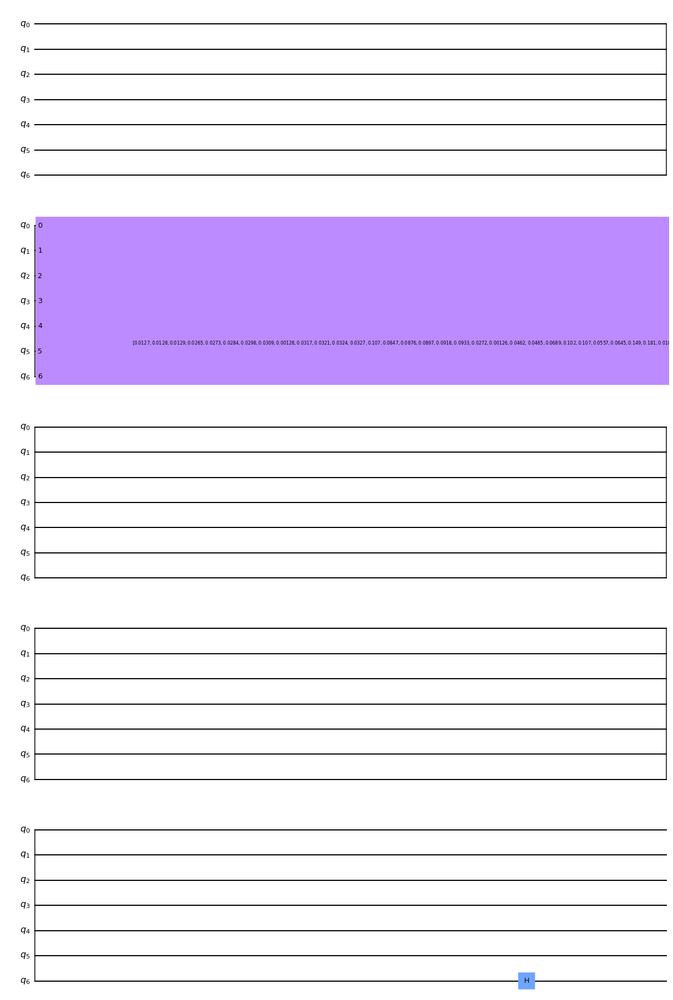

In [68]:
#x = np.arange(0,8,1)
#y = x
x = np.array(cumulative_list)
y = np.array(cases_list)

N = len(x)
print(N)
nqubits = math.ceil(np.log2(N))
xnorm = np.linalg.norm(x)
ynorm = np.linalg.norm(y)

x = x/xnorm
y = y/ynorm

circ = QuantumCircuit(nqubits+1)
vec = np.concatenate((x,y))/np.sqrt(2)

circ.initialize(vec, range(nqubits+1))
circ.h(nqubits)

circ.draw()

In [50]:
#Calculates the inner product between two vectors

def inner_prod(vec1, vec2):
    #first check lengths are equal
    if len(vec1) != len(vec2):
        raise ValueError('Lengths of states are not equal')
        
    circ = QuantumCircuit(nqubits+1)
    vec = np.concatenate((vec1,vec2))/np.sqrt(2)
    
    circ.initialize(vec, range(nqubits+1))
    circ.h(nqubits)

    backend = Aer.get_backend('statevector_simulator')
    job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})

    result = job.result()
    o = np.real(result.get_statevector(circ))

    m_sum = 0
    for l in range(N):
        m_sum += o[l]**2
        
    return 2*m_sum-1

x = np.arange(0,8,1)
y = x

N = len(x)
nqubits = math.ceil(np.log2(N))
xnorm = np.linalg.norm(x)
ynorm = np.linalg.norm(y)
x = x/xnorm
y = y/ynorm

print("x: ", x)
print()
print("y: ", y)
print()
print("The inner product of x and y equals: ", inner_prod(x,y))

x:  [0.         0.08451543 0.16903085 0.25354628 0.3380617  0.42257713
 0.50709255 0.59160798]

y:  [0.         0.08451543 0.16903085 0.25354628 0.3380617  0.42257713
 0.50709255 0.59160798]

The inner product of x and y equals:  0.9999999999999998


<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})


In [51]:
#Implements the entire cost function on the quantum circuit

def calculate_cost_function(parameters):

    a, b = parameters
    
    #phiphi = (xnorm/ynorm*a)**2.0 + 2.0*a*b*xnorm*np.sqrt(N)/ynorm**2*inner_prod(x,ones) + b**2*N/ynorm**2
    
    yphi = a*xnorm/ynorm*inner_prod(y,x) + b*np.sqrt(N)/ynorm*inner_prod(y,ones)
    
    #print("phiphi: ", phiphi)
    #print("yphi: ", yphi)

    #print(abs(1-float(yphi**2/phiphi)))
    #return (1-float(yphi**2/phiphi))**2
    
    return (1-yphi)**2

ones = np.ones(N)/np.sqrt(N)
a = 1.0
b = 1.0
print("Cost function for a =", a, "and b =", b, "equals:", calculate_cost_function([a,b]))

Cost function for a = 1.0 and b = 1.0 equals: 0.0399999999999999


<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})


<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})
<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})
<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job

COBYLA:       fun: 2.29086966540911e-09
   maxcv: 0.0
 message: 'Optimization terminated successfully.'
    nfev: 49
  status: 1
 success: True
       x: array([0.01817042, 0.54085878])
BFGS:        fun: 1.7660089993190827e-16
 hess_inv: array([[ 1.66603662e-04, -2.58506895e-04],
       [-2.58506895e-04,  1.00014834e+00]])
      jac: array([4.61912781e-05, 2.15543056e-10])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 110
      nit: 2
     njev: 33
   status: 2
  success: False
        x: array([0.01817732, 0.49992901])
Nelder-Mead:   final_simplex: (array([[0.01816735, 0.56758431],
       [0.01816735, 0.56758511],
       [0.01816735, 0.56758389]]), array([0.00000000e+00, 0.00000000e+00, 1.23259516e-32]))
           fun: 0.0
       message: 'Optimization terminated successfully.'
          nfev: 184
           nit: 100
        status: 0
       success: True
             x: array([0.01816735, 0.56758431])
CG:       fun: 1.7632857137897124e-14
    

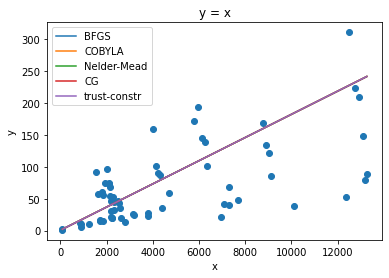

In [69]:
#first set up the data sets x and y

x = np.array(cumulative_list)
y = np.array(cases_list)
N = len(x)
nqubits = math.ceil(np.log2(N))

ones = np.ones(N)/np.sqrt(N)    #need a normalised ones' state for including the parameter b

xnorm = np.linalg.norm(x)       #normalise data sets
ynorm = np.linalg.norm(y)
x = x/xnorm
y = y/ynorm

#x0 = [random.uniform(0,2) for p in range(2)]    #random initial guess for a and b
x0 = [0.5,0.5]

#now use different classical optimisers to see which one works best

out = minimize(calculate_cost_function, x0=x0, method="BFGS", options={'maxiter':200}, tol=1e-6)
out1 = minimize(calculate_cost_function, x0=x0, method="COBYLA", options={'maxiter':200}, tol=1e-6)
out2 = minimize(calculate_cost_function, x0=x0, method="Nelder-Mead", options={'maxiter':200}, tol=1e-6)
out3 = minimize(calculate_cost_function, x0=x0, method="CG", options={'maxiter':200}, tol=1e-6)
out4 = minimize(calculate_cost_function, x0=x0, method="trust-constr", options={'maxiter':200}, tol=1e-6)

out_a1 = out1['x'][0]
out_b1 = out1['x'][1]

print("COBYLA: ", out1)

out_a = out['x'][0]
out_b = out['x'][1]

print("BFGS: ", out)

out_a2 = out2['x'][0]
out_b2 = out2['x'][1]

print("Nelder-Mead: ", out2)

out_a3 = out3['x'][0]
out_b3 = out3['x'][1]

print("CG: ", out3)

out_a4 = out4['x'][0]
out_b4 = out4['x'][1]

print("trust-constr: ", out4)

plt.scatter(x*xnorm,y*ynorm)
xfit = np.linspace(min(x)*xnorm, max(x)*xnorm, 100)
#plt.plot(xfit, preout['x'][0]*xfit+preout['x'][1], label='Basinhopping')
plt.plot(xfit, out_a*xfit+out_b, label='BFGS')
plt.plot(xfit, out_a1*xfit+out_b1, label='COBYLA')
plt.plot(xfit, out_a2*xfit+out_b2, label='Nelder-Mead')
plt.plot(xfit, out_a3*xfit+out_b3, label='CG')
plt.plot(xfit, out_a4*xfit+out_b4, label='trust-constr')
plt.legend()
plt.title("y = x")
plt.xlabel("x")
plt.ylabel("y")
plt.show()

In [56]:
#new cost function calculation, allowing for higher order polynomials
#note that we are now normalising each power of x in this function
def calculate_cost_function_n(parameters):

    yphi = parameters[0]*np.sqrt(N)/ynorm*inner_prod(y,ones)

    for i in range(1,len(parameters)):

        xpow = x**i
        xnormpow = np.linalg.norm(xpow)
        xpow = xpow/xnormpow
        
        yphi += parameters[i]*xnormpow/ynorm*inner_prod(y,xpow)
    
    #print((1-yphi)**2)
    return (1-yphi)**2

<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})
<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job = execute(circ, backend, backend_options = {"zero_threshold": 1e-20})
<ipython-input-50-acf471cf0c20>:15: DeprecationWarning: Using `backend_options` kwarg has been deprecated as of qiskit-aer 0.7.0 and will be removed no earlier than 3 months from that release date. Runtime backend options should now be added directly using kwargs for each option.
  job

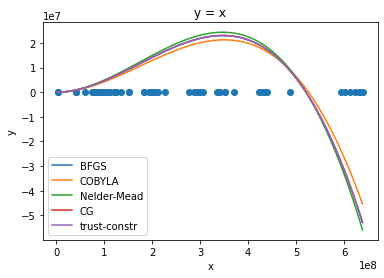

In [70]:
#first set up the data sets x and y

x = np.array(cumulative_list)
y = np.array(cases_list)
N = len(x)
nqubits = math.ceil(np.log2(N))

ones = np.ones(N)/np.sqrt(N)    #need a normalised ones' state for including the parameter b
       
ynorm = np.linalg.norm(y)       #normalise y data set
y = y/ynorm

order = 3

x0 = [random.uniform(0,2) for p in range(order+1)]    #random initial guess for a and b
#x0 = [1,1]

#now use different classical optimisers to see which one works best

out = minimize(calculate_cost_function_n, x0=x0, method="BFGS", options={'maxiter':200}, tol=1e-6)
out1 = minimize(calculate_cost_function_n, x0=x0, method="COBYLA", options={'maxiter':200}, tol=1e-6)
out2 = minimize(calculate_cost_function_n, x0=x0, method="Nelder-Mead", options={'maxiter':200}, tol=1e-6)
out3 = minimize(calculate_cost_function_n, x0=x0, method="CG", options={'maxiter':200}, tol=1e-6)
out4 = minimize(calculate_cost_function_n, x0=x0, method="trust-constr", options={'maxiter':200}, tol=1e-6)

class_fit = np.polyfit(x,y*ynorm,order)
class_fit = class_fit[::-1]

xfit = np.linspace(min(x), max(x), 100)

def return_fits(xfit):
    c_fit = np.zeros(100)
    q_fit = np.zeros(100)
    q_fit1 = np.zeros(100)
    q_fit2 = np.zeros(100)
    q_fit3 = np.zeros(100)
    q_fit4 = np.zeros(100)
    for i in range(order+1):
        c_fit += xfit**i*class_fit[i]
        q_fit += xfit**i*out['x'][i]
        q_fit1 += xfit**i*out1['x'][i]
        q_fit2 += xfit**i*out2['x'][i]
        q_fit3 += xfit**i*out3['x'][i]
        q_fit4 += xfit**i*out4['x'][i]
        

    return c_fit, q_fit, q_fit1, q_fit2, q_fit3, q_fit4

c_fit, q_fit, q_fit1, q_fit2, q_fit3, q_fit4 = return_fits(xfit)

plt.scatter(x*xnorm,y*ynorm)
xfit = np.linspace(min(x)*xnorm, max(x)*xnorm, 100)
plt.plot(xfit, q_fit, label='BFGS')
plt.plot(xfit, q_fit1, label='COBYLA')
plt.plot(xfit, q_fit2, label='Nelder-Mead')
plt.plot(xfit, q_fit3, label='CG')
plt.plot(xfit, q_fit4, label='trust-constr')
plt.legend()
plt.title("y = x")
plt.xlabel("x")
plt.ylabel("y")
plt.show()